<img src="../../images/wt4.png" align="right" width="70"/>

  #     Notebook for early bearing fault detection for WT04



## Table of contents
1. Load Raw filtered signal
2. Extract Optimal Bandwidth Based on SK
3. Read Kurtogram Plots
4. Filter Signal with Optimal Bandpass Based on SK
5. Frequency study: obtain different envelope order spectrums for different narrow-bands

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:80% !important; }</style>"))

In [2]:
%load_ext autoreload

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sys, os,os.path
from scipy.stats import kurtosis, skew

ROOT_PATH = os.path.abspath("..").split("data_processing")[0]
module_paths = []
module_paths.append(os.path.abspath(os.path.join(ROOT_PATH+"/data_processing/")))
module_paths.append(os.path.abspath(os.path.join(ROOT_PATH+"/hybrid_analysis_process_functions/")))
module_paths.append(os.path.abspath(os.path.join(ROOT_PATH+"/utils/")))
for module_path in module_paths:
    if module_path not in sys.path:
        print("appended")
        sys.path.append(module_path)
%autoreload
import functions as f
import wt_data, ff_transform, explore_fft_time_data, envelope, build_dataset, load_raw_signals, envelope, envelope_emd,plotting_methods
import resample_signals, filter_signals, plotting_methods,filters,correlation_coeff


appended
appended
appended
ROOT /Users/mortenolsenosvik/Documents/NTNU/Master/master-thesis/src
/Users/mortenolsenosvik/Documents/NTNU/Master/master-thesis/src
ROOT /Users/mortenolsenosvik/Documents/NTNU/Master/master-thesis/src
ROOT /Users/mortenolsenosvik/Documents/NTNU/Master/master-thesis/src
ROOT /Users/mortenolsenosvik/Documents/NTNU/Master/master-thesis/src


## 1. Load Raw Filtered signal 

In [5]:
turbine = 'wt04'
vib_signals, times, op_data_intervals, peak_array = load_raw_signals.load_raw('gearbox',turbine)
avg_rpm = np.asarray(op_data_intervals['AvgSpeed'])
avg_power = np.asarray(op_data_intervals['AvgPower'])

wt_date_path = f'/Volumes/OsvikExtra/signal_data/raw_data/gearbox/{turbine}/'
dates = pd.read_csv(f'{wt_date_path}interval_dates_{turbine}.csv')
dates = dates.drop(columns=['Unnamed: 0'])


File exist


In [6]:
# Reading filtered from disk
wt_folder_path = f'/Volumes/OsvikExtra/signal_data/raw_filtered_6000Hz/gearbox/{turbine}/'
filtered_path = f'{wt_folder_path}filtered/'

num_csvs = len([f for f in os.listdir(filtered_path) 
     if f.endswith('.csv') and os.path.isfile(os.path.join(filtered_path, f)) and f[0]=='f'])

filtered_signals = []
filtered_freqs = []
columns = []
for i in range(num_csvs):
    acc=pd.read_csv(filtered_path+'filtered_raw_6000_'+str(i)+'.csv')
    columns.append('filtered_' + str(i))
    filtered_signals.append(acc.values.T[0])
    filtered_freqs.append(acc.shape[0] / times[i][-1])
    print(f'Reading {i+1} / {num_csvs} files', end='\r')

## 2. Extract Optimal Bandwidth Based on SK

In [7]:
# Finding the optimal bandwidth by taking the mean from the SK
fc_and_bw_path = f'{wt_folder_path}center_frequencies_&_bandwidth/fc_and_bw_data.csv'
# Finding the optimal bandwidth by taking the mean from the SK
fc_and_bw_data = pd.read_csv(fc_and_bw_path)
fc_and_bw_data

,File,Frequencies,Bandwidths
0,filtered_raw_6000_0.csv,9600.036621,6400.024414
1,filtered_raw_6000_1.csv,5975.022793,50.000191
2,filtered_raw_6000_10.csv,9600.036621,6400.024414
3,filtered_raw_6000_100.csv,9600.036621,6400.024414
4,filtered_raw_6000_101.csv,9600.036621,6400.024414
5,filtered_raw_6000_102.csv,8925.034046,50.000191
6,filtered_raw_6000_103.csv,8675.033093,50.000191
7,filtered_raw_6000_104.csv,5525.021076,50.000191
8,filtered_raw_6000_105.csv,9600.036621,6400.024414
9,filtered_raw_6000_106.csv,9600.036621,6400.024414


Before filter shape: (424, 9)
After filtering: (322, 9)


,Unnamed: 0,AvgPower,ActPower,WindSpeed,NacelleDirection,AvgSpeed,File,Frequencies,Bandwidths
0,0,487.811127,387.100006,5.700000,236.699997,1000.724591,0,9600.036621,6400.024414
1,1,2697.461426,2332.100098,9.100000,256.100006,1456.464986,1,5975.022793,50.000191
2,2,2606.151855,2843.500000,10.000000,240.199997,1468.503663,2,8925.034046,50.000191
3,3,2541.849854,2694.100098,10.500000,71.099998,1458.875183,3,6375.024319,50.000191
4,4,2853.304199,3293.399902,12.700000,269.399994,1460.635409,4,8925.034046,50.000191
5,5,400.637115,268.399994,4.500000,342.500000,837.114731,5,9600.036621,6400.024414
6,6,2752.077881,3040.300049,9.700000,143.899994,1490.140485,6,9600.036621,6400.024414
7,7,558.968140,-1000.000000,-10.000000,-500.000000,1485.840981,7,9275.035381,50.000191
8,8,3301.744629,3325.800049,14.700000,264.899994,1482.815723,8,4775.018215,50.000191
9,9,3034.307373,2961.899902,10.500000,301.600006,1486.301831,9,9600.036621,6400.024414


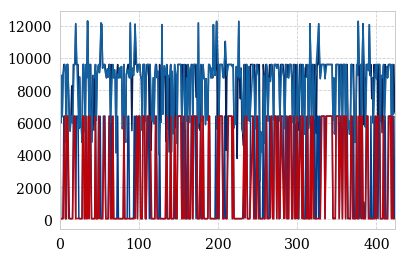

In [8]:
# Make the file column to an int
fc_and_bw_data['File']=fc_and_bw_data['File'].apply(lambda x: int((str(x).split('_'))[3].split('.csv')[0]))
# Sort the df based on this
fc_and_bw_data=fc_and_bw_data.sort_values('File',ascending=True)
fc_and_bw_data = fc_and_bw_data.reset_index(drop=True)

# How the frequencies and bandwidths vary across the intervals for wt:
fc_and_bw_data['Frequencies'].plot()
fc_and_bw_data['Bandwidths'].plot()

op_data_intervals
concated = pd.concat([op_data_intervals, fc_and_bw_data],axis=1)

print(f"Before filter shape: {concated.shape}")
filter_concated = concated.loc[(concated['AvgSpeed'] >= 1400)]
print(f"After filtering: {filter_concated.shape}")
mean_freq = filter_concated['Frequencies'].mean()
mean_bw = filter_concated['Bandwidths'].mean()
filter_concated['Frequencies'].plot()
filter_concated['Bandwidths'].plot()
concated

## 3. Read Kurtogram Plots

In [10]:
# Read kurtogram data
fc_and_bw_path = f'{wt_folder_path}center_frequencies_&_bandwidth/fc_and_bw_data.csv'
frequencies_path = f'{wt_folder_path}center_frequencies_&_bandwidth/frequencies.csv'
file_names_path = f'{wt_folder_path}center_frequencies_&_bandwidth/file_name.txt'

file_names = pd.read_csv(file_names_path, header=None)

frequencies = pd.read_csv(frequencies_path)
frequencies_numpy = np.asarray(frequencies).T
frequencies = pd.DataFrame(frequencies_numpy, columns= frequencies_numpy[0])
frequencies = frequencies.drop(frequencies.index[0]).reset_index(drop=True)

fc_and_bw = pd.read_csv(fc_and_bw_path)
fc_bw_numpy = fc_and_bw.values.T
fc_bw_pd = pd.DataFrame(fc_bw_numpy, columns=fc_bw_numpy[0])
fc_bw_pd = fc_bw_pd.drop(fc_bw_pd.index[0])
fc_bw_pd.insert(0, 'RowName', ['Center Frequency', 'BandWidth'])
fc_bw_pd=fc_bw_pd.set_index('RowName')
fc_bw_pd

,filtered_raw_6000_0.csv,filtered_raw_6000_1.csv,filtered_raw_6000_10.csv,filtered_raw_6000_100.csv,filtered_raw_6000_101.csv,filtered_raw_6000_102.csv,filtered_raw_6000_103.csv,filtered_raw_6000_104.csv,filtered_raw_6000_105.csv,filtered_raw_6000_106.csv,...,filtered_raw_6000_90.csv,filtered_raw_6000_91.csv,filtered_raw_6000_92.csv,filtered_raw_6000_93.csv,filtered_raw_6000_94.csv,filtered_raw_6000_95.csv,filtered_raw_6000_96.csv,filtered_raw_6000_97.csv,filtered_raw_6000_98.csv,filtered_raw_6000_99.csv
RowName,,,,,,,,,,,,,,,,,,,,,
Center Frequency,9600.04,5975.02,9600.04,9600.04,9600.04,8925.03,8675.03,5525.02,9600.04,9600.04,...,8775.03,5500.02,9375.04,8925.03,9600.04,12100,9600.04,9600.04,9125.03,9600.04
BandWidth,6400.02,50.0002,6400.02,6400.02,6400.02,50.0002,50.0002,50.0002,6400.02,6400.02,...,50.0002,66.6669,50.0002,50.0002,6400.02,66.6669,6400.02,6400.02,50.0002,6400.02


In [9]:
def flip_date(date):
    splitted_date = date.split('-')
    year  = splitted_date[0]
    month = splitted_date[1]
    day   = splitted_date[2].split(' ')[0]
    time  = splitted_date[2].split(' ')[1]
    new_date = day + '.' + month + '.' + year + ' ' + time
    return new_date

Avg Power: 2853.304199219      Avg RPM: 1460.6354085018384


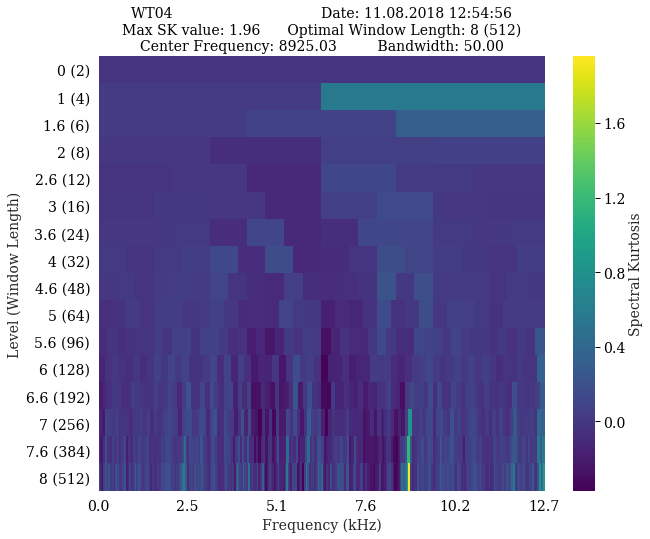

Avg Power: 3314.7731933590003      Avg RPM: 1464.0397710238035


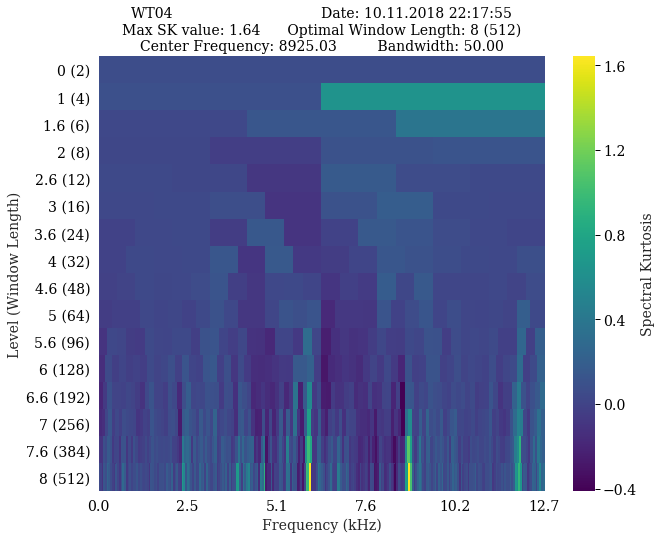

Avg Power: 3009.5998535159997      Avg RPM: 1505.8808543296348


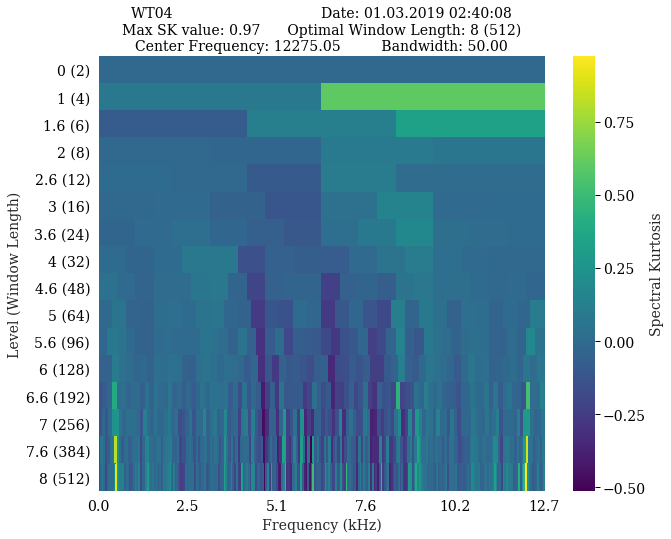

Avg Power: 2857.6220703129998      Avg RPM: 1492.6219322591958


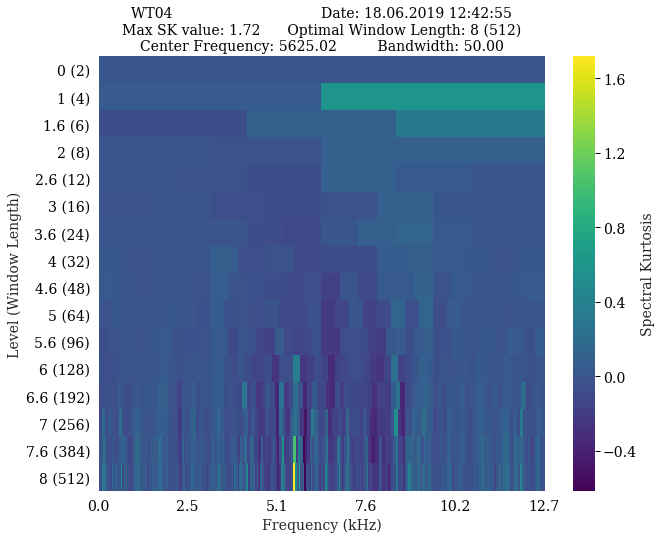

Avg Power: 3243.807861328      Avg RPM: 1510.6518128513555


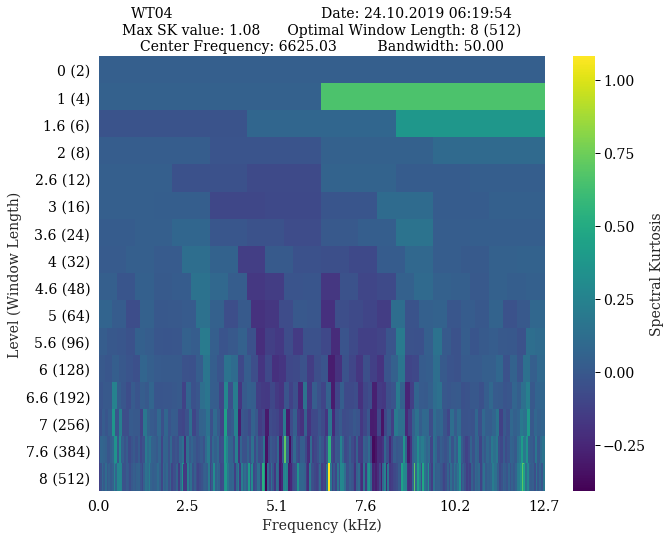

In [13]:
kurt_path = f'{wt_folder_path}kurtograms/';
#save_path = f'{wt_folder_path}kurt_plots/';
save_path = '../../plots/kurt_plots_right_interval/'
wt=turbine
num_csvs = len([f for f in os.listdir(kurt_path) 
     if f.endswith('.csv') and f[0]=='k' and os.path.isfile(os.path.join(kurt_path, f))])

interesting_intervals = [4, 102, 198, 306, 423]

#for i in range(num_csvs):
for i in interesting_intervals:
#    if i < 0:
 #       continue
    if False: #(i > 20 and i < 90) or (i > 110 and i < 290) or (i > 380 and i < 400) or (i > 400):
        continue
    filename = f'kgram_filtered_raw_6000_{i}.csv'
    if avg_power[i] > 2800:
        kurt_file = f'{kurt_path}{filename}'
        kurtogram = pd.read_csv(kurt_file, header=None)
        
        frequency_filename = '_'.join(filename.split('_')[1:])
        
        max_SK = np.max(np.max(kurtogram))
        center_frequency = fc_bw_pd[frequency_filename][0]
        bandwidth = fc_bw_pd[frequency_filename][1]
        highest_window = np.argmax(kurtogram.max(axis=1))
        dato = flip_date(dates.values[i][0])
        name = f'WT04                                 Date: {dato}'
        
        file_name = f'{save_path}kurt_{turbine}_{i}'

        print(f'Avg Power: {avg_power[i]}      Avg RPM: {avg_rpm[i]}')
        _ = plotting_methods.plot_kurtogram(kurtogram, 
                                        frequencies[frequency_filename], 
                                        file_name=frequency_filename,
                                        max_sk=max_SK,
                                        cf=center_frequency,
                                        bw=bandwidth,
                                        wt=wt,
                                        window=highest_window,
                                        title=name,
                                        save_path=file_name)

        print(f'Plot {i+1} / {num_csvs} created', end='\r')


## 4. Filter Signal with Average Optimal Bandpass Based on SK

In [14]:
# Perform bandpass filtering on the raw signal!
def filter_based_on_optimal_bw(low,high,signal,time,plot=False):
    #use_signal = sig
    #signal = use_signal
    fs, _, _, _ =  envelope.get_sampling_freq(signal, time)
    
    #### Hardcoding the filters
    y = filters.butter_bandpass_filter(signal,low,high,fs)
    if plot:
        plt.plot(signal)
        plt.margins(0)
        plt.xlabel("Samples")
        plt.ylabel("Amplitude")
        plt.show()
        plt.title('Resampled signal with highpass filtering')
        plt.plot(y)
        plt.xlabel("Samples")
        plt.margins(0)
        plt.ylabel("Amplitude")
        plt.title(f'Interval {i} from {turbine} filtered with average optimal bandpass from SK \n Component: Gearbox')
    return y

# Just loop through
optimal_bandpass_signals = []
signal_size = len(filtered_signals)
for i in range(len(filtered_signals)):
    use_signal = filtered_signals[i][0:(len(filtered_signals[i])//2)]
    time = times[i][0:(len(filtered_signals[i])//2)]
    low = mean_freq - mean_bw/4
    high = mean_freq + mean_bw/4
    y = filter_based_on_optimal_bw(low,high,use_signal, time)
    optimal_bandpass_signals.append(y)
    #plotting_methods.plot_fft(time, use_signal, interval_num=i)
    print(f'Filtering {i+1} / {signal_size} signals', end='\r')
#del filtered_signals

## 5. Frequency study (fault characteristics), fault development

### Exploring Envelope Order Spectrums of Different Frequency Ranges
Using 80% of nominal power: only comparing intervals with average power > 2400

### 5.1 Filter Signal with Individual Optimal Bandpass Based on SK

In [10]:
def normalise_fft(fft):
    N = fft.shape[0]
    y = np.abs(fft)[:N // 2] * 1 / N  # Normalized
    return y

In [11]:
fs = 25600

In [15]:
# Just loop through
optimal_bandpass_individual = []
signal_size = len(vib_signals)
for i in range(len(vib_signals)):
    use_signal = vib_signals[i]
    time = times[i]
    cf = float(concated['Frequencies'][i])
    bw = float(concated['Bandwidths'][i])
    low = cf - bw
    high = cf + bw
    #if bw < 100:
    #    low = cf - bw*3
    #    high = cf + bw*3
    if high > 0.5*fs:
        high = 0.5*fs -100
    
    y = filter_based_on_optimal_bw(low,high,use_signal, time)
    optimal_bandpass_individual.append(y)
    #plotting_methods.plot_fft(time, use_signal, interval_num=i)
    print(f'Filtering {i+1} / {signal_size} signals', end='\r')

In [16]:
interesting_intervals = [4, 102, 198, 306, 423]
all_fft_res  = []
all_freq_res = []
all_fft      = []
all_freq     = []

#for i, signal in enumerate(optimal_bandpass_individual):
for i in interesting_intervals:
    bw = float(concated['Bandwidths'][i])
    if avg_power[i] < 2400:
        continue
    if True: #bw < 1000 and i<50:# or (i>50 and i<60) or (i > 190 and i < 200)):
        # Plot SK filtered signal
        #plotting_methods.plot_signal(times[i][1:], optimal_bandpass_individual[i],name='SK Filtered', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        fft, freq = plotting_methods.plot_fft(times[i][1:], optimal_bandpass_individual[i], name='SK Filtered', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        all_fft.append(normalise_fft(fft))
        all_freq.append(freq)
        #Calcutale envelope
        
        highut_lp = 1000
        rectified = abs(optimal_bandpass_individual[i])**2
        bandpass_filtered_rect_lp = filters.butter_lp_filter(rectified, highut_lp, fs, order=5)
        
        #Plot envelope signal
        one_order = avg_rpm[i]/60
        freq=[one_order]
        #plotting_methods.plot_fft(times[i][1:], bandpass_filtered_rect_lp, x_max=100,frequency_lines=freq,name='SK Filtered Envelope', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        
        #Calculate Envelope Order
        try:
            x_round, resampled_envelope, x_time = resample_signals.do_cubic_resampling(times[i][1:], bandpass_filtered_rect_lp, peak_array[i], number_of_resample_points=2000)
            fft_res, freq_res = plotting_methods.plot_fft(x_round, resampled_envelope, x_max=15,frequency_lines=[], name='SK Filtered Envelope Order', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
            all_fft_res.append(normalise_fft(fft_res))
            all_freq_res.append(freq_res)
        except:
            print('---------------------------------------\n\n')
            print(f'              INTERVAL {i}')
            print('ENVELOPE ORDER COULD NOT BE CALCULATED!\n\n')
            print('---------------------------------------')
        print(f'Kurtosis of {i} {kurtosis(optimal_bandpass_individual[i]):.3f}')
        print(f'Center Frequency: {concated["Frequencies"][i]:.3f}')
        print(f'Bandwidth from SK: {concated["Bandwidths"][i]:.3f}')
        print(f'Used Bandwidth: {concated["Bandwidths"][i]*8:.3f}')
        print(f'Used Bandwidth in orders: {concated["Bandwidths"][i]*6*60/avg_rpm[i]:.3f}')

Kurtosis of 4 2.534
Center Frequency: 8925.034
Bandwidth from SK: 50.000
Used Bandwidth: 400.002
Used Bandwidth in orders: 12.323
Kurtosis of 102 1.854
Center Frequency: 8925.034
Bandwidth from SK: 50.000
Used Bandwidth: 400.002
Used Bandwidth in orders: 12.295
Kurtosis of 198 1.275
Center Frequency: 12275.047
Bandwidth from SK: 50.000
Used Bandwidth: 400.002
Used Bandwidth in orders: 11.953
Kurtosis of 306 1.588
Center Frequency: 5625.021
Bandwidth from SK: 50.000
Used Bandwidth: 400.002
Used Bandwidth in orders: 12.059
Kurtosis of 423 1.062
Center Frequency: 6625.025
Bandwidth from SK: 50.000
Used Bandwidth: 400.002
Used Bandwidth in orders: 11.915


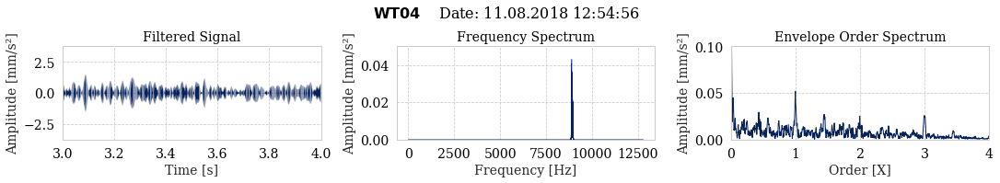

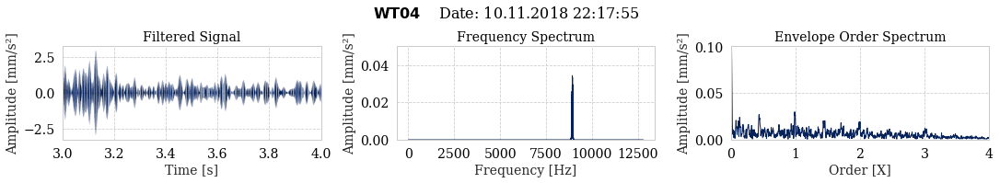

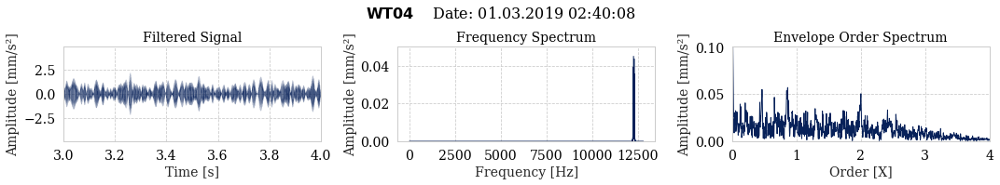

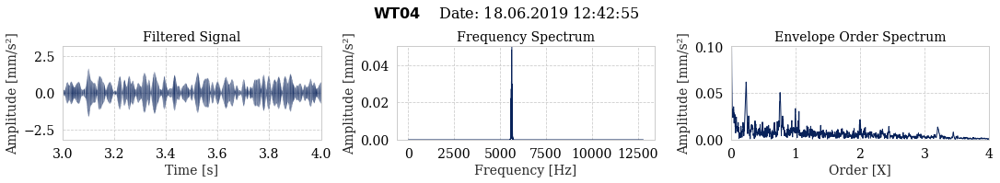

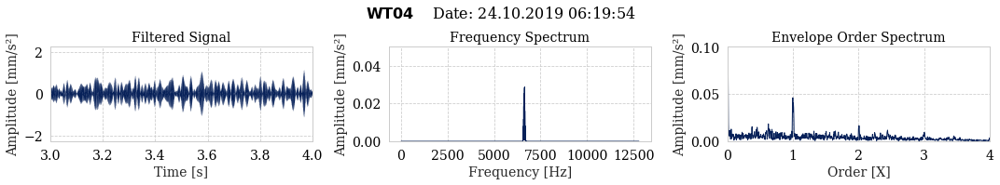

In [17]:
rows = 1
cols = 3
save_path = '../../plots/envelope_order_sk/'

for i, interval in enumerate(interesting_intervals):
    fig, ax = plt.subplots(rows, cols,figsize=(15,2.5))
    dato = flip_date(dates.values[interval][0])
    my_suptitle = fig.suptitle(r"$\bf{WT04}$" + f'    Date: {dato}',fontsize=16, y=1.09)
    
    ax[0].plot(times[interval][0:], optimal_bandpass_individual[interval], linewidth=0.05)
    ax[0].set_title(f"Filtered Signal")
    ax[0].set_ylabel("Amplitude [mm/s\u00b2]")
    ax[0].set_xlabel("Time [s]")
    ax[0].set_xlim(3, 4)

    ax[1].plot(all_freq[i], all_fft[i], linewidth=0.5)
    ax[1].set_title(f"Frequency Spectrum")
    ax[1].set_ylabel("Amplitude [mm/s\u00b2]")
    ax[1].set_xlabel("Frequency [Hz]")
    ax[1].set_ylim(0, 0.05)

    ax[2].plot(all_freq_res[i], all_fft_res[i], linewidth=1)
    ax[2].set_title(f"Envelope Order Spectrum")
    ax[2].set_ylabel("Amplitude [mm/s\u00b2]")
    ax[2].set_xlabel("Order [X]")
    ax[2].set_xlim(0, 4)
    ax[2].set_ylim(0, 0.1)

    plt.tight_layout()
    plt.margins(0)
    plt.savefig(f'{save_path}wt04_{interval}.png', dpi=300, bbox_extra_artists=[my_suptitle], bbox_inches='tight')
    plt.show()

### 5.2 Highpass Filter with Lowcut 2500Hz

In [11]:
# Just loop through
bandpassed_2K = []
signal_size = len(vib_signals)
for i in range(len(vib_signals)):
    use_signal = vib_signals[i]
    time = times[i]
    
    low = 2500
    high = 12700

    y = filter_based_on_optimal_bw(low,high,use_signal, time)
    bandpassed_2K.append(y)
    print(f'Filtering {i+1} / {signal_size} signals', end='\r')

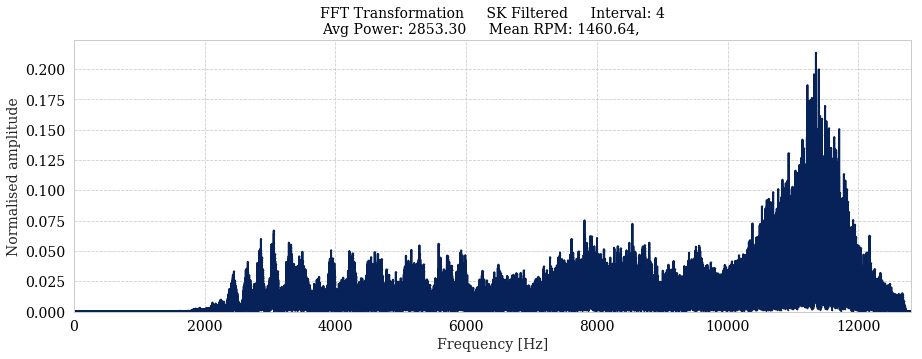

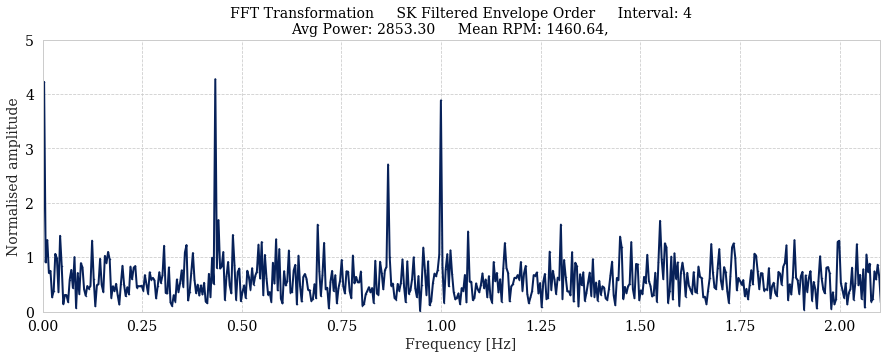

Kurtosis of 4 -0.020
Center Frequency: 2500.000
Used Bandwidth in orders: 16.431


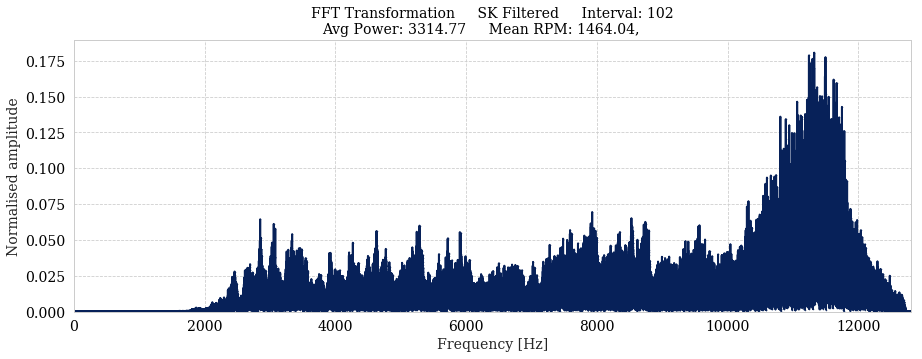

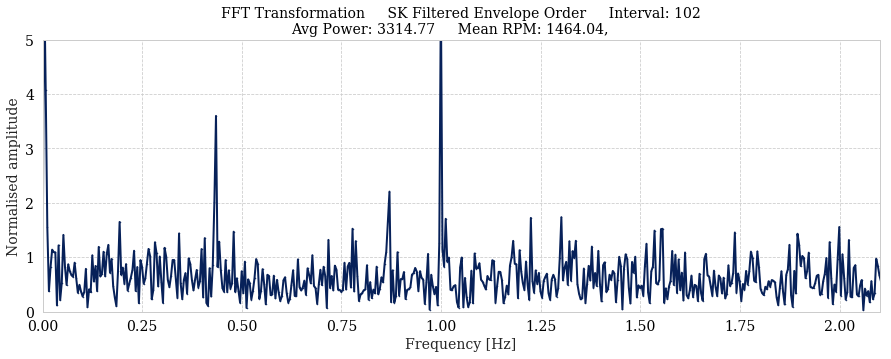

Kurtosis of 102 0.047
Center Frequency: 2500.000
Used Bandwidth in orders: 16.393


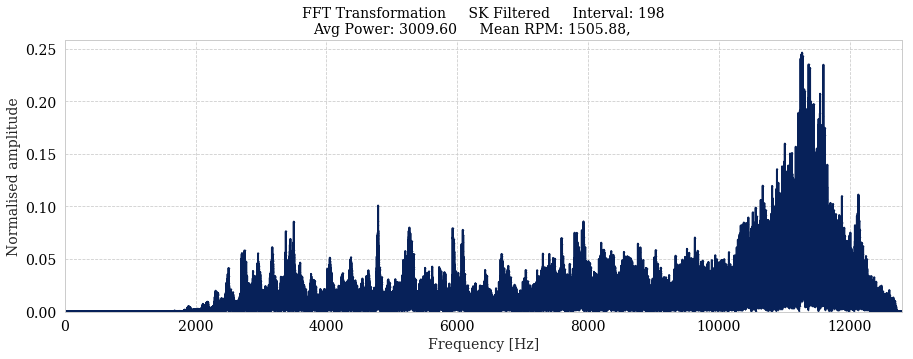

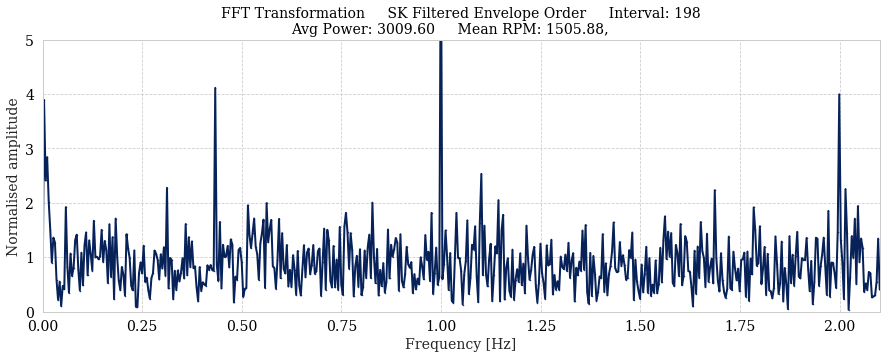

Kurtosis of 198 -0.015
Center Frequency: 2500.000
Used Bandwidth in orders: 15.938


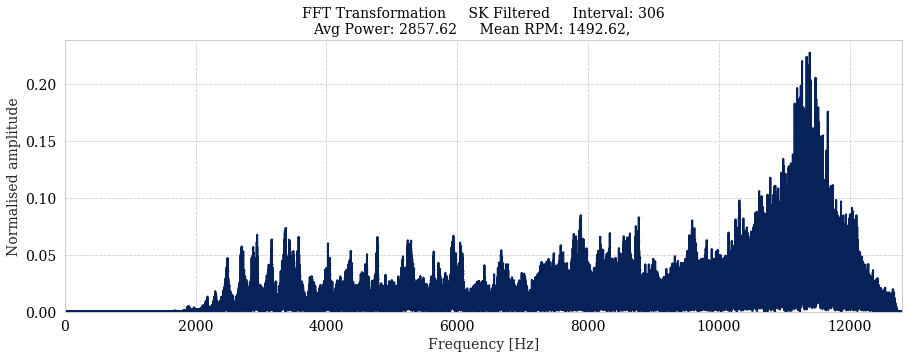

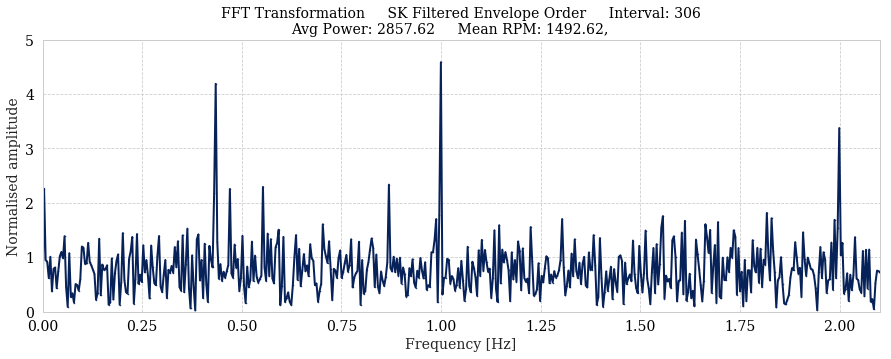

Kurtosis of 306 -0.002
Center Frequency: 2500.000
Used Bandwidth in orders: 16.079


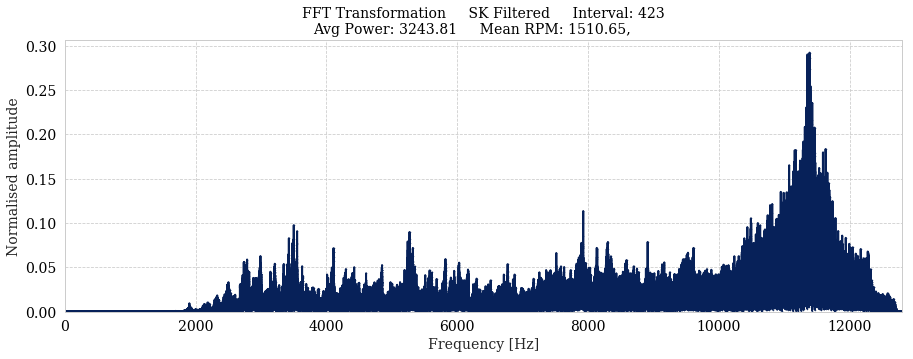

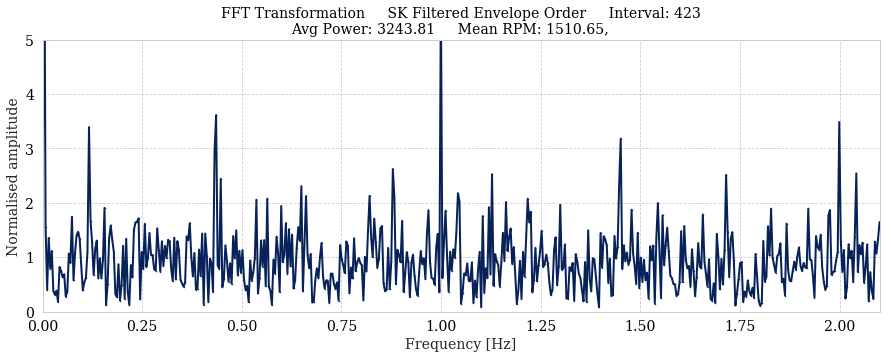

Kurtosis of 423 0.027
Center Frequency: 2500.000
Used Bandwidth in orders: 15.887


In [16]:
interesting_intervals = [4, 102, 198, 306, 423]
bandpassed_signal = bandpassed_2K
cf =2500
ffts = []
fft_times = []

#for i, signal in enumerate(bandpassed_signal):
for i in interesting_intervals:
    if avg_power[i] < 2400:
        continue
    bw = float(concated['Bandwidths'][i])
    if i == 50:
        print('------------------------------------------------\n\n')
        print('               FIRST 50 FINISHED')
        print('\n\n------------------------------------------------')
    if True: #i< 50 or i>370: #bw < 1000 and i<50:# or (i>50 and i<60) or (i > 190 and i < 200)):
        # Plot SK filtered signal
        #plotting_methods.plot_signal(times[i][1:], bandpassed_signal[i],name='SK Filtered', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        plotting_methods.plot_fft(times[i][1:], bandpassed_signal[i], name='SK Filtered', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        
        #Calcutale envelope
        highut_lp = 1000
        rectified = abs(bandpassed_signal[i])**2
        bandpass_filtered_rect_lp = filters.butter_lp_filter(rectified, highut_lp, fs, order=5)
        
        #Plot envelope signal
        one_order = avg_rpm[i]/60
        freq=[one_order]
        #plotting_methods.plot_fft(times[i][1:], bandpass_filtered_rect_lp, x_max=100,frequency_lines=freq,name='SK Filtered Envelope', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        
        #Calculate Envelope Order
        try:
            x_round, resampled_envelope, x_time = resample_signals.do_cubic_resampling(times[i][1:], bandpass_filtered_rect_lp, peak_array[i], number_of_resample_points=2000)
            fft, fft_time = plotting_methods.plot_fft(x_round, resampled_envelope, x_min=0, x_max=2.1, y_max=5,frequency_lines=[], name='SK Filtered Envelope Order', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
            ffts.append(normalise_fft(fft))
            fft_times.append(fft_time)
        except: #If resampling fails for some reason
            print('---------------------------------------\n\n')
            print(f'              INTERVAL {i}')
            print('ENVELOPE ORDER COULD NOT BE CALCULATED!\n\n')
            print('---------------------------------------')
        
        # Print key values
        print(f'Kurtosis of {i} {kurtosis(bandpassed_signal[i]):.3f}')
        print(f'Center Frequency: {cf:.3f}')
        print(f'Used Bandwidth in orders: {400*60/avg_rpm[i]:.3f}')


In [13]:
path = wt_folder_path + 'high_pass_2500_.npz'
np.savez(path, fft=ffts, freq=fft_times, intervals=interesting_intervals, dates=dates)


### 5.3 Filter on Center Frequency 6400 Hz and Bandwidth 400 Hz 

In [23]:
# Just loop through
bandpassed_6K = []
signal_size = len(vib_signals)
for i in range(len(vib_signals)):
    use_signal = vib_signals[i]
    time = times[i]
    
    cf = 6600
    bw = 200
    low = cf - bw
    high = cf + bw

    if high > 0.5*fs:
        high = 0.5*fs -100    
    
    y = filter_based_on_optimal_bw(low,high,use_signal, time)
    bandpassed_6K.append(y)
    print(f'Filtering {i+1} / {signal_size} signals', end='\r')

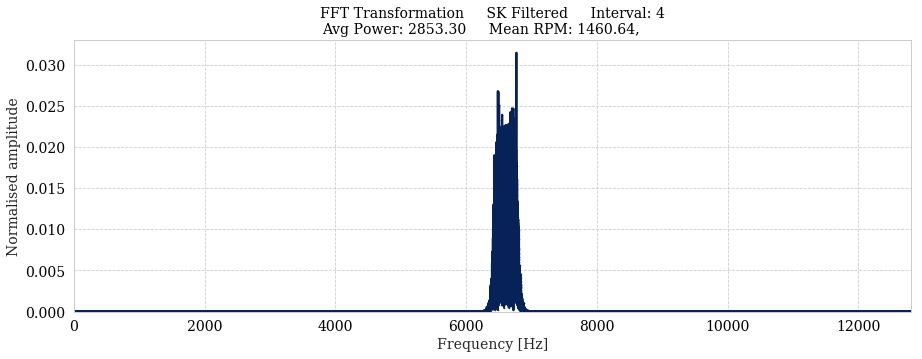

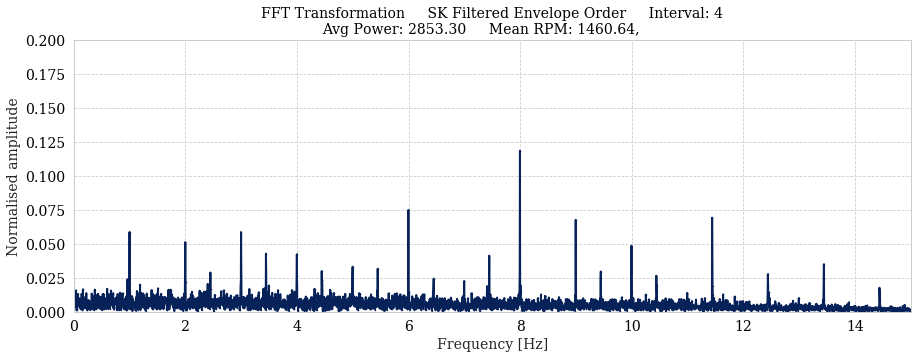

Kurtosis of 4 -0.352
Center Frequency: 6400.000
Used Bandwidth in orders: 16.431


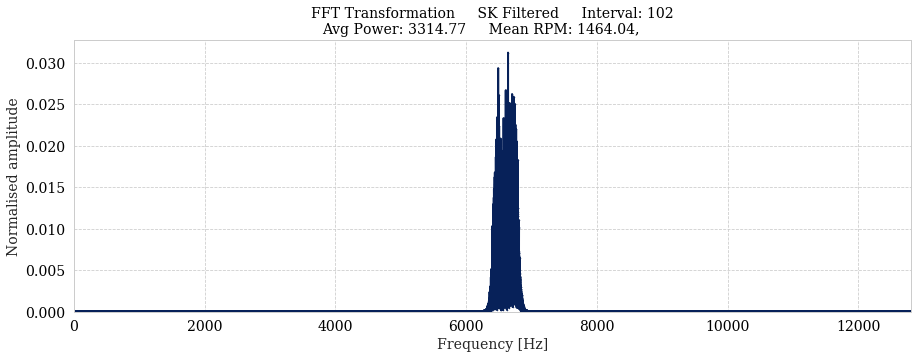

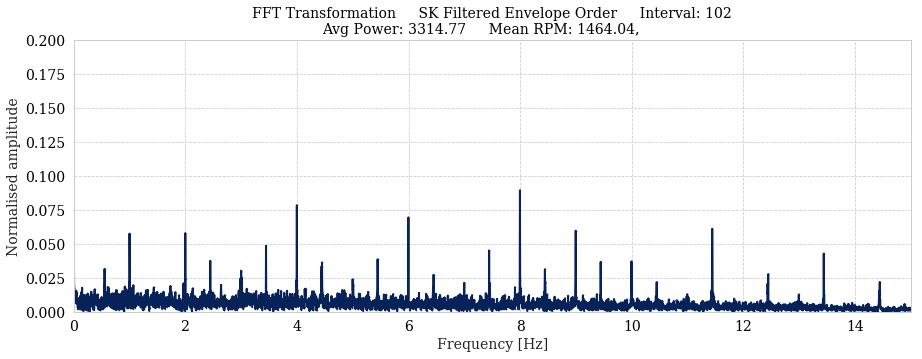

Kurtosis of 102 -0.301
Center Frequency: 6400.000
Used Bandwidth in orders: 16.393


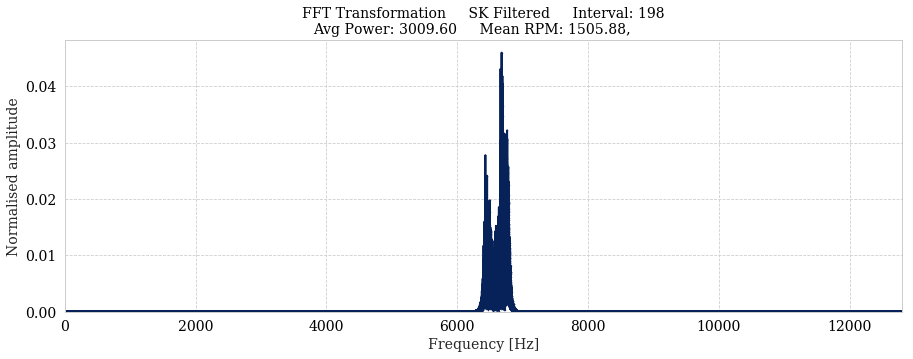

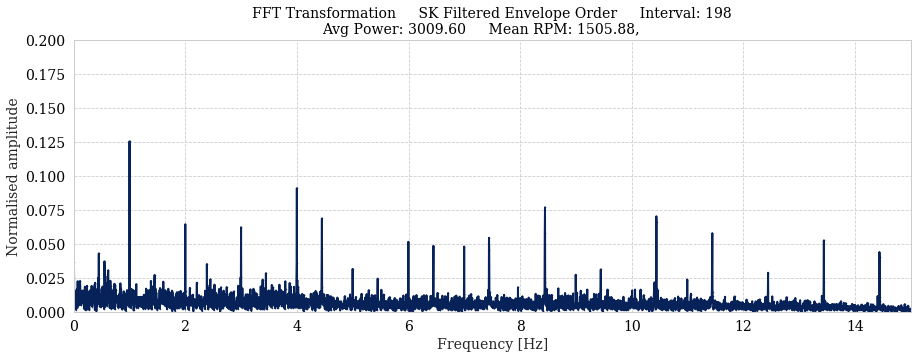

Kurtosis of 198 -0.392
Center Frequency: 6400.000
Used Bandwidth in orders: 15.938


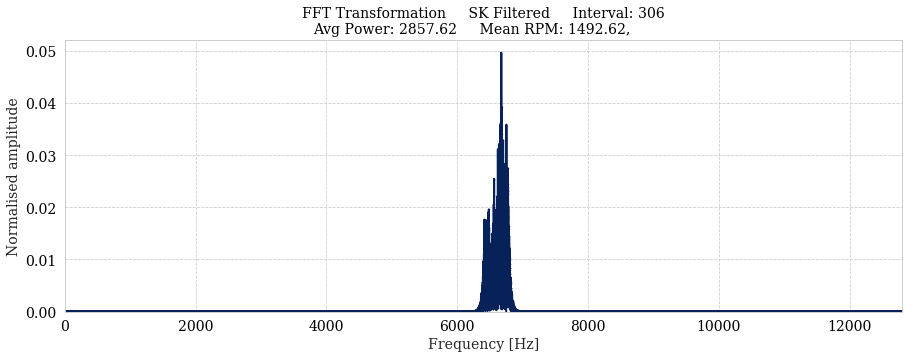

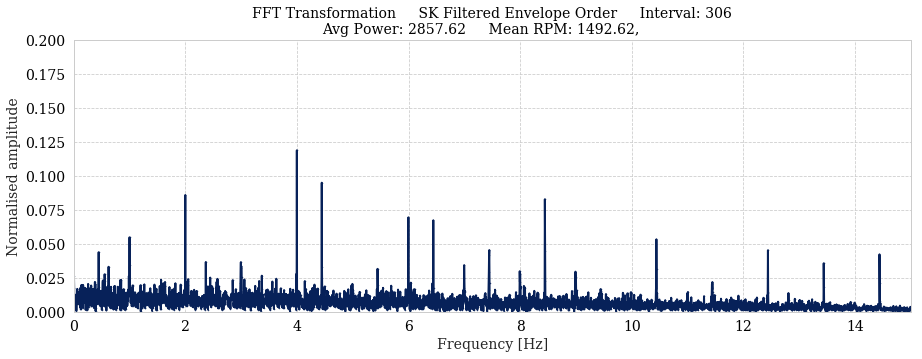

Kurtosis of 306 -0.385
Center Frequency: 6400.000
Used Bandwidth in orders: 16.079


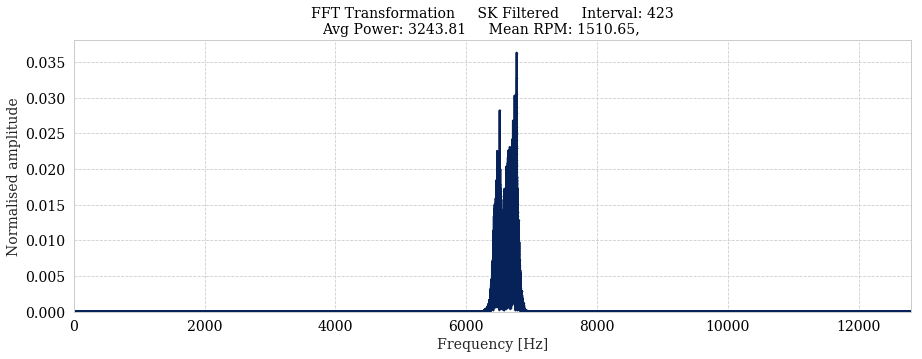

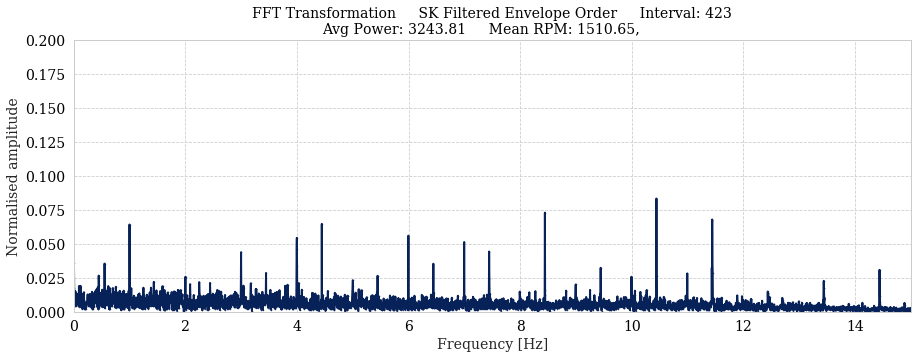

Kurtosis of 423 -0.322
Center Frequency: 6400.000
Used Bandwidth in orders: 15.887


In [24]:
interesting_intervals = [4, 102, 198, 306, 423]
bandpassed_signal = bandpassed_6K
cf = 6400
bw = 400

#for i, signal in enumerate(bandpassed_signal):
for i in interesting_intervals:
    bw = float(concated['Bandwidths'][i])
    if avg_power[i] < 2400:
        continue
    if i == 50:
        print('------------------------------------------------\n\n')
        print('               FIRST 50 FINISHED')
        print('\n\n------------------------------------------------')
    if True: #i< 50 or i>370: #bw < 1000 and i<50:# or (i>50 and i<60) or (i > 190 and i < 200)):
        # Plot SK filtered signal
        #plotting_methods.plot_signal(times[i][1:], bandpassed_signal[i],name='SK Filtered', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        plotting_methods.plot_fft(times[i][1:], bandpassed_signal[i], name='SK Filtered', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        
        #Calcutale envelope
        highut_lp = 1000
        rectified = abs(bandpassed_signal[i])**2
        bandpass_filtered_rect_lp = filters.butter_lp_filter(rectified, highut_lp, fs, order=5)
        
        #Plot envelope signal
        one_order = avg_rpm[i]/60
        freq=[one_order]
        #plotting_methods.plot_fft(times[i][1:], bandpass_filtered_rect_lp, x_max=100,frequency_lines=freq,name='SK Filtered Envelope', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        
        #Calculate Envelope Order
        try:
            x_round, resampled_envelope, x_time = resample_signals.do_cubic_resampling(times[i][1:], bandpass_filtered_rect_lp, peak_array[i], number_of_resample_points=2000)
            plotting_methods.plot_fft(x_round, resampled_envelope, x_max=15, y_max=0.2,frequency_lines=[], name='SK Filtered Envelope Order', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        except: #If resampling fails for some reason
            print('---------------------------------------\n\n')
            print(f'              INTERVAL {i}')
            print('ENVELOPE ORDER COULD NOT BE CALCULATED!\n\n')
            print('---------------------------------------')
        
        # Print key values
        print(f'Kurtosis of {i} {kurtosis(bandpassed_signal[i]):.3f}')
        print(f'Center Frequency: {cf:.3f}')
        print(f'Used Bandwidth in orders: {400*60/avg_rpm[i]:.3f}')


### 5.4 Filter on Center Frequency 7 kHz and Bandwidth 400 Hz

In [12]:
# Just loop through
bandpassed_7K = []
signal_size = len(vib_signals)
for i in range(len(vib_signals)):
    use_signal = vib_signals[i]
    time = times[i]
    
    cf = 6175
    bw = 50
    low = cf - bw
    high = cf + bw

    if high > 0.5*fs:
        high = 0.5*fs -100    
    
    y = filter_based_on_optimal_bw(low,high,use_signal, time)
    bandpassed_7K.append(y)
    print(f'Filtering {i+1} / {signal_size} signals', end='\r')

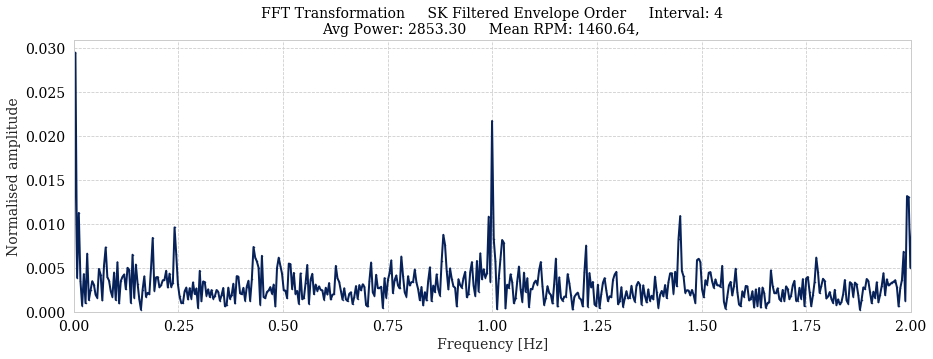

Kurtosis of 4 0.076
Center Frequency: 6175.000
Used Bandwidth in orders: 16.431


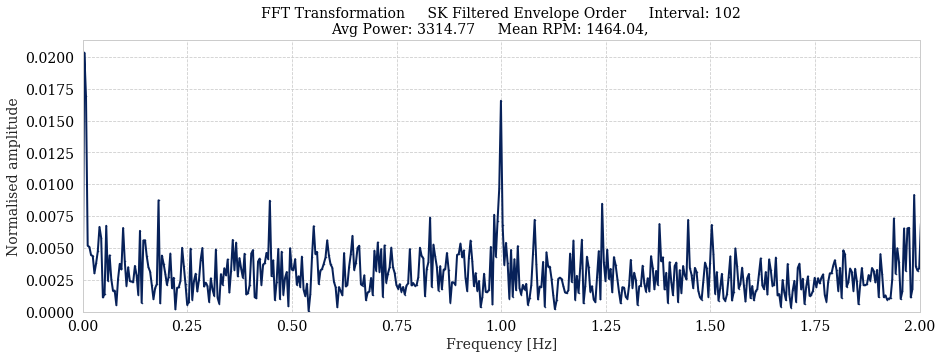

Kurtosis of 102 -0.162
Center Frequency: 6175.000
Used Bandwidth in orders: 16.393


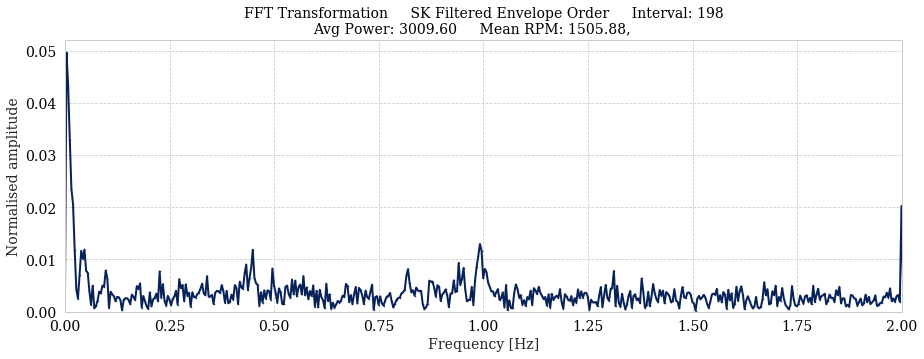

Kurtosis of 198 0.449
Center Frequency: 6175.000
Used Bandwidth in orders: 15.938


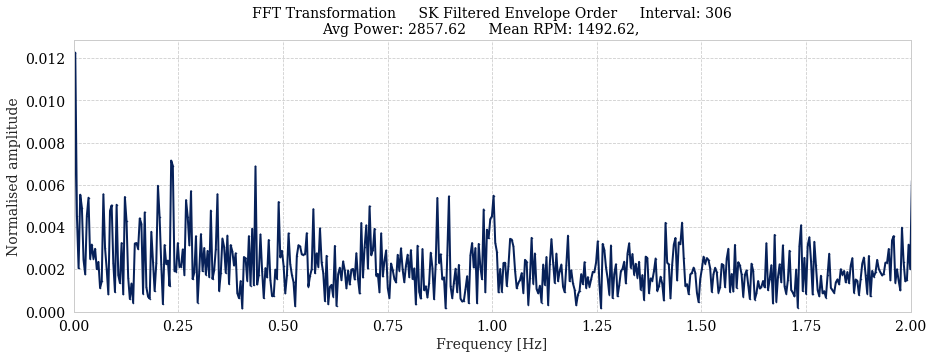

Kurtosis of 306 -0.083
Center Frequency: 6175.000
Used Bandwidth in orders: 16.079


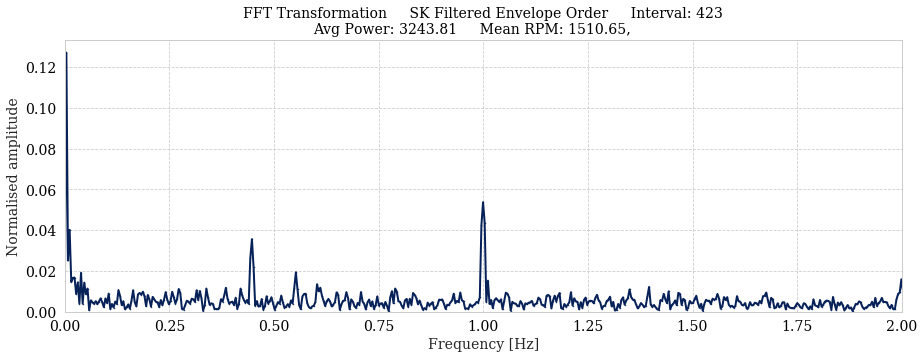

Kurtosis of 423 -0.146
Center Frequency: 6175.000
Used Bandwidth in orders: 15.887


In [13]:
interesting_intervals = [4, 102, 198, 306, 423]
bandpassed_signal = bandpassed_7K
ffts = []
fft_times = []

#for i, signal in enumerate(bandpassed_signal):
for i in interesting_intervals:
    if avg_power[i] < 2400:
        continue
    bw = float(concated['Bandwidths'][i])
    if i == 50:
        print('------------------------------------------------\n\n')
        print('               FIRST 50 FINISHED')
        print('\n\n------------------------------------------------')
    if True: #i< 50 or i>370: #bw < 1000 and i<50:# or (i>50 and i<60) or (i > 190 and i < 200)):
        # Plot SK filtered signal
        #plotting_methods.plot_signal(times[i][1:], bandpassed_signal[i],name='SK Filtered', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        #plotting_methods.plot_fft(times[i][1:], bandpassed_signal[i], name='SK Filtered', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        
        #Calcutale envelope
        highut_lp = 1000
        rectified = abs(bandpassed_signal[i])**2
        bandpass_filtered_rect_lp = filters.butter_lp_filter(rectified, highut_lp, fs, order=5)
        
        #Plot envelope signal
        one_order = avg_rpm[i]/60
        freq=[one_order]
        #plotting_methods.plot_fft(times[i][1:], bandpass_filtered_rect_lp, x_max=100,frequency_lines=freq,name='SK Filtered Envelope', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        
        #Calculate Envelope Order
        try:
            x_round, resampled_envelope, x_time = resample_signals.do_cubic_resampling(times[i][1:], bandpass_filtered_rect_lp, peak_array[i], number_of_resample_points=2000)
            fft, fft_time = plotting_methods.plot_fft(x_round, resampled_envelope, x_max=2, y_max=None,frequency_lines=[], name='SK Filtered Envelope Order', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
            ffts.append(normalise_fft(fft))
            fft_times.append(fft_time)
        except: #If resampling fails for some reason
            print('---------------------------------------\n\n')
            print(f'              INTERVAL {i}')
            print('ENVELOPE ORDER COULD NOT BE CALCULATED!\n\n')
            print('---------------------------------------')
        
        # Print key values
        print(f'Kurtosis of {i} {kurtosis(bandpassed_signal[i]):.3f}')
        print(f'Center Frequency: {cf:.3f}')
        print(f'Used Bandwidth in orders: {400*60/avg_rpm[i]:.3f}')


In [15]:
path = wt_folder_path + 'cf_6175_bw_50.npz'
np.savez(path, fft=ffts, freq=fft_times, intervals=interesting_intervals, dates=dates)


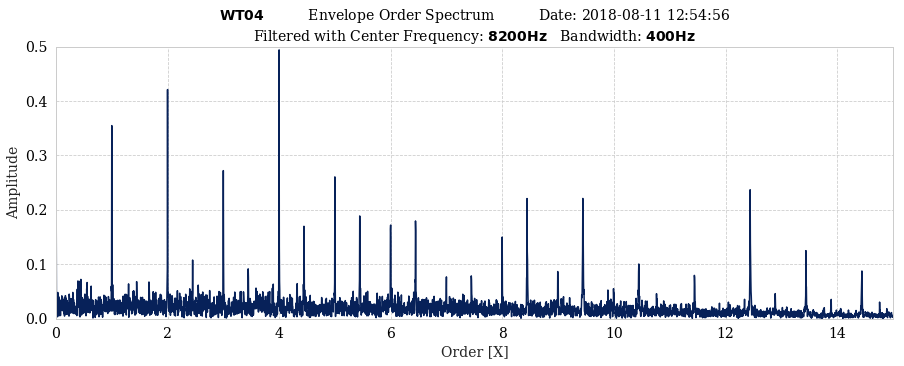

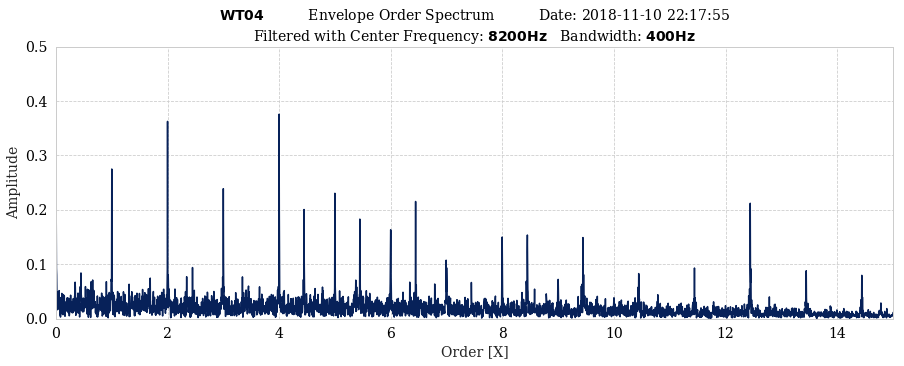

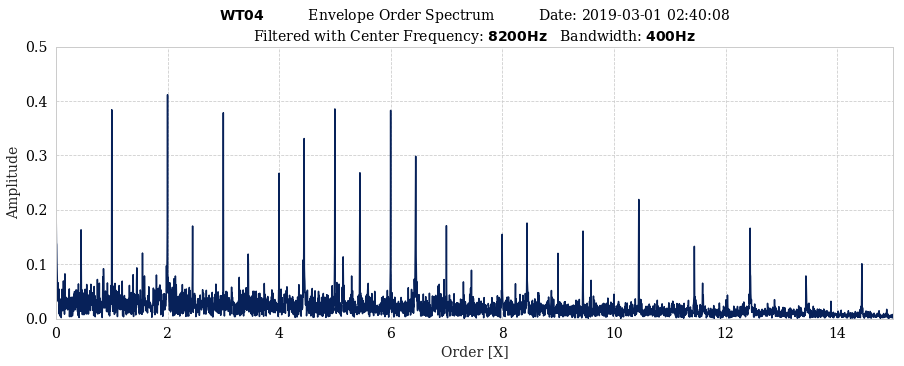

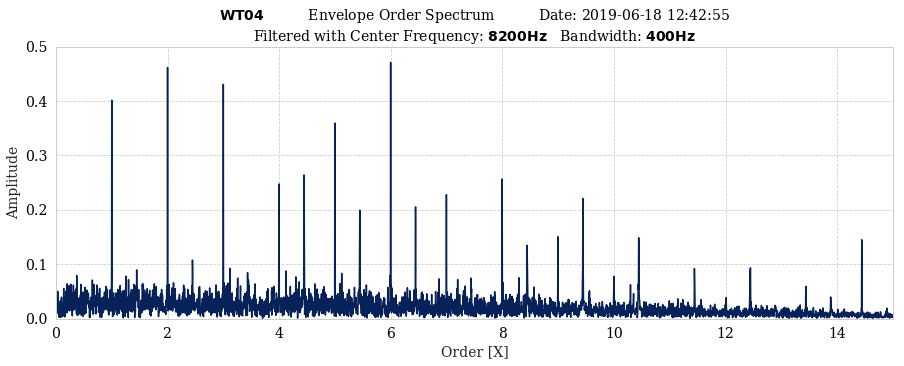

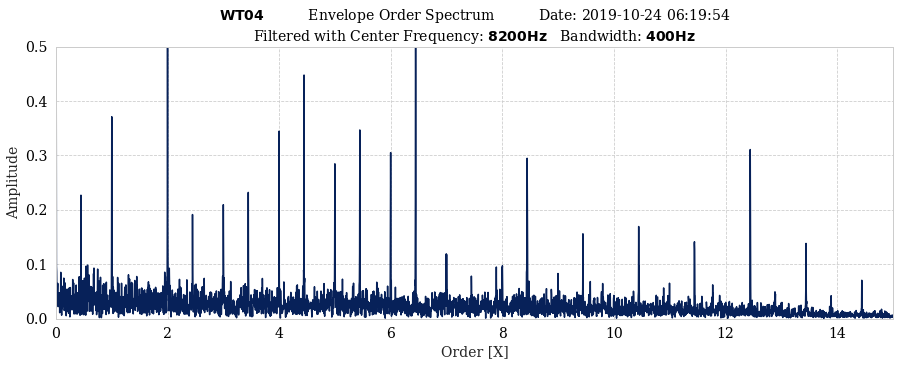

In [75]:
save_path = '../../plots/envelope_order_8200Hz/'
for i,interval in enumerate(interesting_intervals):
    plt.figure(figsize=(15,5))
    plt.plot(fft_times[i], ffts[i])
    plt.xlim(0, 15)
    plt.ylim(0,0.5)
    heading = r"$\bf{WT04}$" + f'          Envelope Order Spectrum          Date: {dates.values[interesting_intervals[i]][0]}'
    heading += f'\nFiltered with Center Frequency: ' + r"$\bf{8200Hz}$" + '   Bandwidth: ' + r"$\bf{400Hz}$"
    plt.title(heading)
    plt.ylabel('Amplitude')
    plt.xlabel('Order [X]')
    plt.margins(0)
    plt.savefig(f'{save_path}wt04_8200Hz_{interval}.png', dpi=300)
    plt.show()

### 5.5 Filter on Center Frequency 9 kHz and Bandwidth 400 Hz

In [26]:
# Just loop through
bandpassed_9K = []
signal_size = len(vib_signals)
for i in range(len(vib_signals)):
    use_signal = vib_signals[i]
    time = times[i]
    
    cf = 5600
    bw = 100
    low = cf - bw
    high = cf + bw

    if high > 0.5*fs:
        high = 0.5*fs -100    
    
    y = filter_based_on_optimal_bw(low,high,use_signal, time)
    bandpassed_9K.append(y)
    print(f'Filtering {i+1} / {signal_size} signals', end='\r')

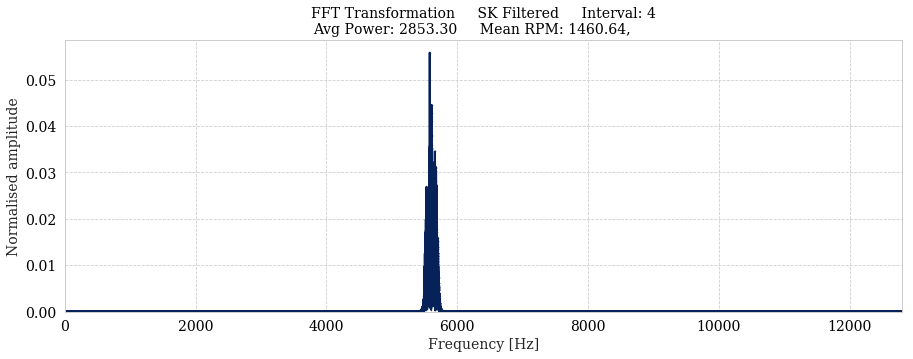

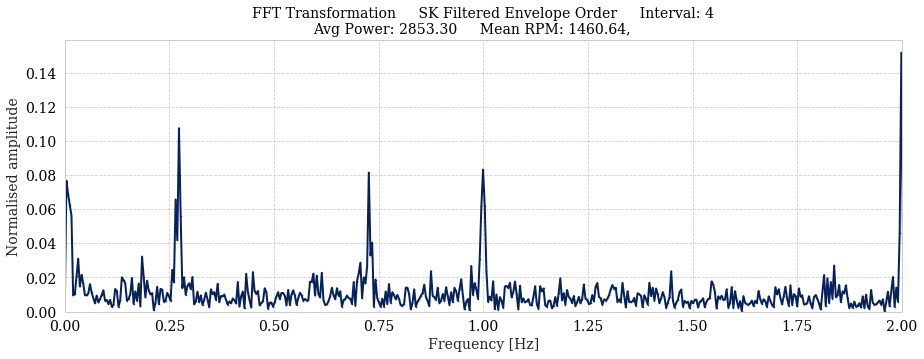

Kurtosis of 4 -0.163
Center Frequency: 5600.000
Used Bandwidth in orders: 16.431


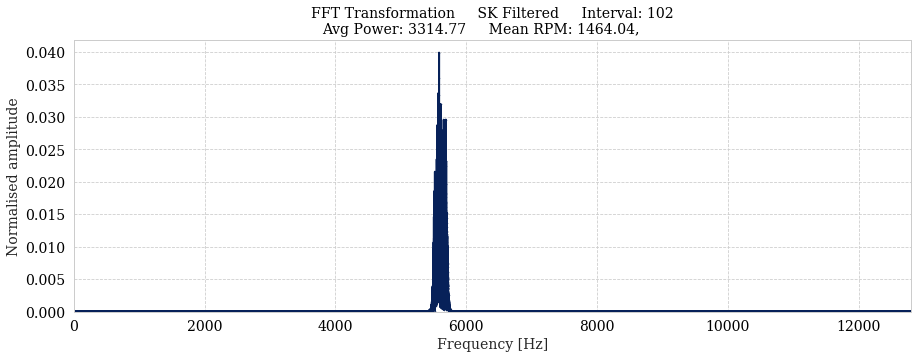

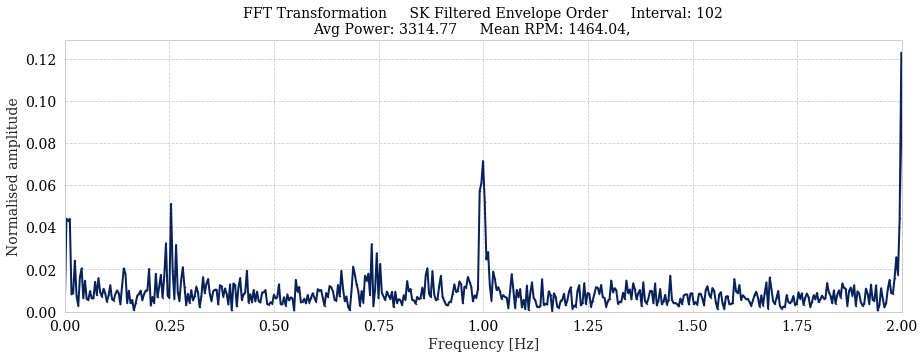

Kurtosis of 102 0.027
Center Frequency: 5600.000
Used Bandwidth in orders: 16.393


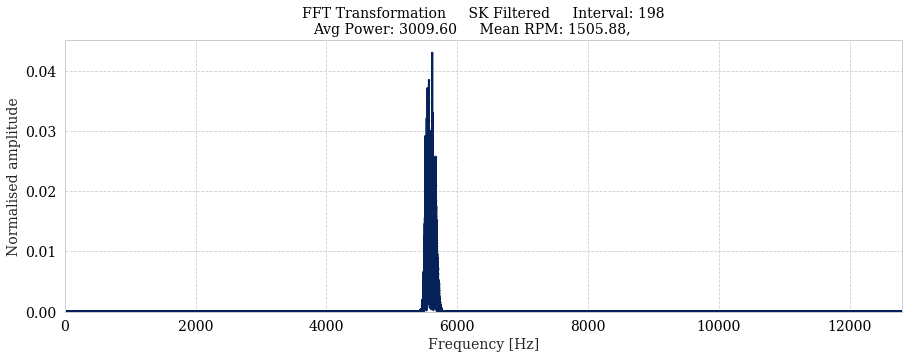

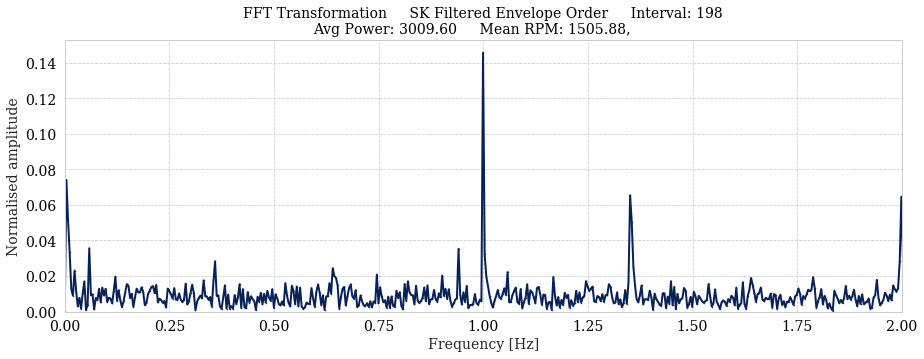

Kurtosis of 198 -0.077
Center Frequency: 5600.000
Used Bandwidth in orders: 15.938


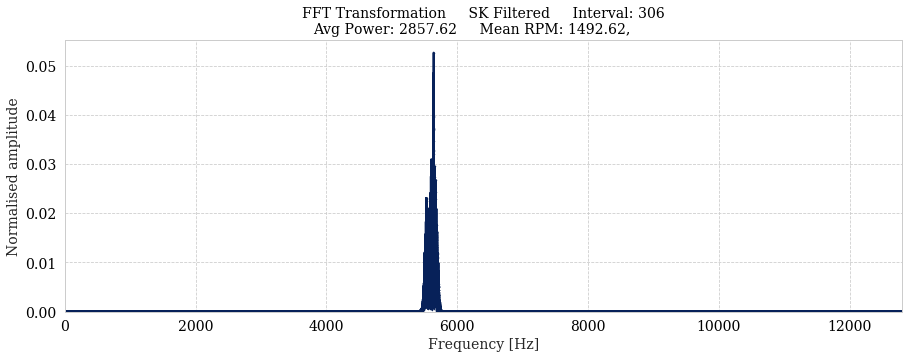

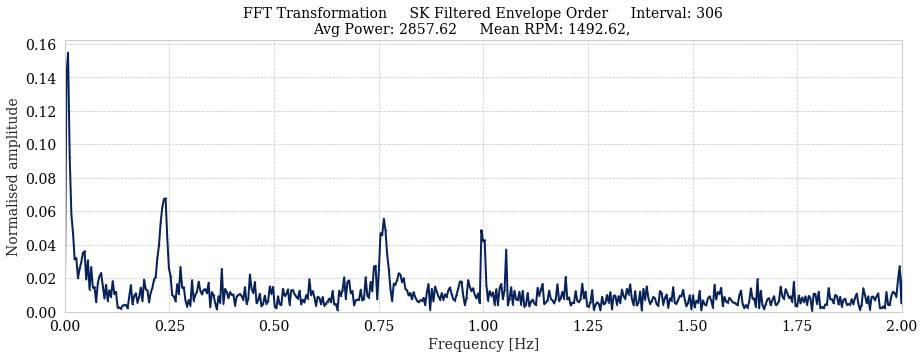

Kurtosis of 306 0.624
Center Frequency: 5600.000
Used Bandwidth in orders: 16.079


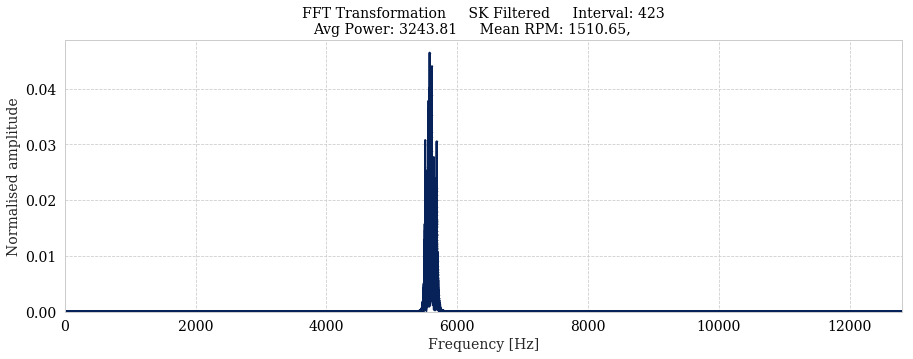

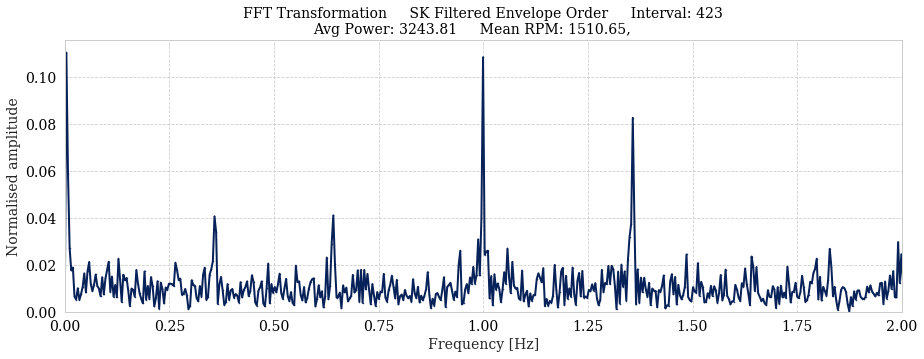

Kurtosis of 423 -0.116
Center Frequency: 5600.000
Used Bandwidth in orders: 15.887


In [27]:
interesting_intervals = [4, 102, 198, 306, 423]
bandpassed_signal = bandpassed_9K
ffts = []
fft_times = []

#for i, signal in enumerate(bandpassed_signal):
for i in interesting_intervals:
    if avg_power[i] < 2400:
        continue
    bw = float(concated['Bandwidths'][i])
    if i == 50:
        print('------------------------------------------------\n\n')
        print('               FIRST 50 FINISHED')
        print('\n\n------------------------------------------------')
    if True: #i< 50 or i>370: #bw < 1000 and i<50:# or (i>50 and i<60) or (i > 190 and i < 200)):
        # Plot SK filtered signal
        #plotting_methods.plot_signal(times[i], bandpassed_signal[i],name='SK Filtered', x_min=3, x_max=3.5, interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        plotting_methods.plot_fft(times[i][1:], bandpassed_signal[i], name='SK Filtered', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        
        #Calcutale envelope
        highut_lp = 1000
        rectified = abs(bandpassed_signal[i])**2
        bandpass_filtered_rect_lp = filters.butter_lp_filter(rectified, highut_lp, fs, order=5)
        
        #Plot envelope signal
        one_order = avg_rpm[i]/60
        freq=[one_order]
        #plotting_methods.plot_fft(times[i][1:], bandpass_filtered_rect_lp, x_max=100,frequency_lines=freq,name='SK Filtered Envelope', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        
        #Calculate Envelope Order
        try:
            x_round, resampled_envelope, x_time = resample_signals.do_cubic_resampling(times[i][1:], bandpass_filtered_rect_lp, peak_array[i], number_of_resample_points=2000)
            fft, fft_time = plotting_methods.plot_fft(x_round, resampled_envelope, x_max=2, y_max=None,frequency_lines=[], name='SK Filtered Envelope Order', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
            ffts.append(normalise_fft(fft))
            fft_times.append(fft_time)
        except: #If resampling fails for some reason
            print('---------------------------------------\n\n')
            print(f'              INTERVAL {i}')
            print('ENVELOPE ORDER COULD NOT BE CALCULATED!\n\n')
            print('---------------------------------------')
        
        # Print key values
        print(f'Kurtosis of {i} {kurtosis(bandpassed_signal[i]):.3f}')
        print(f'Center Frequency: {cf:.3f}')
        print(f'Used Bandwidth in orders: {400*60/avg_rpm[i]:.3f}')


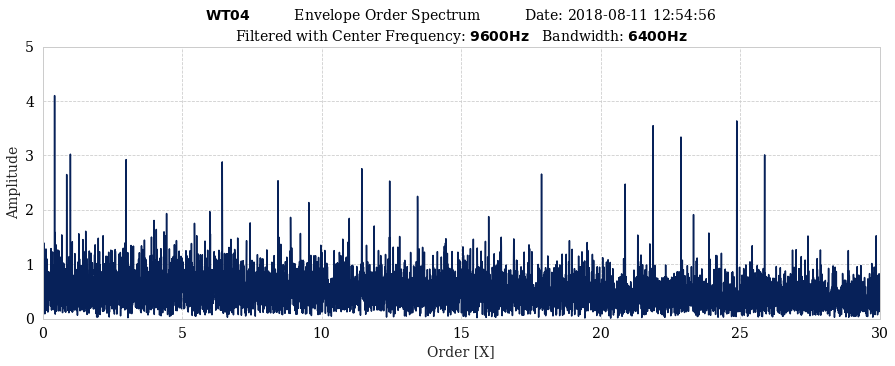

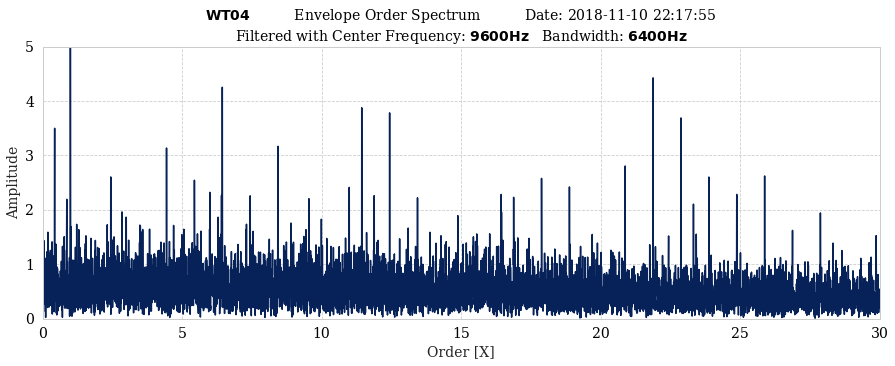

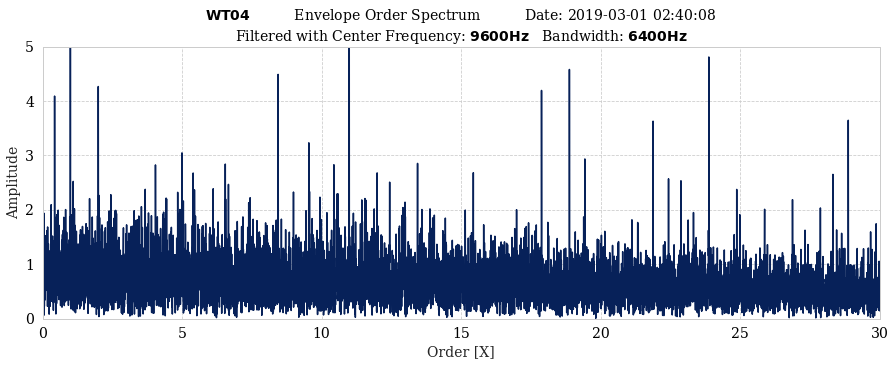

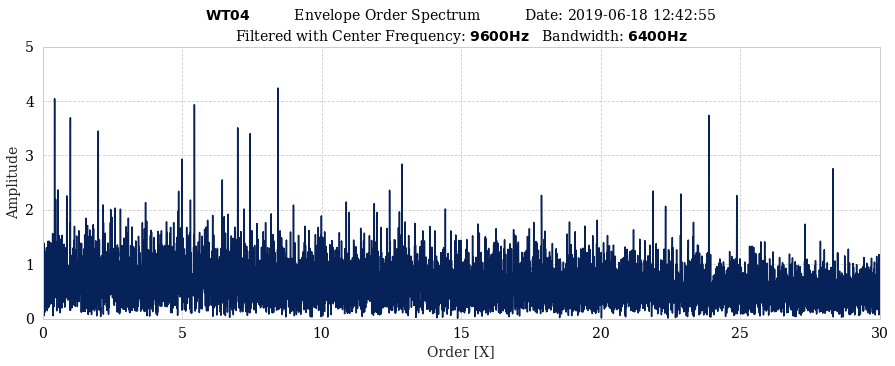

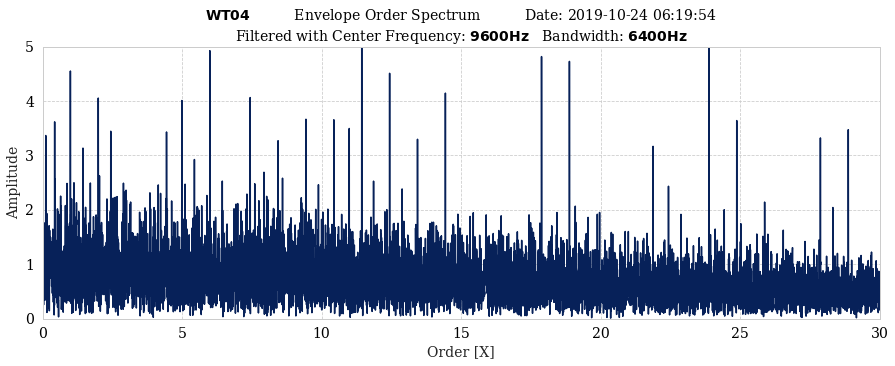

In [80]:
save_path = '../../plots/envelope_order_higher_freq/'
for i,interval in enumerate(interesting_intervals):
    plt.figure(figsize=(15,5))
    plt.plot(fft_times[i], ffts[i])
    plt.xlim(0, 30)
    plt.ylim(0,5)
    heading = r"$\bf{WT04}$" + f'          Envelope Order Spectrum          Date: {dates.values[interesting_intervals[i]][0]}'
    heading += f'\nFiltered with Center Frequency: ' + r"$\bf{9600Hz}$" + '   Bandwidth: ' + r"$\bf{6400Hz}$"
    plt.title(heading)
    plt.ylabel('Amplitude')
    plt.xlabel('Order [X]')
    plt.margins(0)
    plt.savefig(f'{save_path}wt04_high_freq_{interval}.png', dpi=300)
    plt.show()

In [81]:
path = wt_folder_path + 'higfreq.npz'
np.savez(path, fft=ffts, freq=fft_times, intervals=interesting_intervals, dates=dates)


### 5.6 Filter on Center Frequency 12 kHz and Bandwidth 400 Hz 


In [920]:
# Just loop through
bandpassed_12K = []
signal_size = len(filtered_signals)
for i in range(len(filtered_signals)):
    use_signal = filtered_signals[i]
    time = times[i]
    
    cf = 12000
    bw = 200
    low = cf - bw
    high = cf + bw

    if high > 0.5*fs:
        high = 0.5*fs -100    
    
    y = filter_based_on_optimal_bw(low,high,use_signal, time)
    bandpassed_12K.append(y)
    print(f'Filtering {i+1} / {signal_size} signals', end='\r')

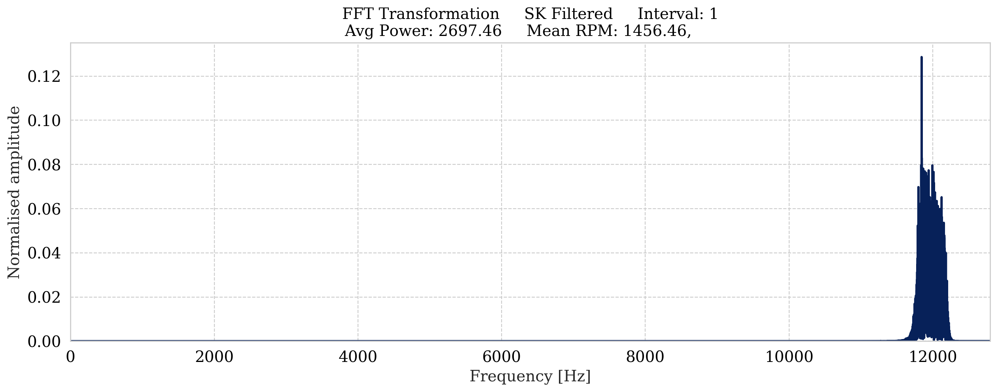

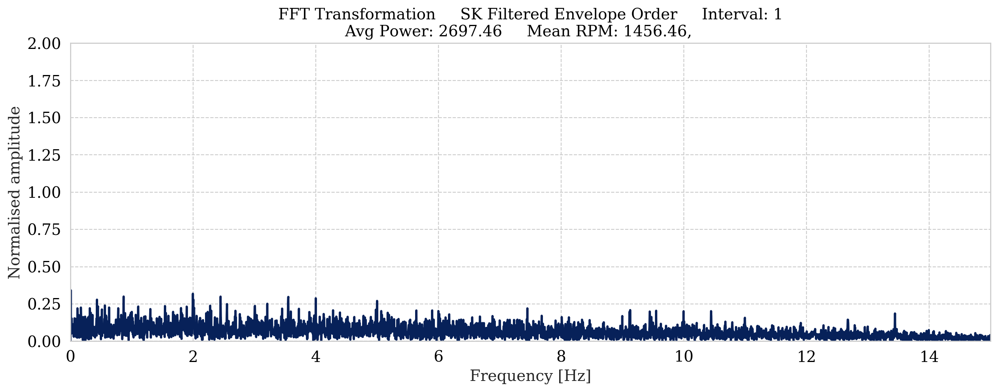

Kurtosis of 1 0.027
Center Frequency: 12000.000
Used Bandwidth in orders: 16.478


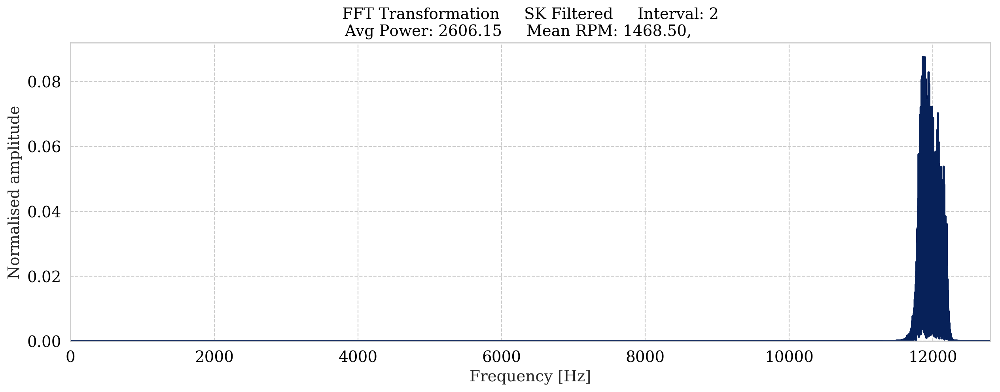

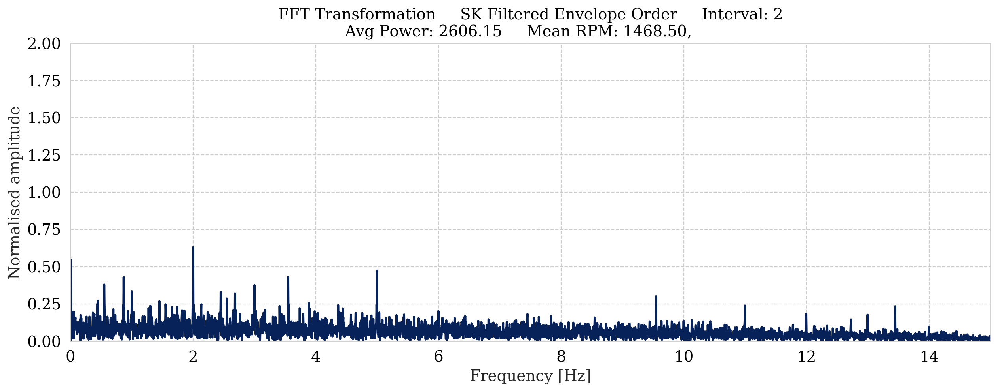

Kurtosis of 2 -0.012
Center Frequency: 12000.000
Used Bandwidth in orders: 16.343


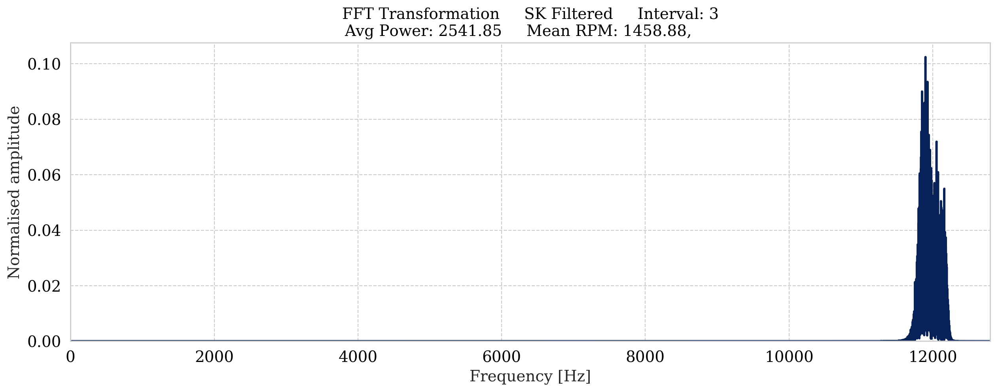

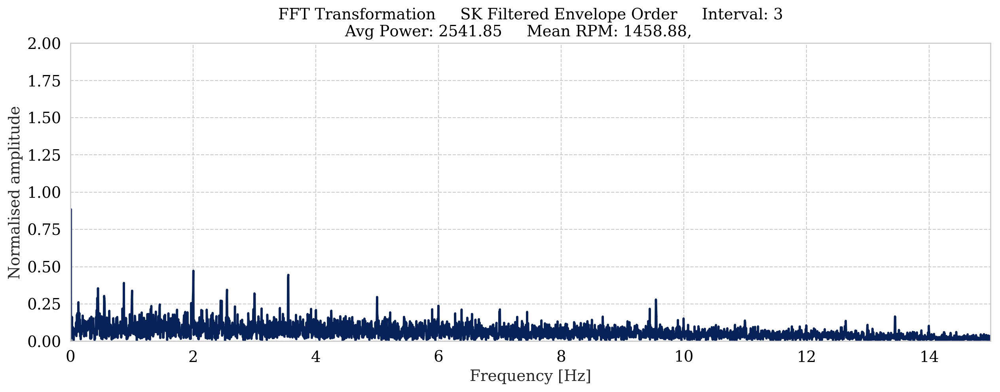

Kurtosis of 3 0.184
Center Frequency: 12000.000
Used Bandwidth in orders: 16.451


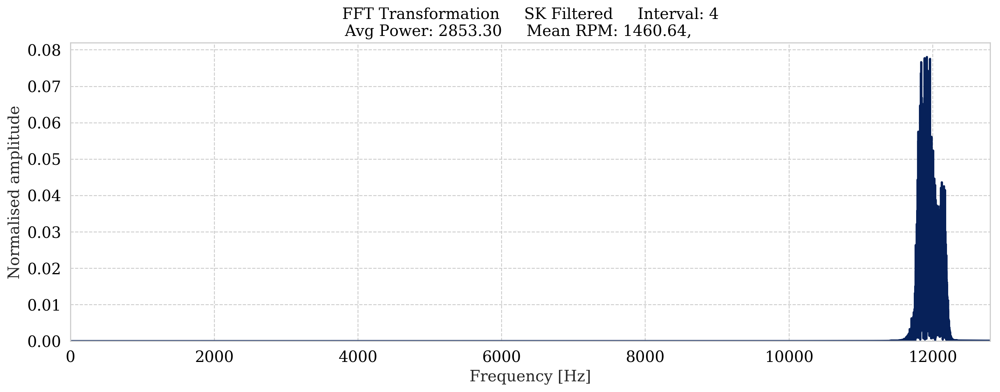

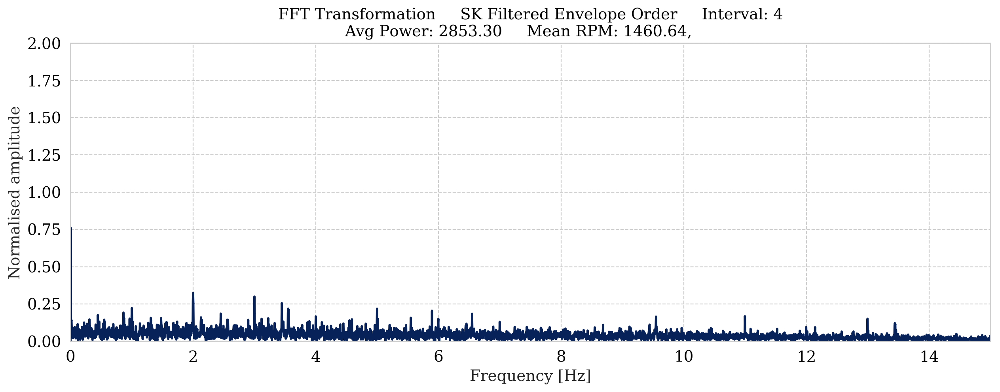

Kurtosis of 4 0.098
Center Frequency: 12000.000
Used Bandwidth in orders: 16.431


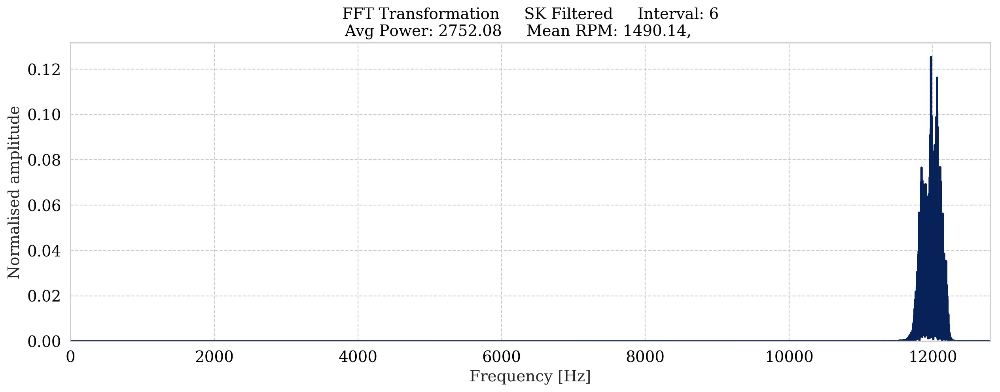

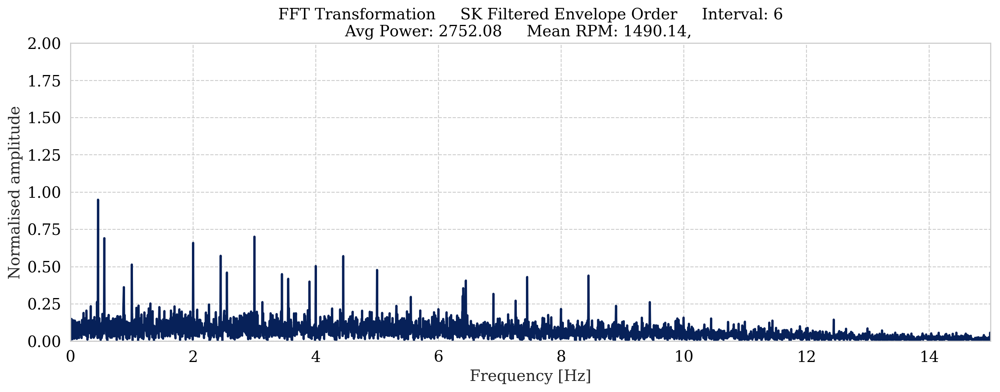

Kurtosis of 6 0.018
Center Frequency: 12000.000
Used Bandwidth in orders: 16.106


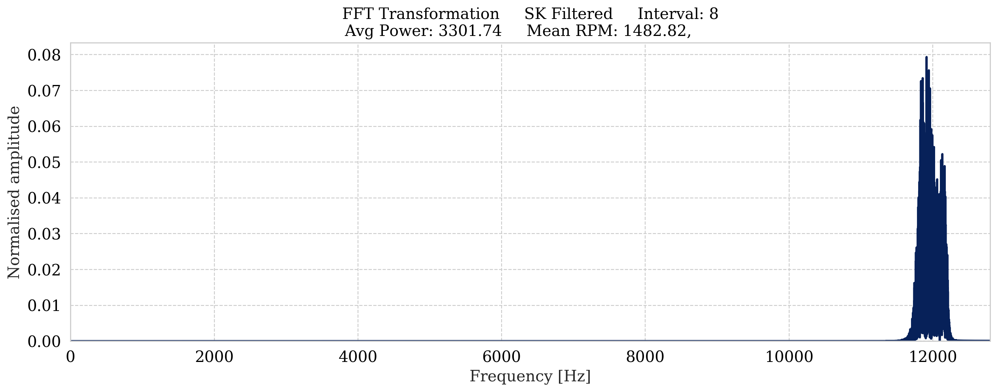

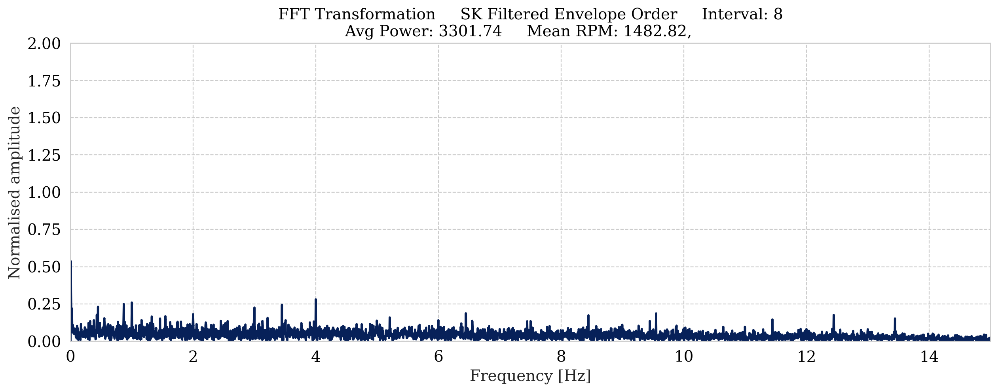

Kurtosis of 8 0.084
Center Frequency: 12000.000
Used Bandwidth in orders: 16.185


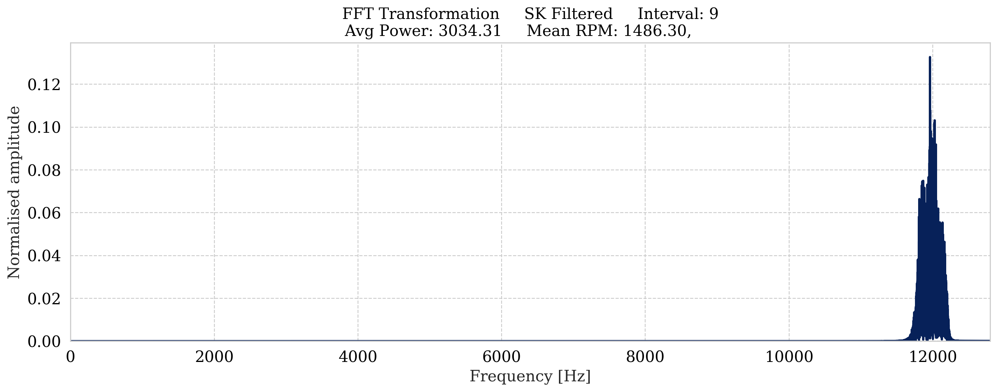

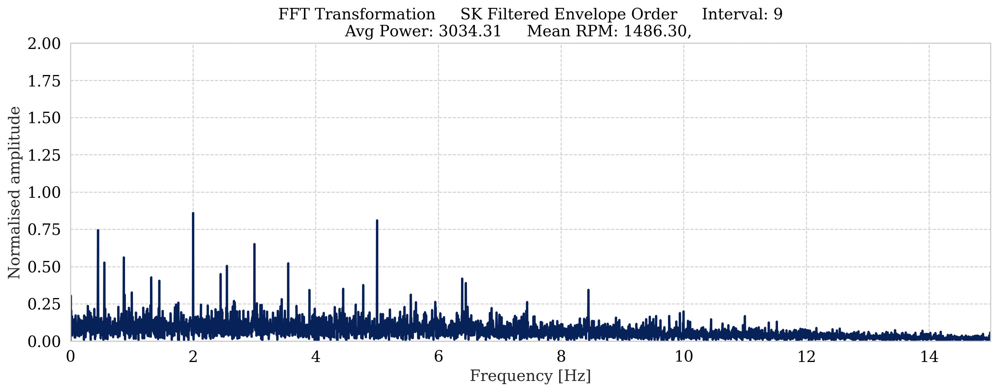

Kurtosis of 9 0.022
Center Frequency: 12000.000
Used Bandwidth in orders: 16.147


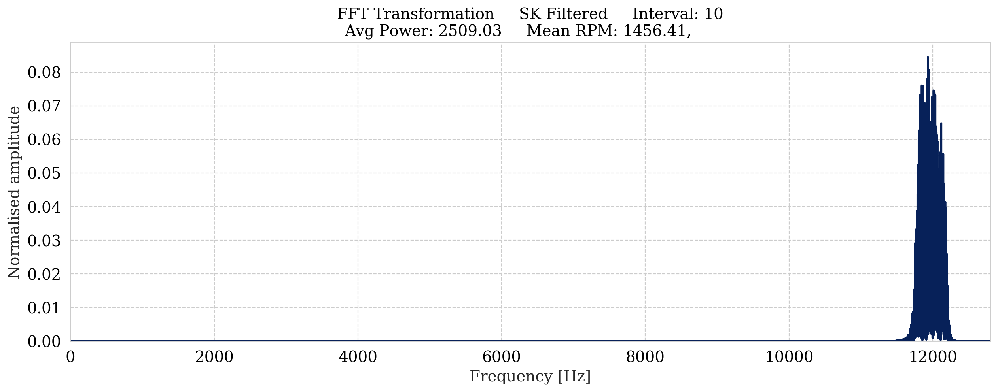

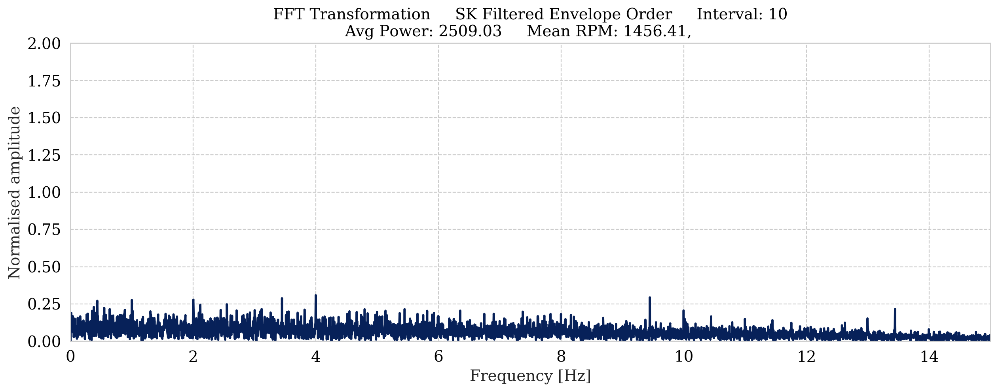

Kurtosis of 10 -0.007
Center Frequency: 12000.000
Used Bandwidth in orders: 16.479


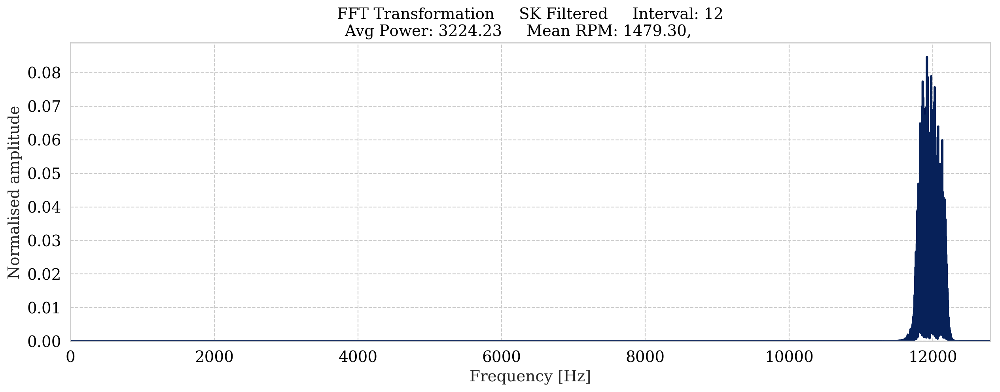

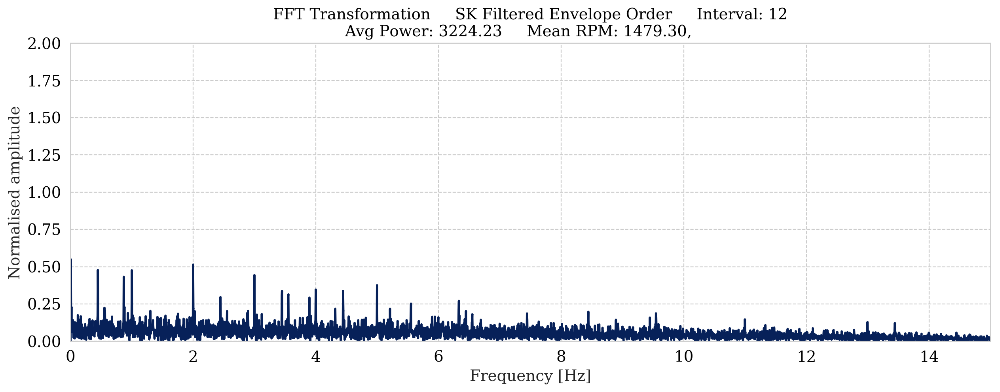

Kurtosis of 12 0.054
Center Frequency: 12000.000
Used Bandwidth in orders: 16.224


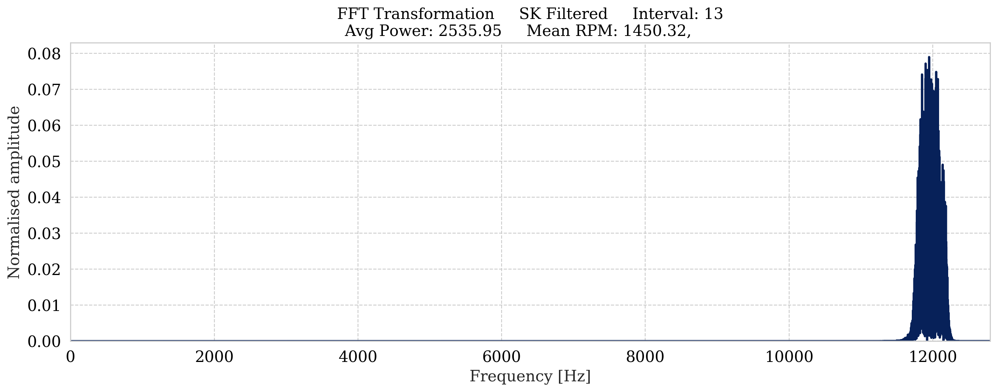

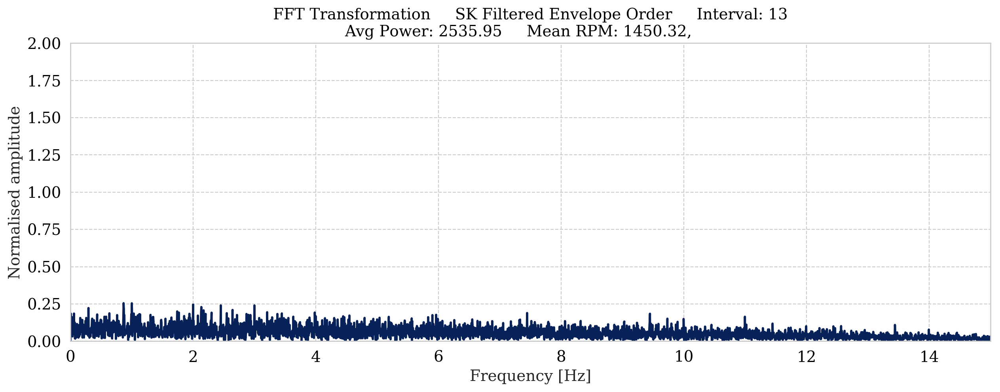

Kurtosis of 13 0.028
Center Frequency: 12000.000
Used Bandwidth in orders: 16.548


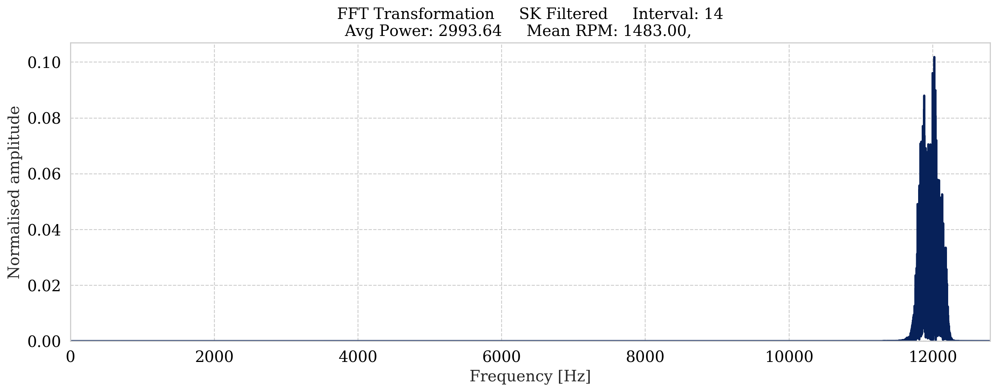

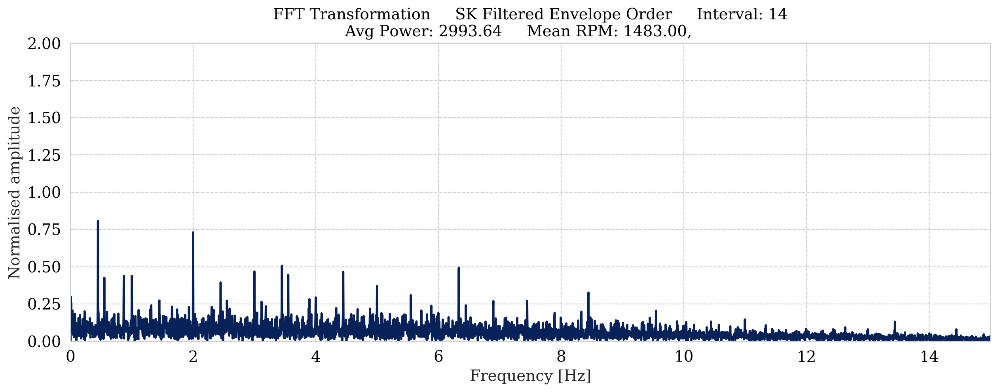

Kurtosis of 14 0.061
Center Frequency: 12000.000
Used Bandwidth in orders: 16.183


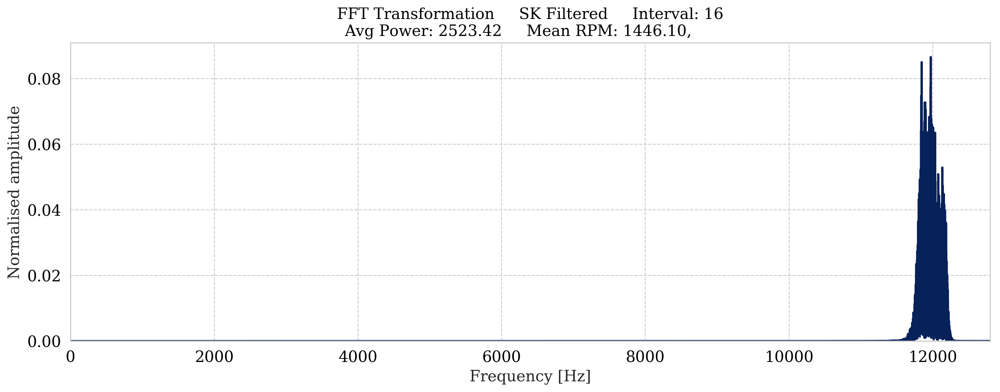

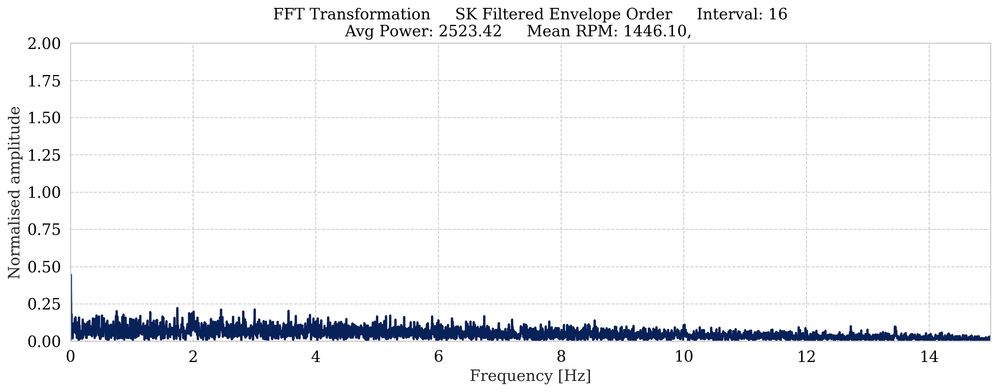

Kurtosis of 16 0.096
Center Frequency: 12000.000
Used Bandwidth in orders: 16.596


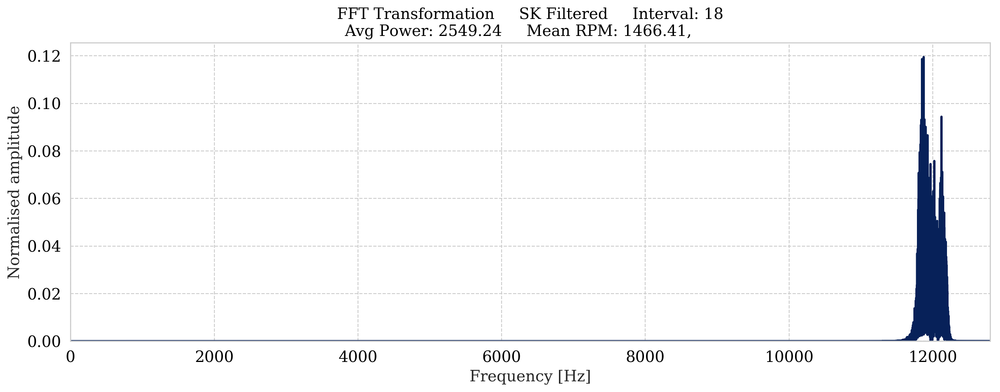

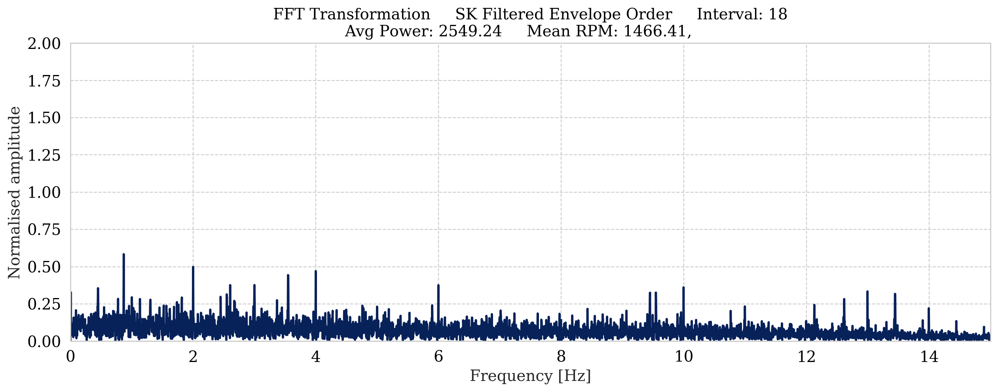

Kurtosis of 18 -0.015
Center Frequency: 12000.000
Used Bandwidth in orders: 16.367


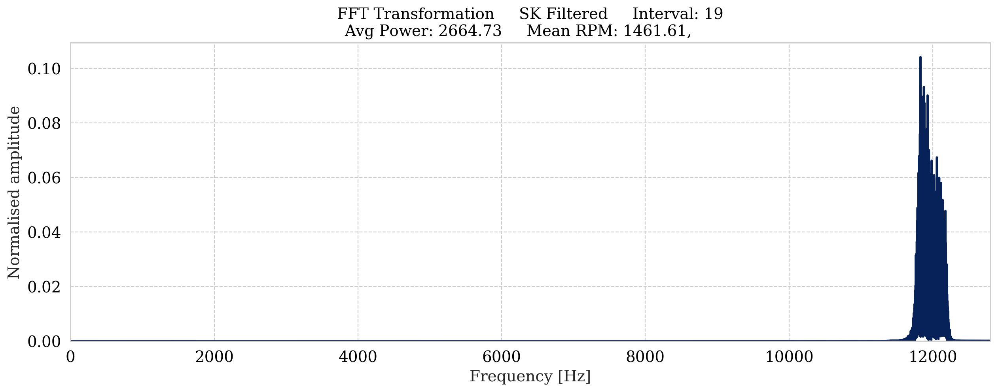

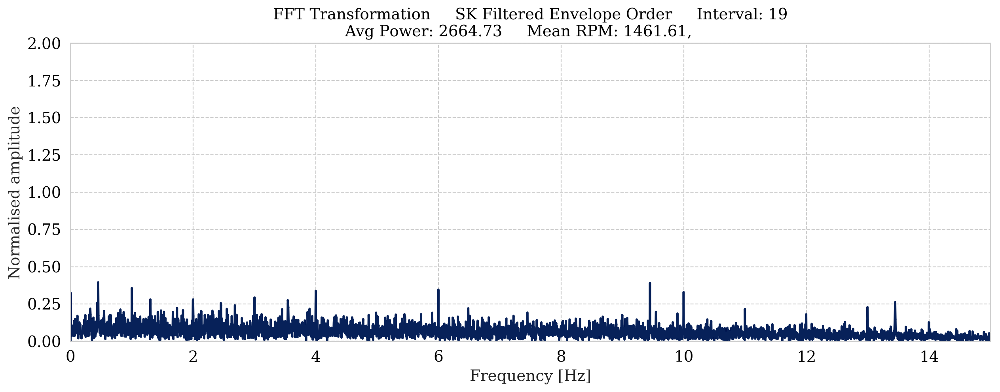

Kurtosis of 19 -0.057
Center Frequency: 12000.000
Used Bandwidth in orders: 16.420


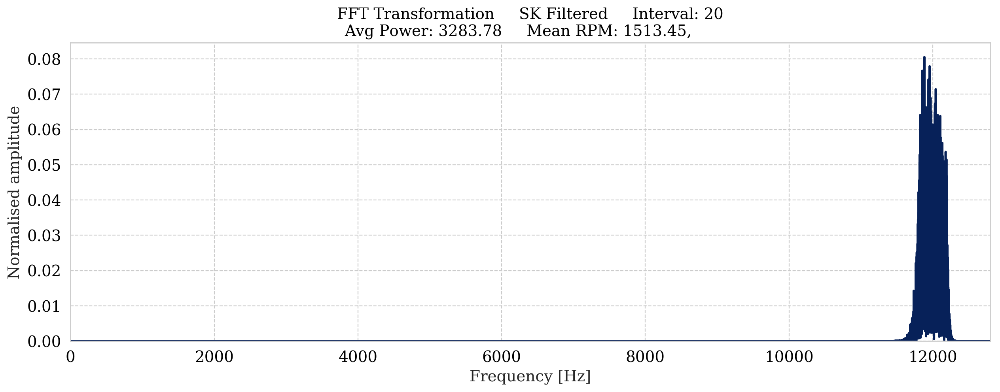

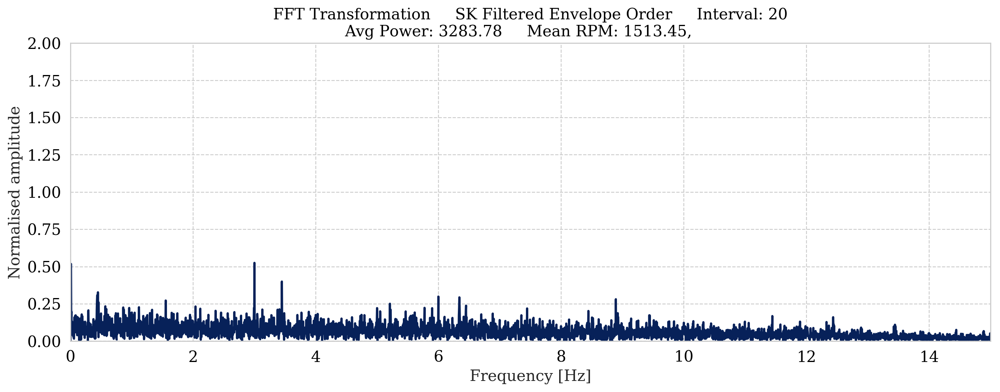

Kurtosis of 20 0.105
Center Frequency: 12000.000
Used Bandwidth in orders: 15.858


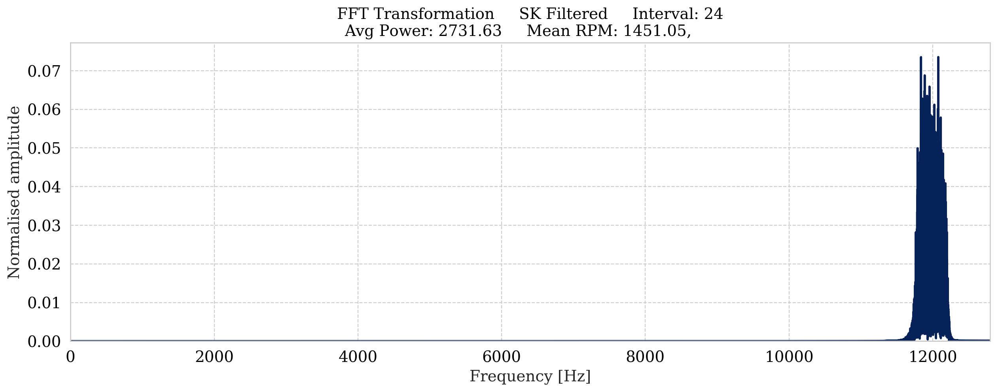

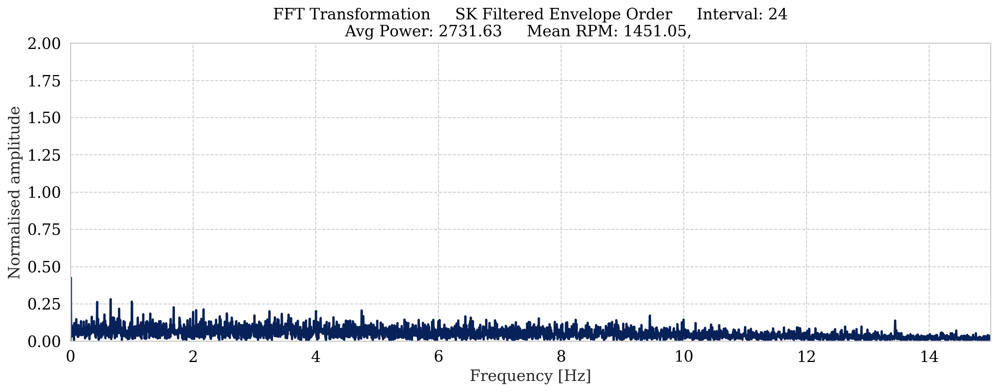

Kurtosis of 24 0.091
Center Frequency: 12000.000
Used Bandwidth in orders: 16.540


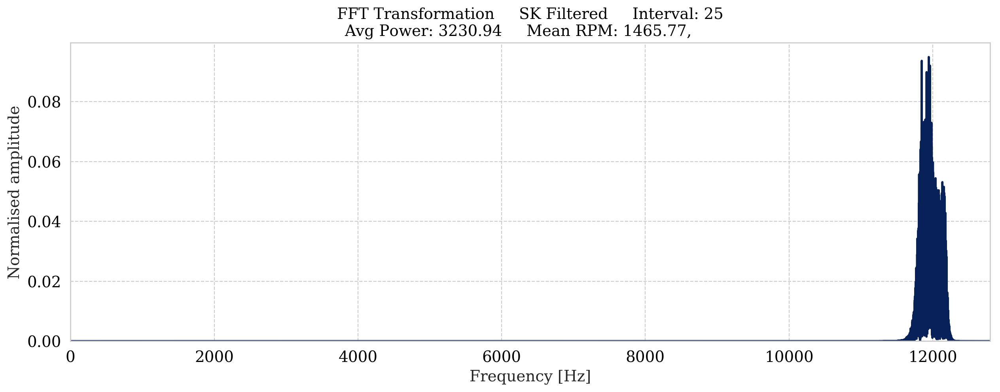

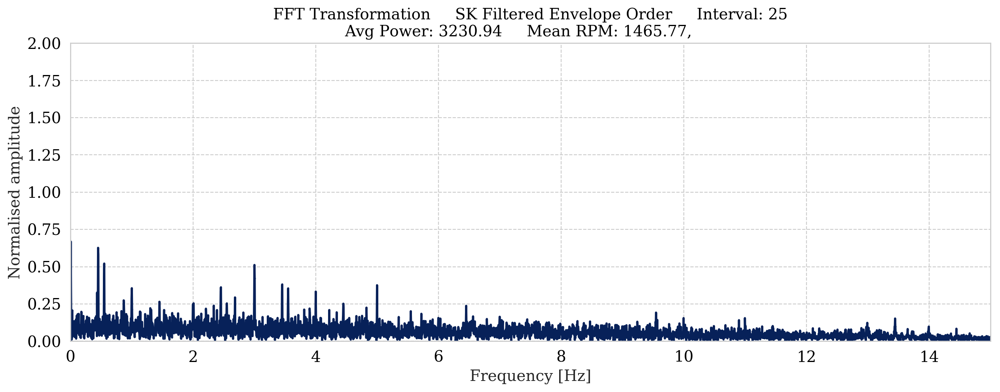

Kurtosis of 25 0.093
Center Frequency: 12000.000
Used Bandwidth in orders: 16.374


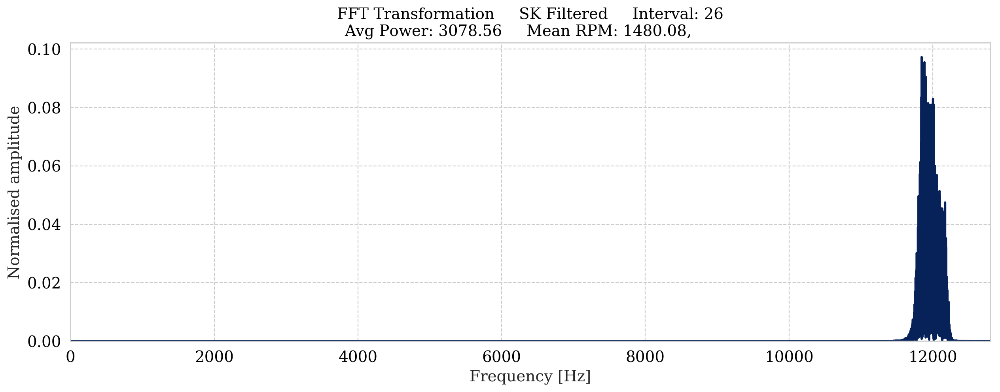

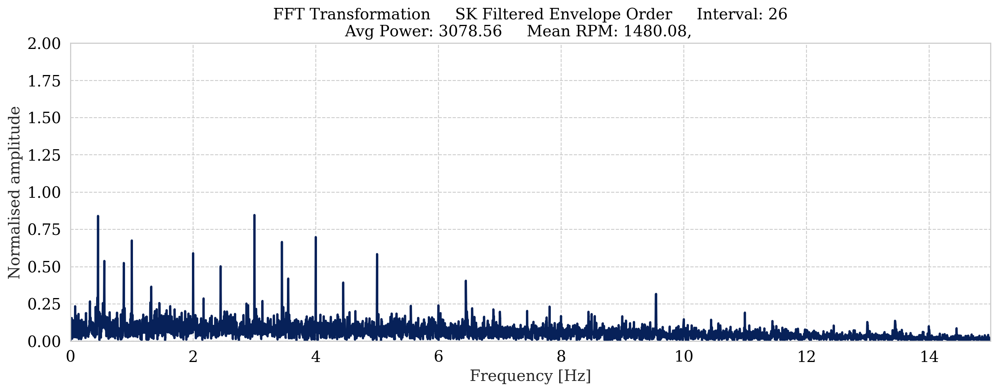

Kurtosis of 26 0.094
Center Frequency: 12000.000
Used Bandwidth in orders: 16.215


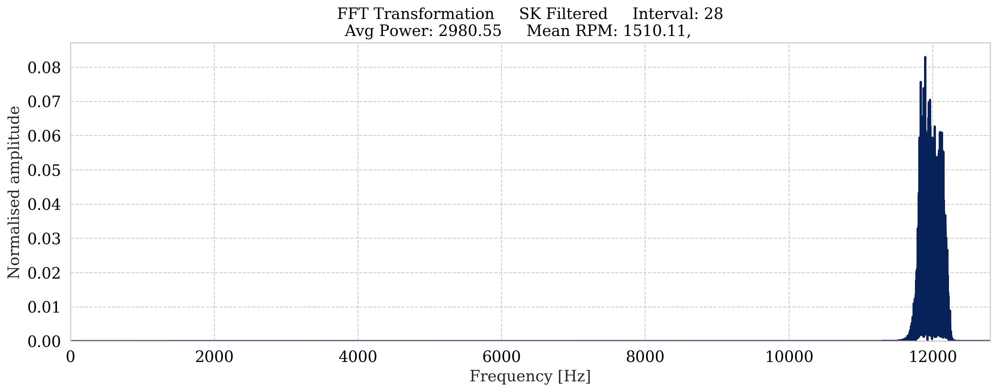

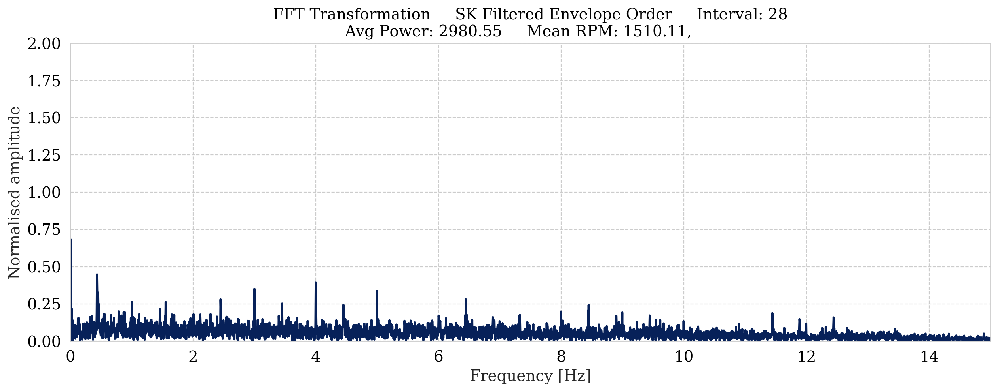

Kurtosis of 28 0.270
Center Frequency: 12000.000
Used Bandwidth in orders: 15.893


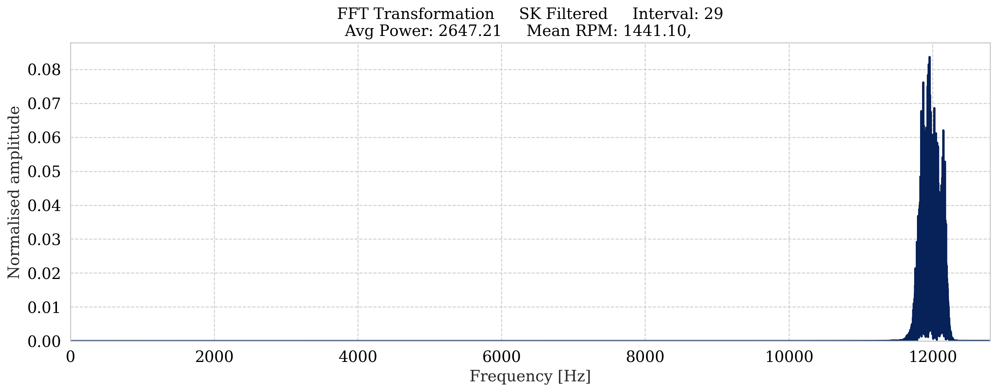

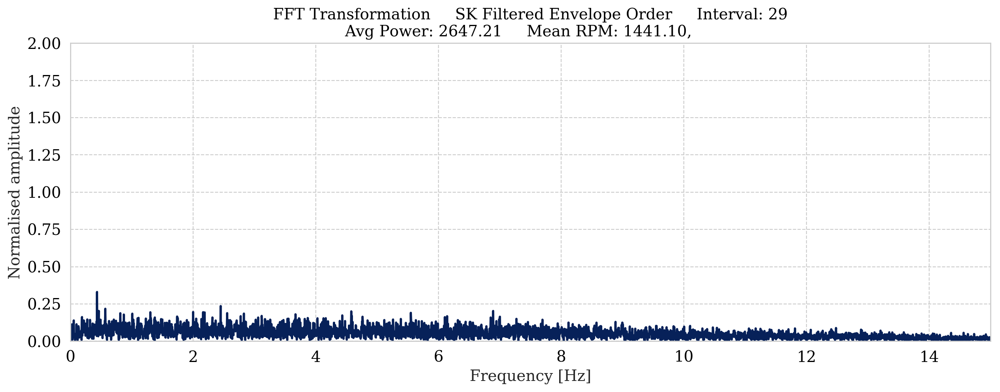

Kurtosis of 29 -0.006
Center Frequency: 12000.000
Used Bandwidth in orders: 16.654


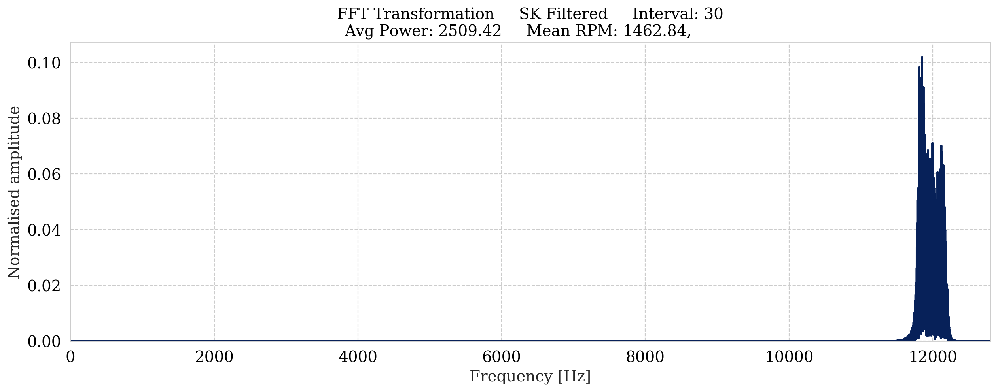

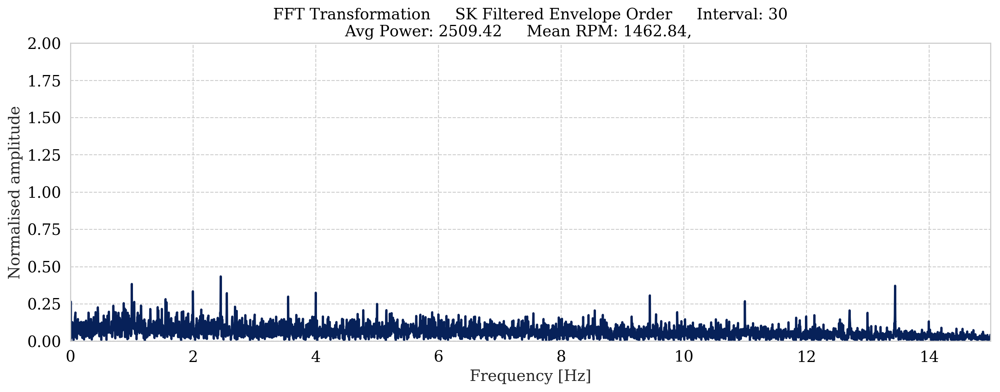

Kurtosis of 30 0.028
Center Frequency: 12000.000
Used Bandwidth in orders: 16.406


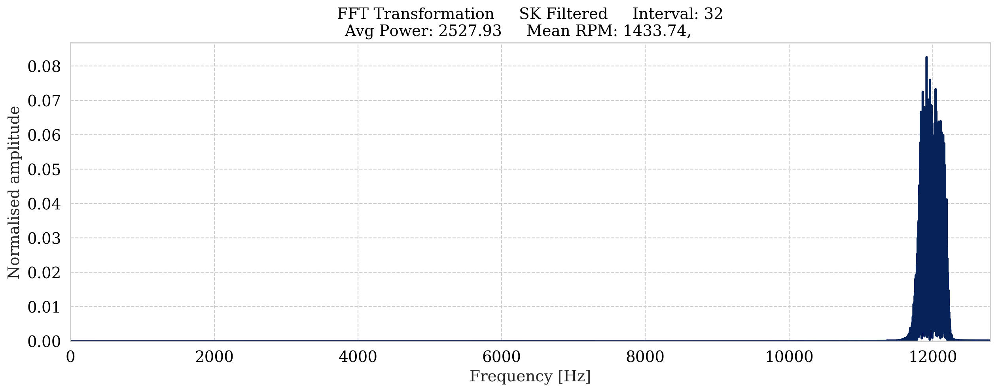

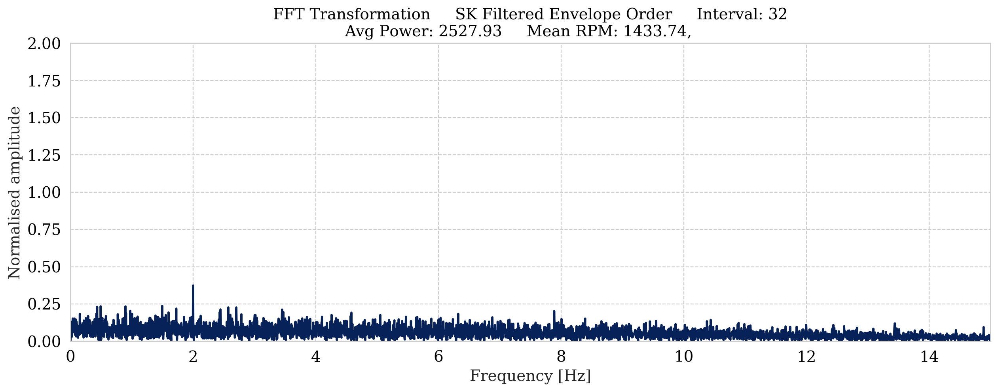

Kurtosis of 32 0.087
Center Frequency: 12000.000
Used Bandwidth in orders: 16.739


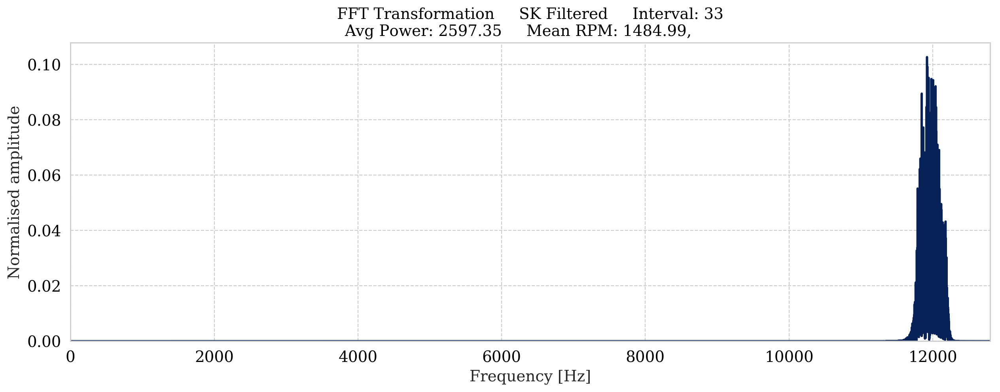

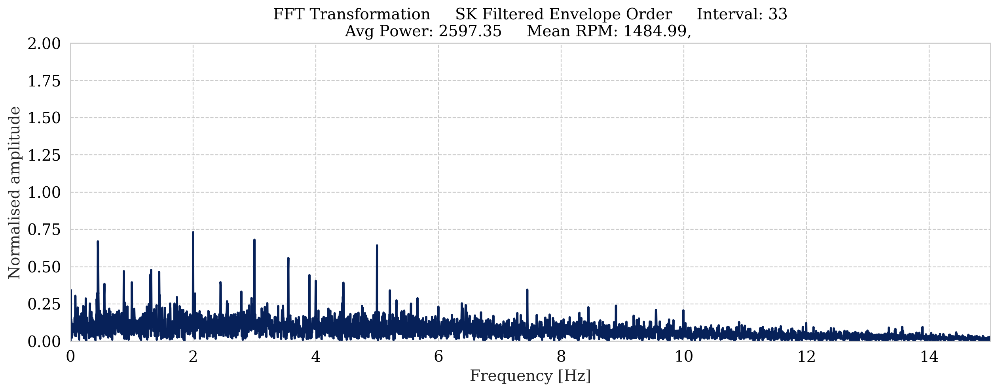

Kurtosis of 33 0.022
Center Frequency: 12000.000
Used Bandwidth in orders: 16.162


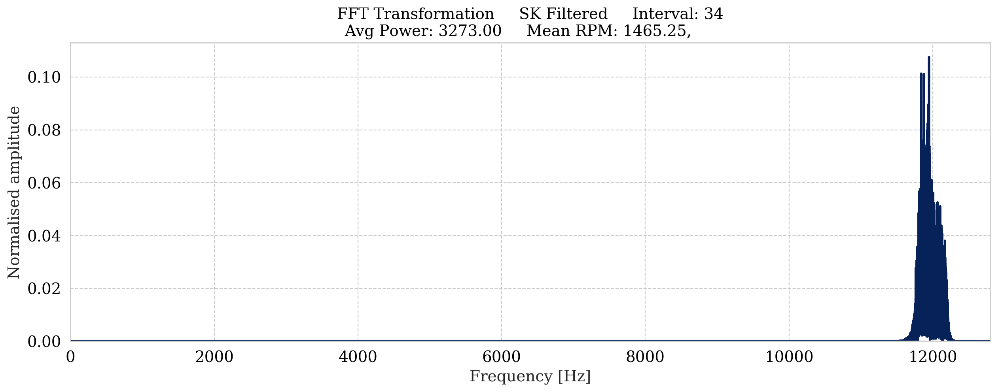

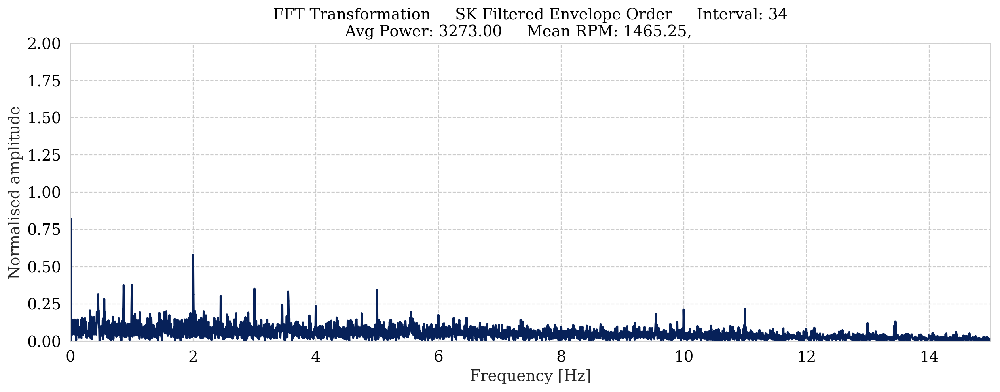

Kurtosis of 34 0.101
Center Frequency: 12000.000
Used Bandwidth in orders: 16.379


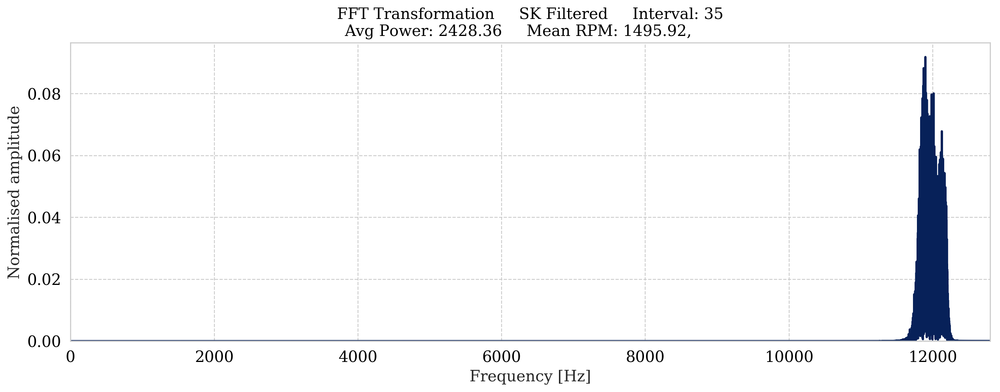

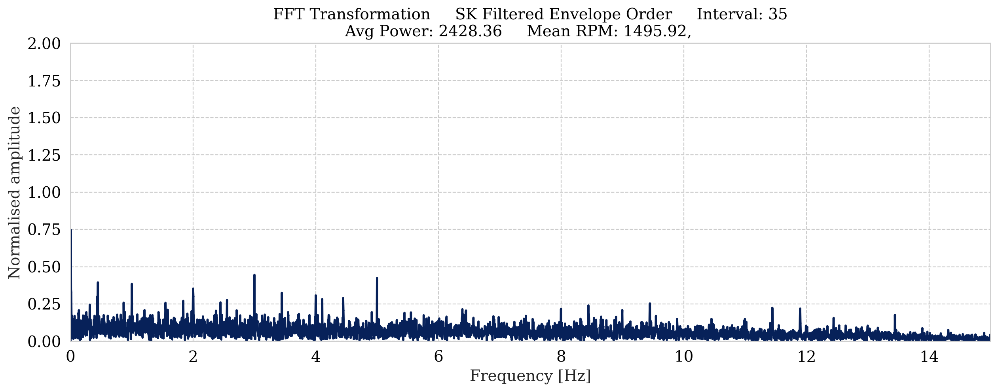

Kurtosis of 35 0.090
Center Frequency: 12000.000
Used Bandwidth in orders: 16.044


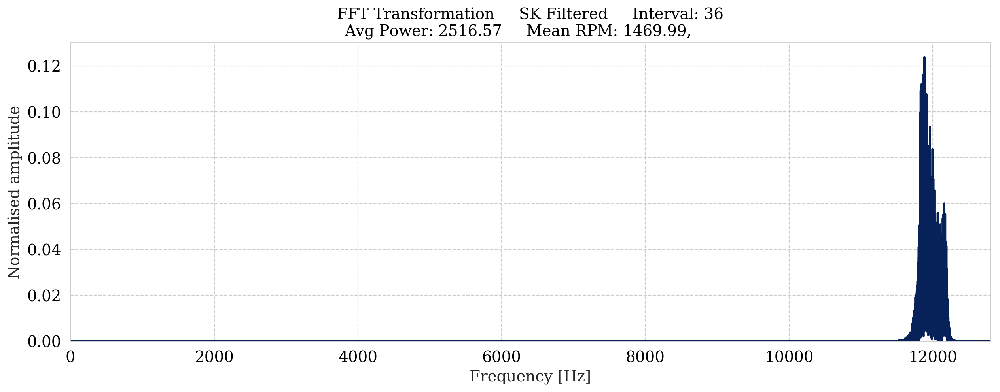

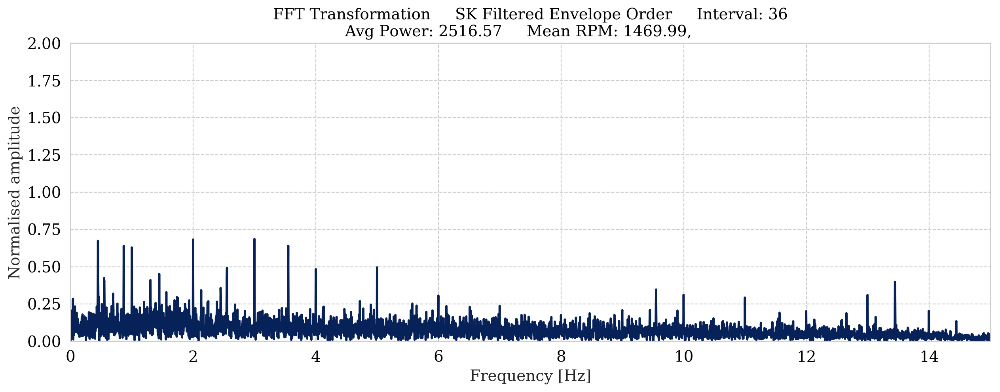

Kurtosis of 36 -0.051
Center Frequency: 12000.000
Used Bandwidth in orders: 16.327


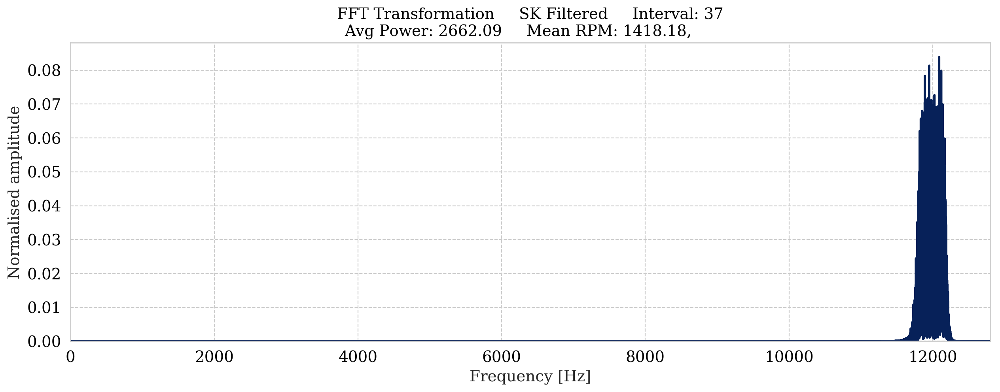

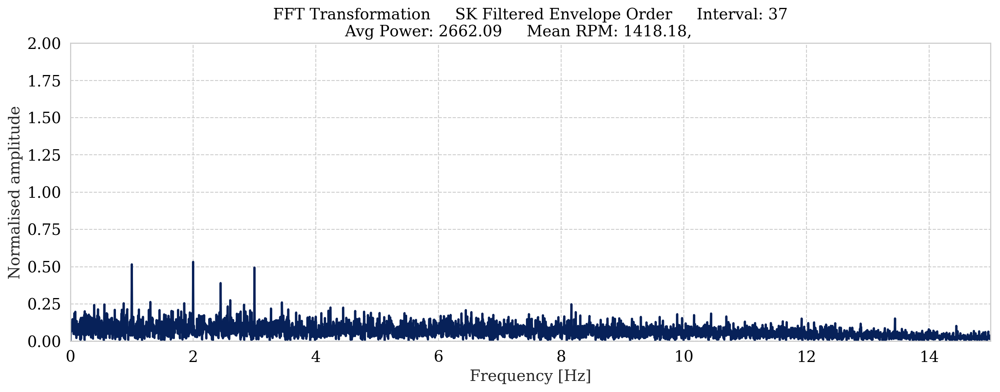

Kurtosis of 37 0.115
Center Frequency: 12000.000
Used Bandwidth in orders: 16.923


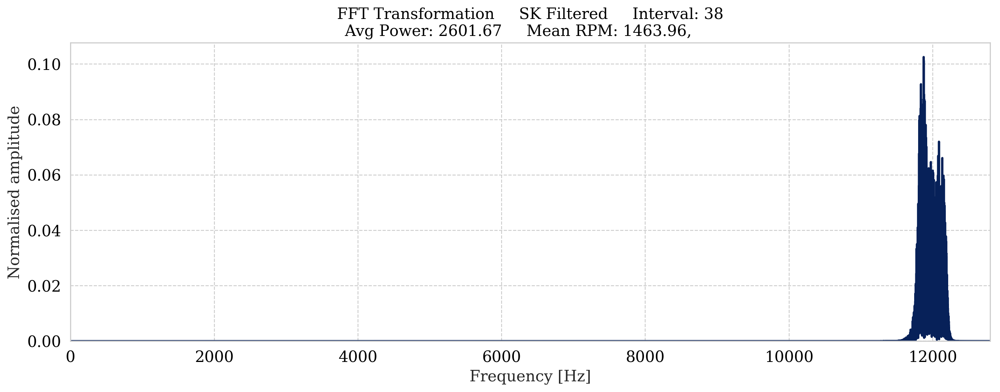

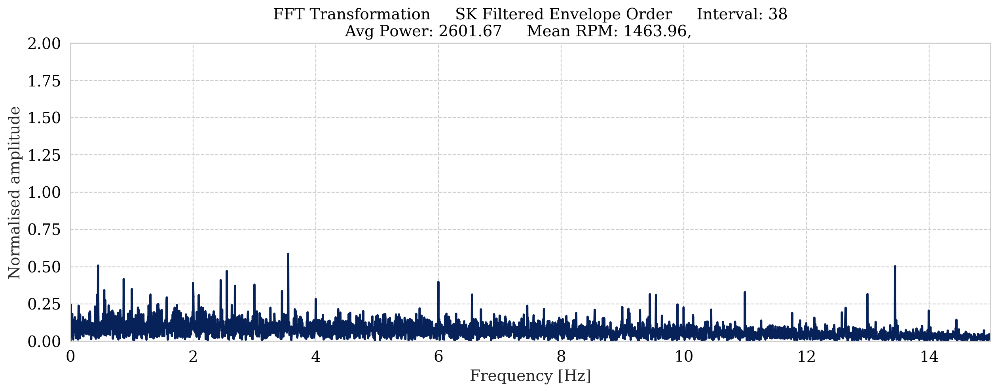

Kurtosis of 38 0.025
Center Frequency: 12000.000
Used Bandwidth in orders: 16.394


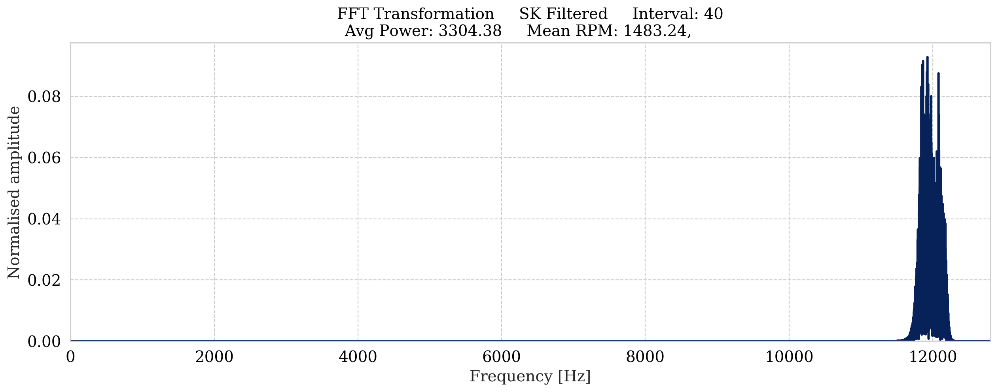

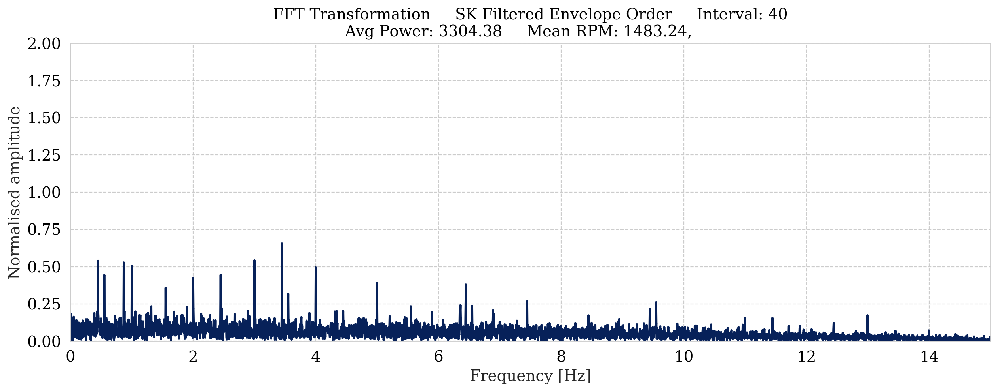

Kurtosis of 40 -0.044
Center Frequency: 12000.000
Used Bandwidth in orders: 16.181


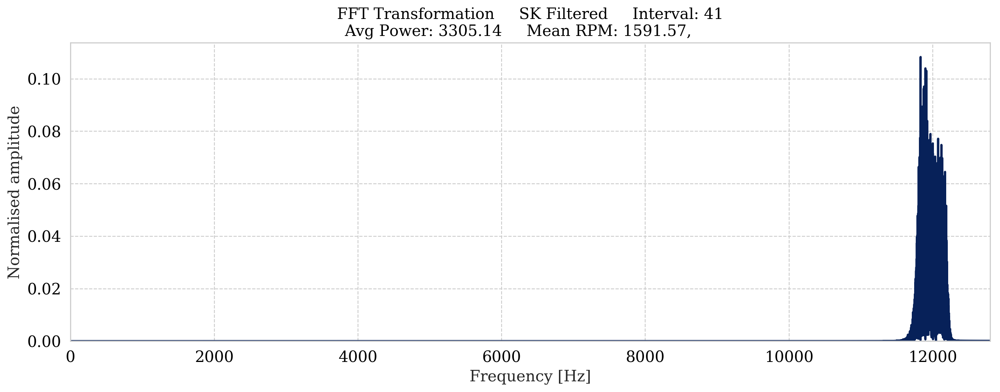

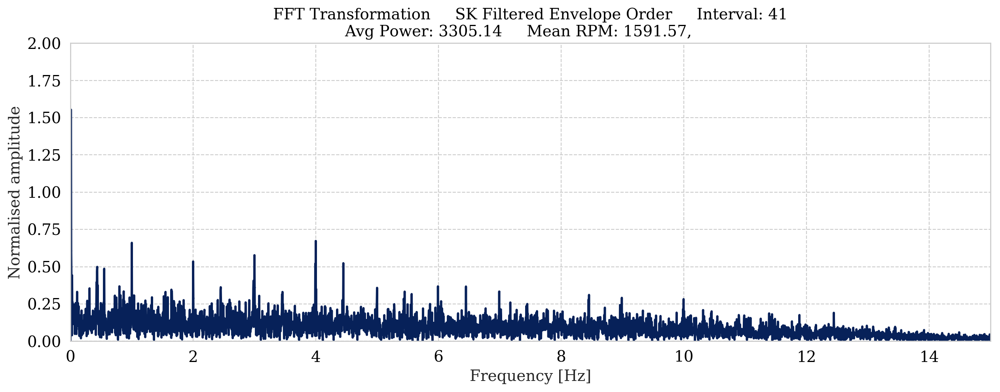

Kurtosis of 41 0.244
Center Frequency: 12000.000
Used Bandwidth in orders: 15.079


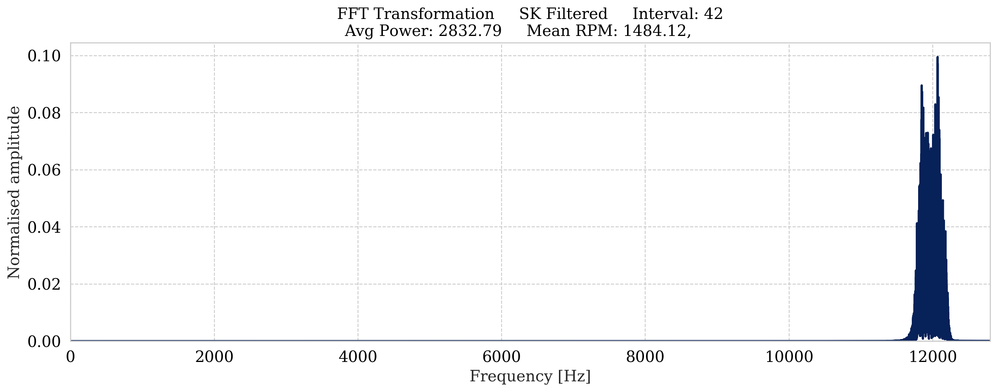

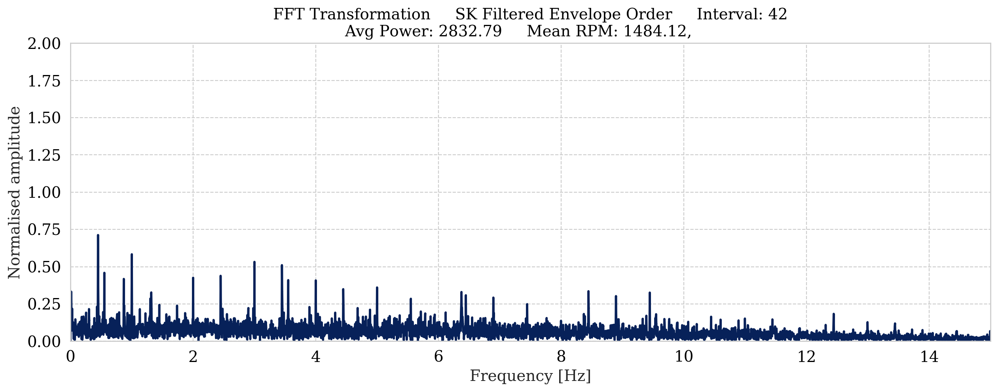

Kurtosis of 42 0.055
Center Frequency: 12000.000
Used Bandwidth in orders: 16.171


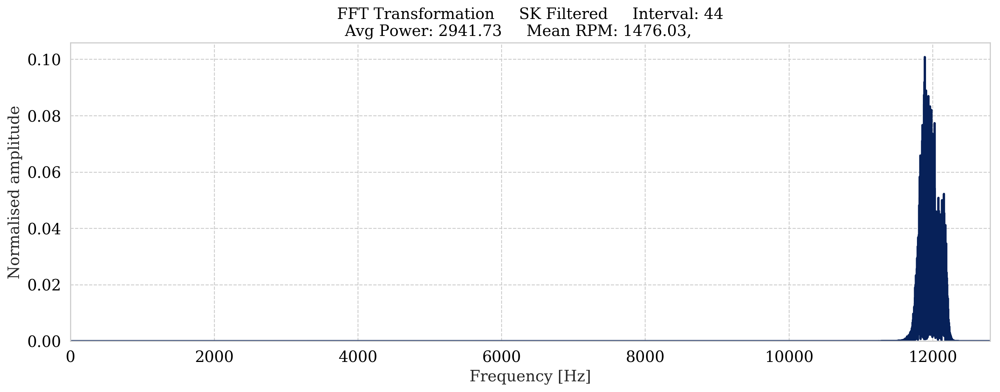

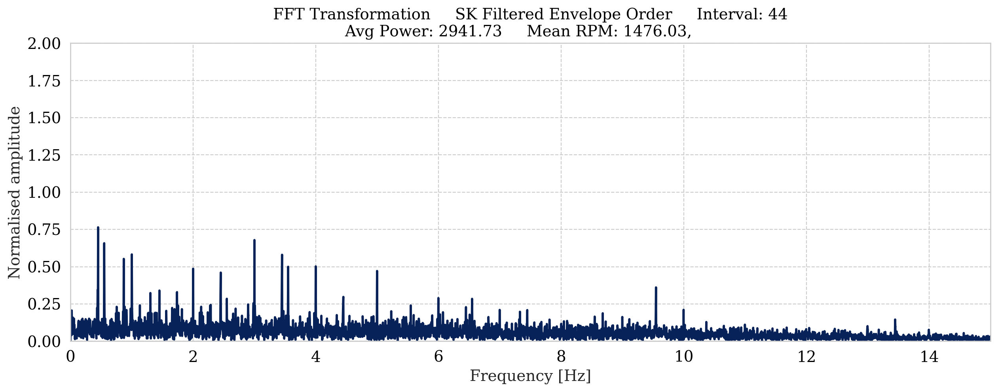

Kurtosis of 44 0.027
Center Frequency: 12000.000
Used Bandwidth in orders: 16.260


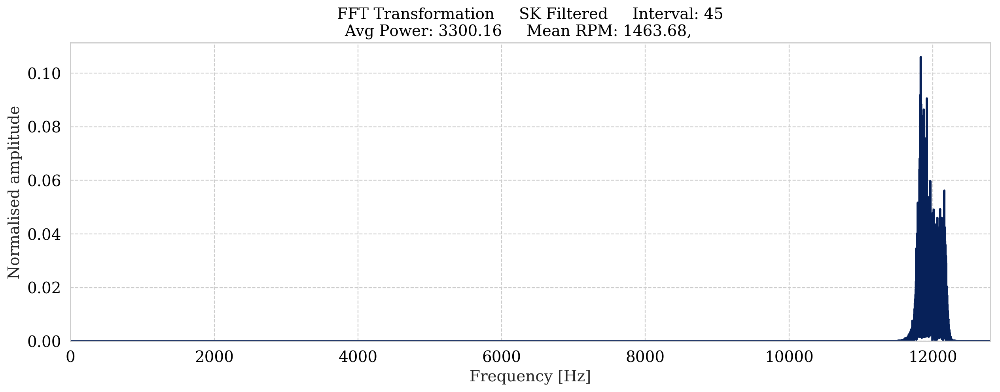

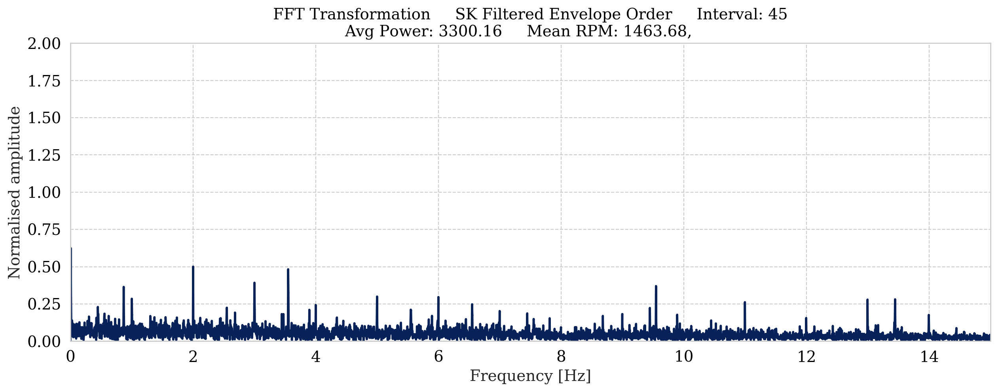

Kurtosis of 45 0.002
Center Frequency: 12000.000
Used Bandwidth in orders: 16.397


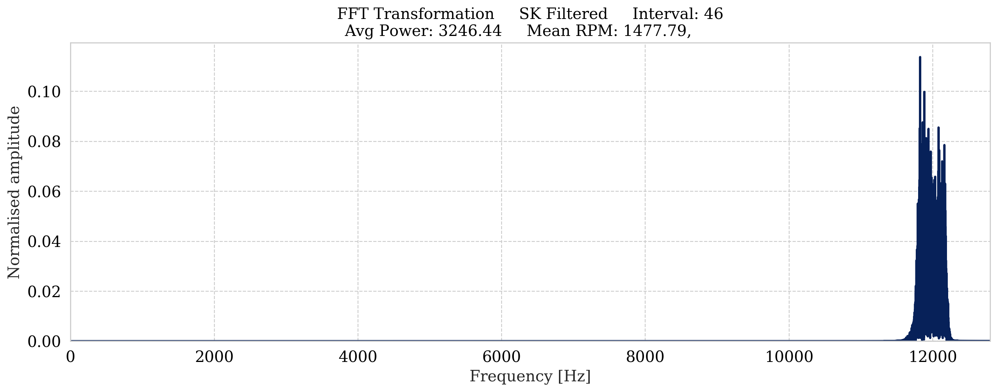

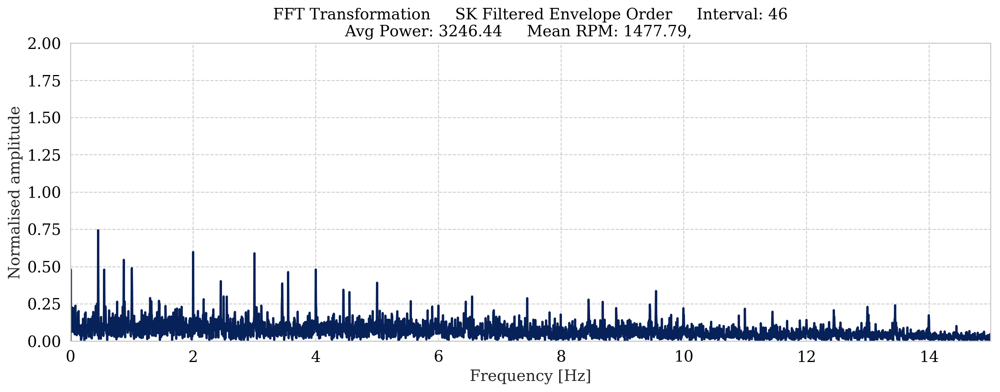

Kurtosis of 46 0.051
Center Frequency: 12000.000
Used Bandwidth in orders: 16.240


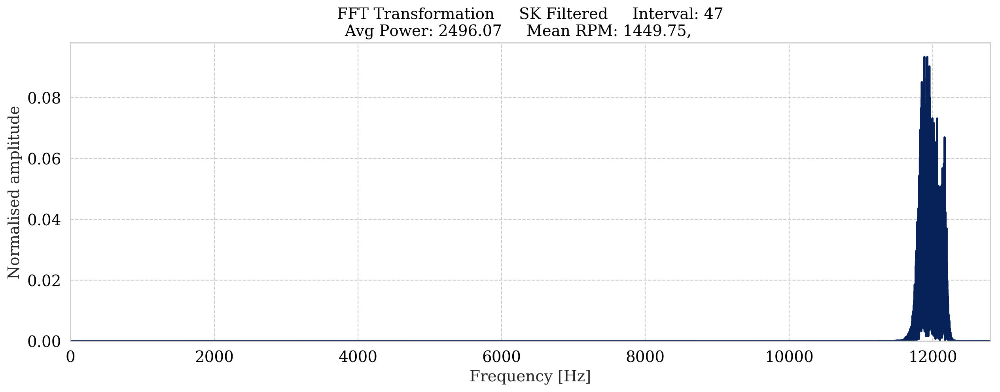

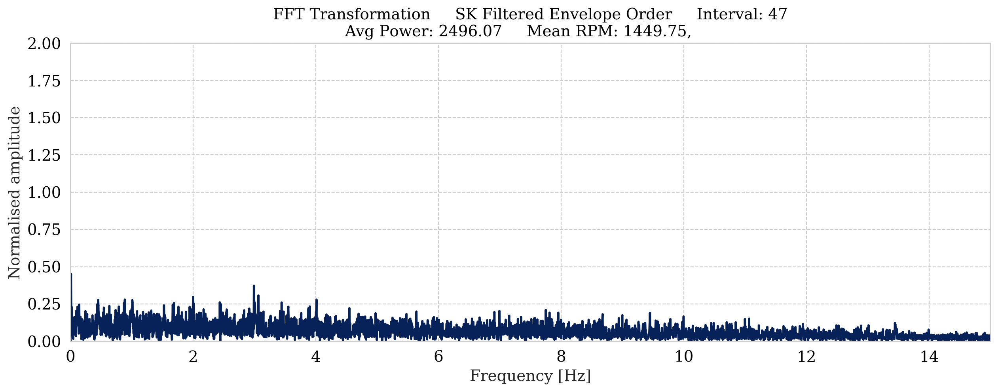

Kurtosis of 47 0.092
Center Frequency: 12000.000
Used Bandwidth in orders: 16.555


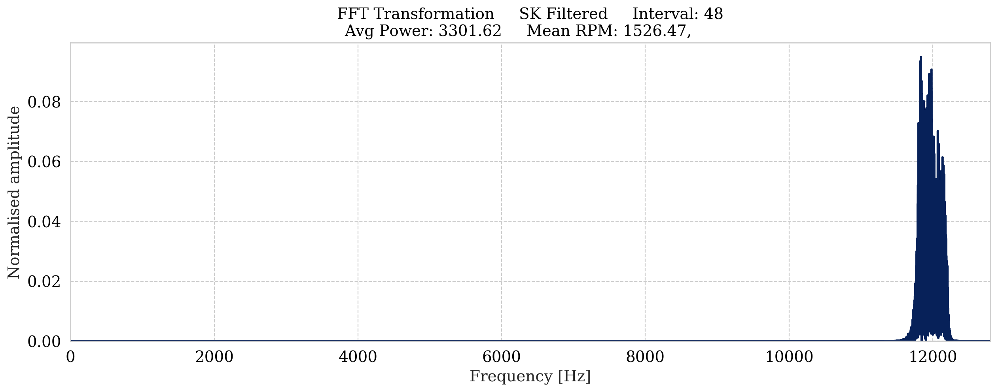

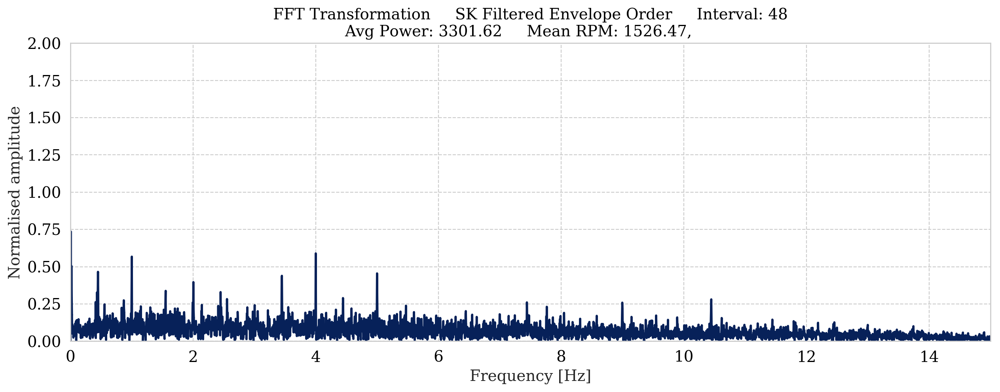

Kurtosis of 48 0.024
Center Frequency: 12000.000
Used Bandwidth in orders: 15.723


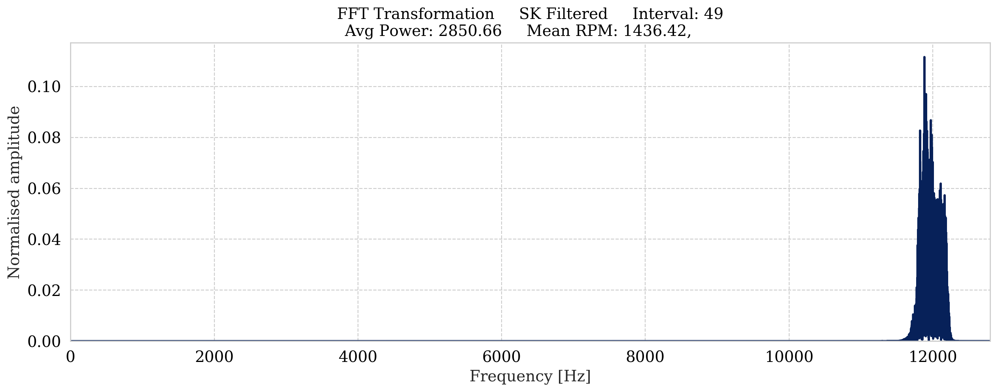

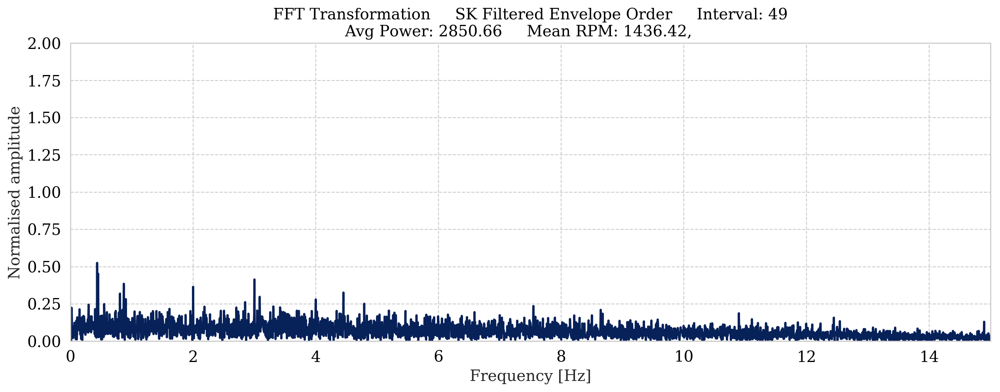

Kurtosis of 49 0.033
Center Frequency: 12000.000
Used Bandwidth in orders: 16.708
------------------------------------------------


               FIRST 50 FINISHED


------------------------------------------------


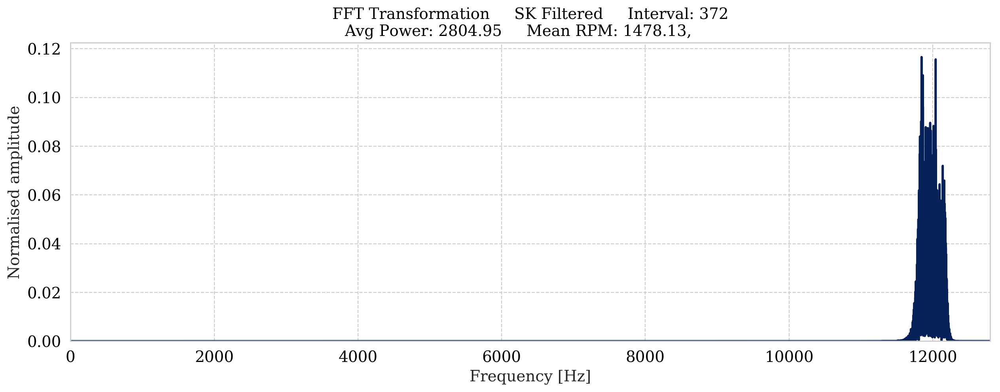

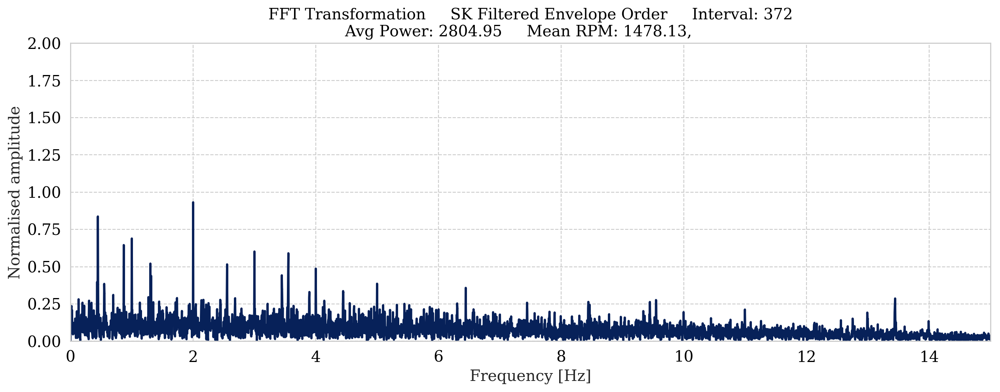

Kurtosis of 372 0.024
Center Frequency: 12000.000
Used Bandwidth in orders: 16.237


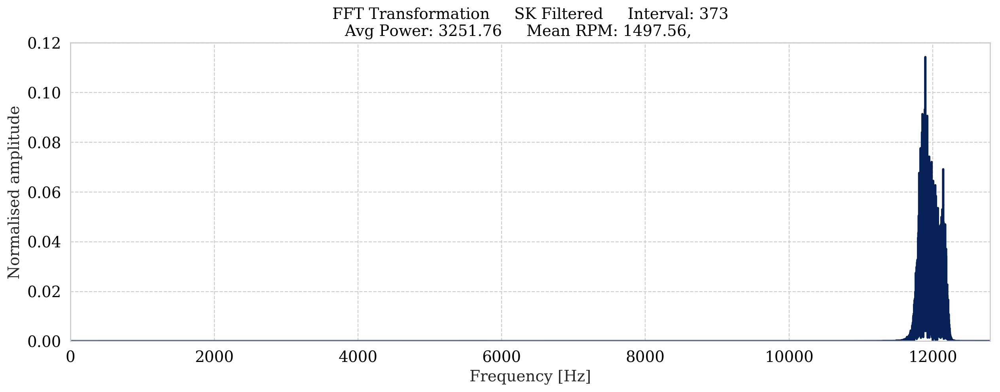

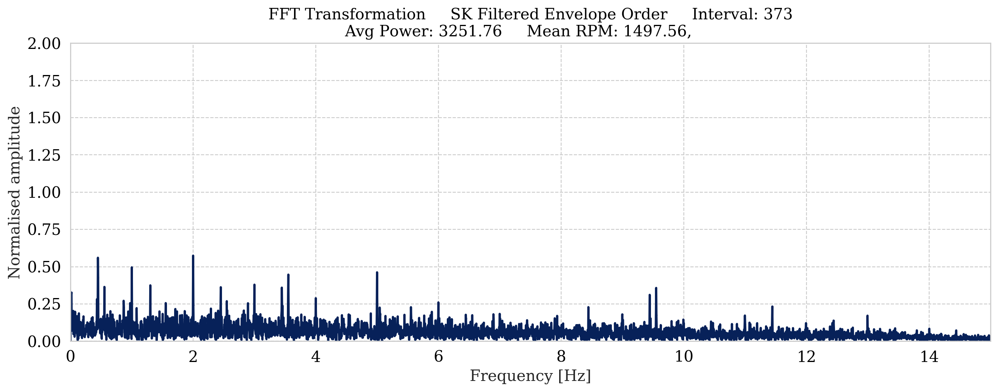

Kurtosis of 373 -0.067
Center Frequency: 12000.000
Used Bandwidth in orders: 16.026


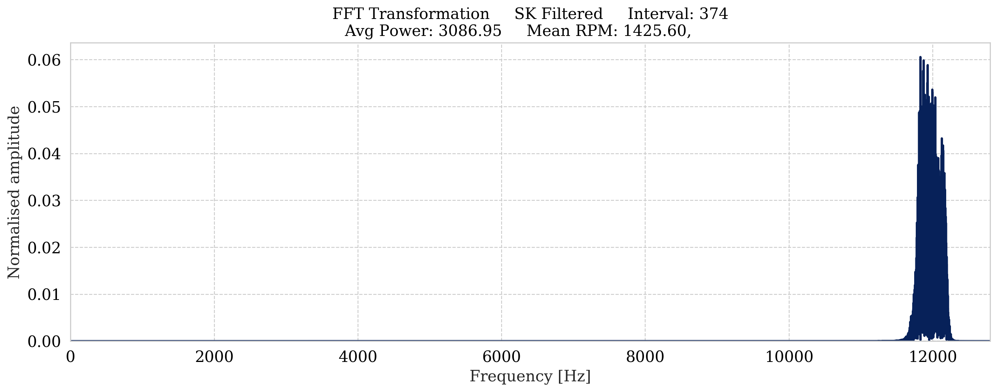

---------------------------------------


              INTERVAL 374
ENVELOPE ORDER COULD NOT BE CALCULATED!


---------------------------------------
Kurtosis of 374 0.053
Center Frequency: 12000.000
Used Bandwidth in orders: 16.835


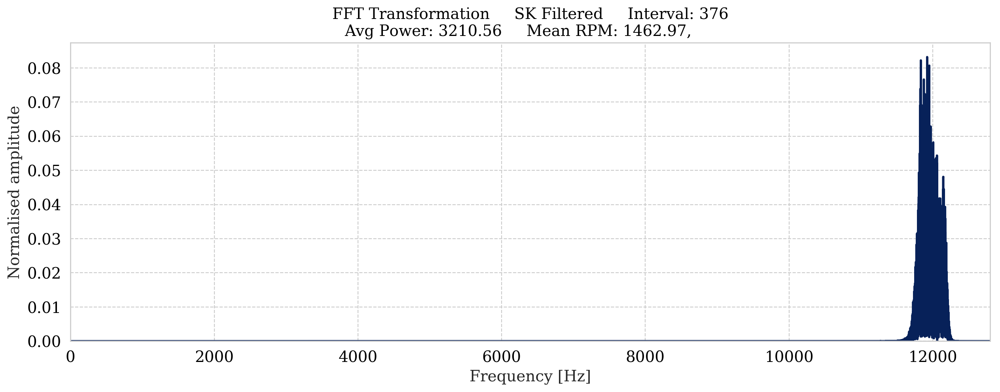

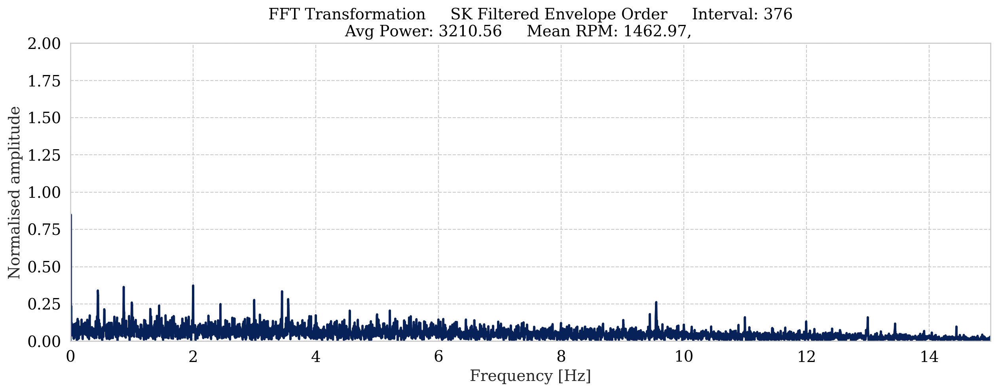

Kurtosis of 376 0.023
Center Frequency: 12000.000
Used Bandwidth in orders: 16.405


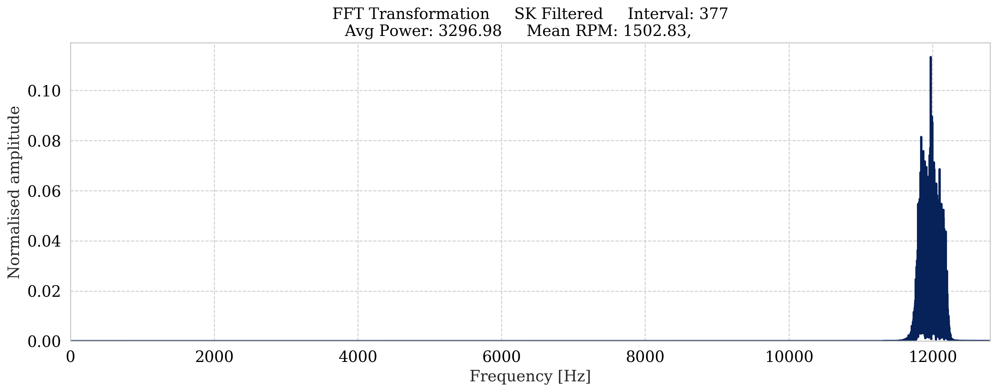

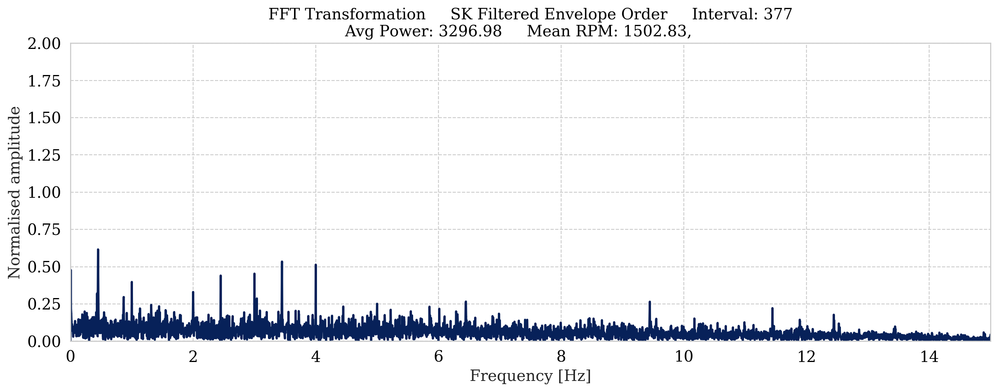

Kurtosis of 377 -0.026
Center Frequency: 12000.000
Used Bandwidth in orders: 15.970


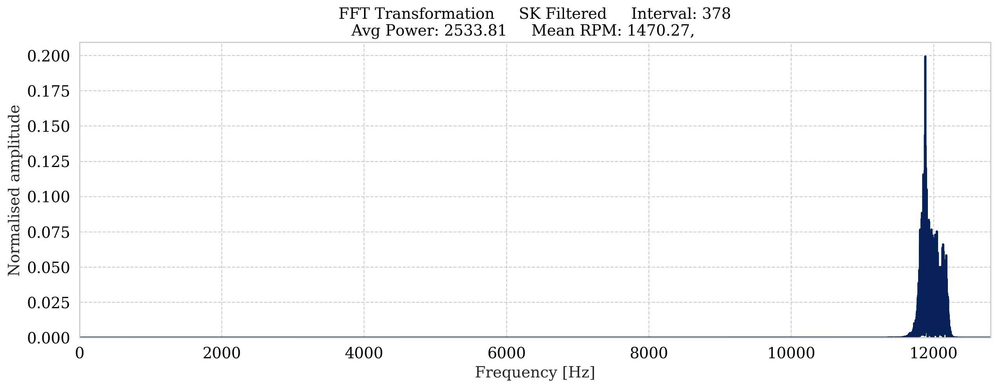

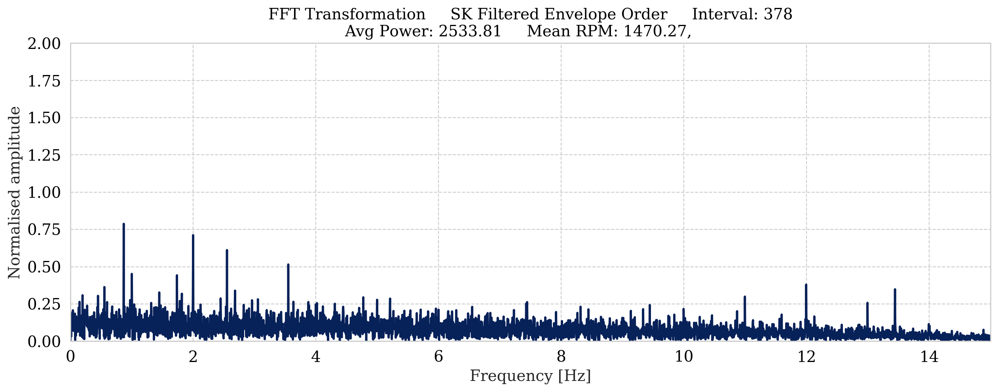

Kurtosis of 378 -0.055
Center Frequency: 12000.000
Used Bandwidth in orders: 16.324


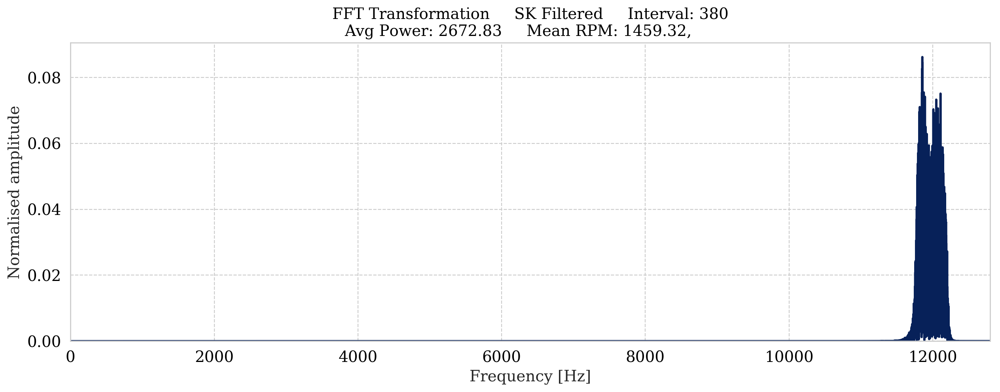

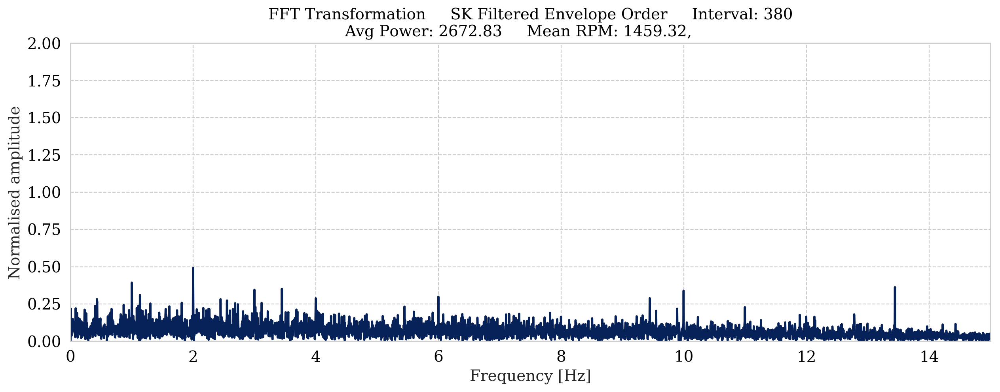

Kurtosis of 380 0.071
Center Frequency: 12000.000
Used Bandwidth in orders: 16.446


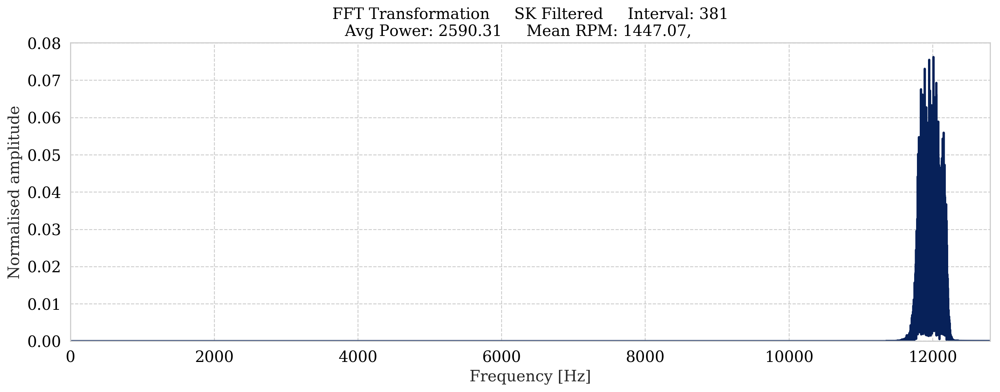

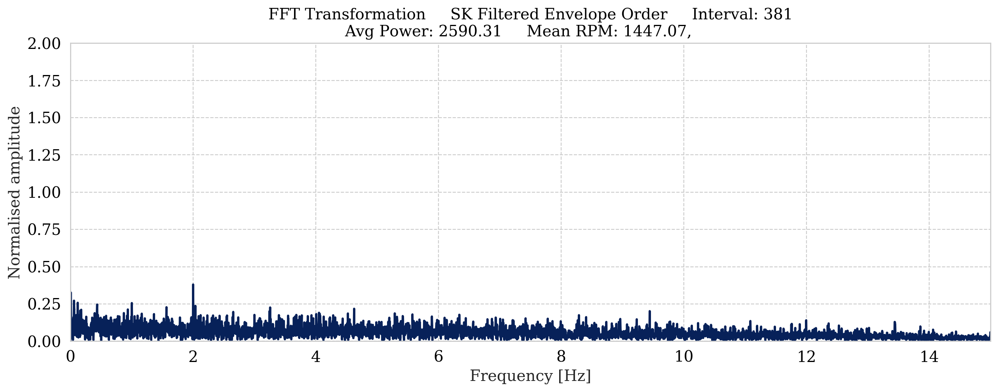

Kurtosis of 381 0.109
Center Frequency: 12000.000
Used Bandwidth in orders: 16.585


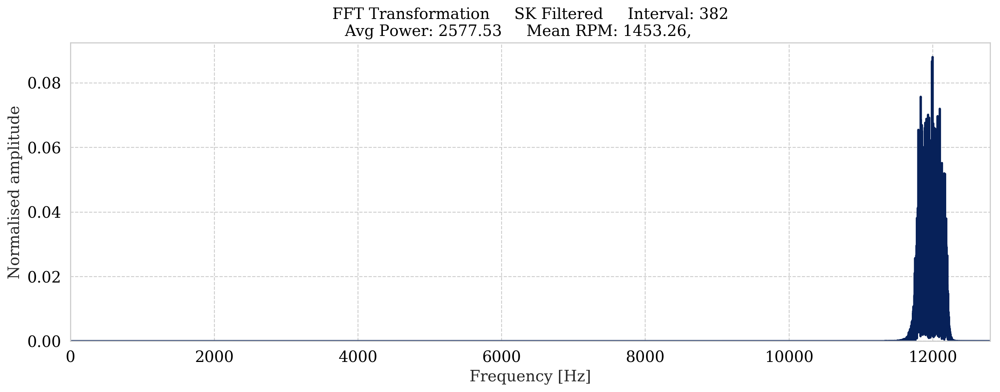

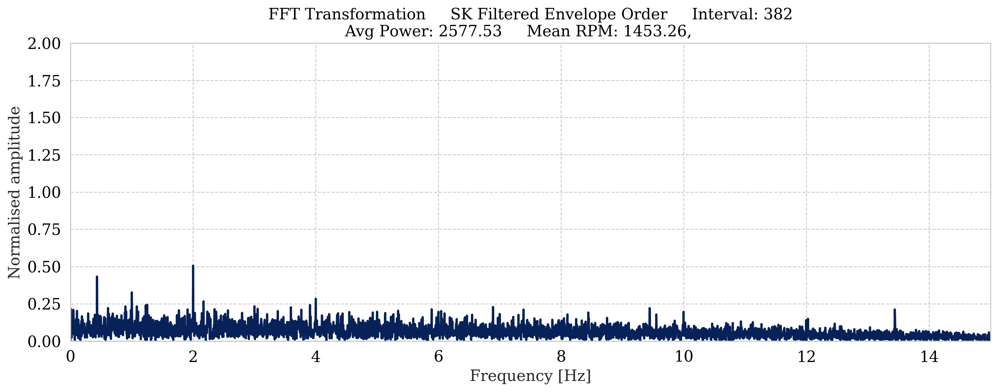

Kurtosis of 382 0.111
Center Frequency: 12000.000
Used Bandwidth in orders: 16.515


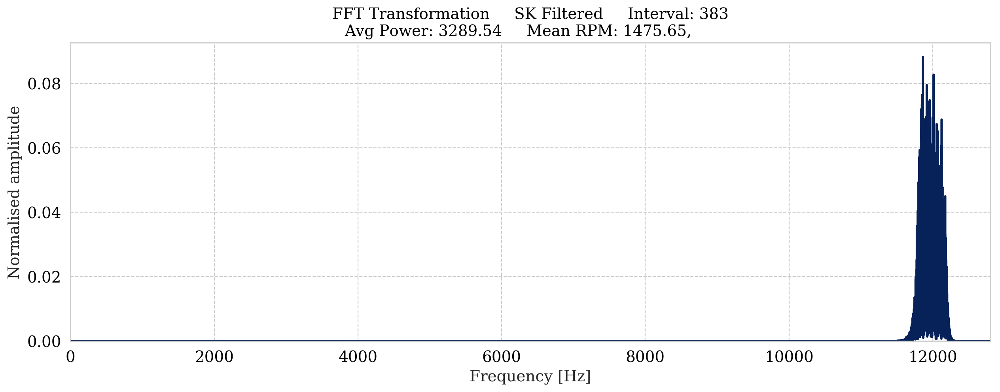

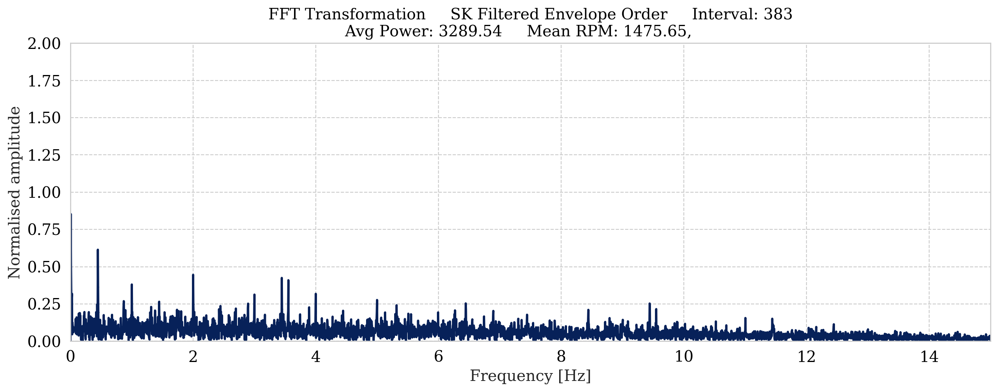

Kurtosis of 383 0.162
Center Frequency: 12000.000
Used Bandwidth in orders: 16.264


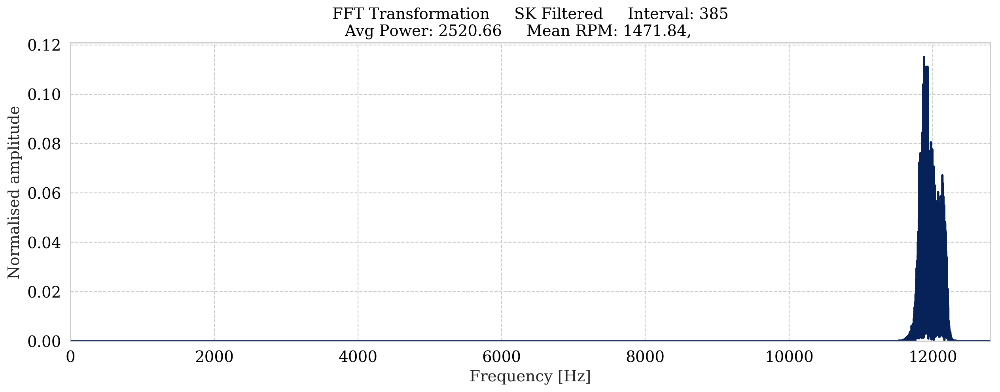

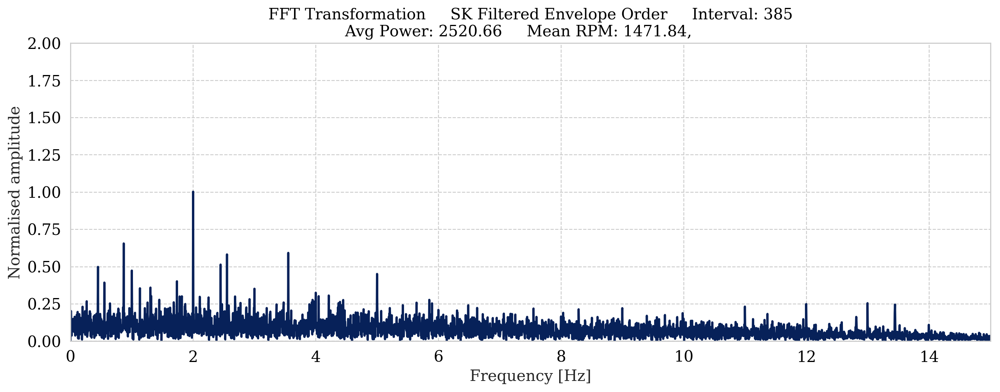

Kurtosis of 385 -0.059
Center Frequency: 12000.000
Used Bandwidth in orders: 16.306


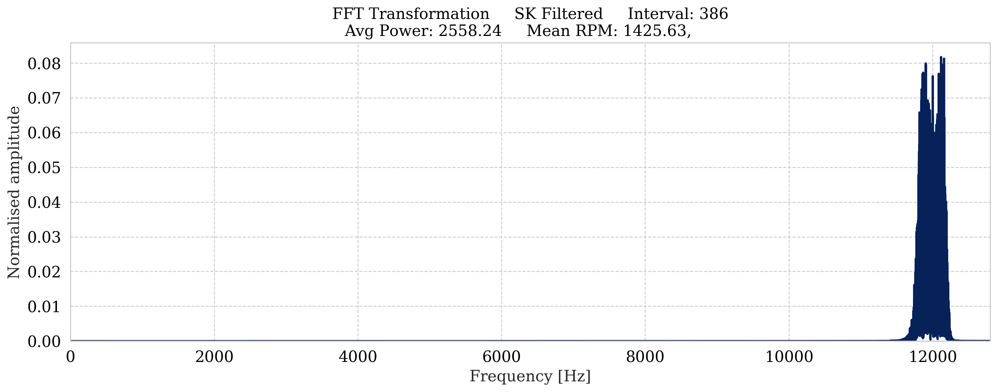

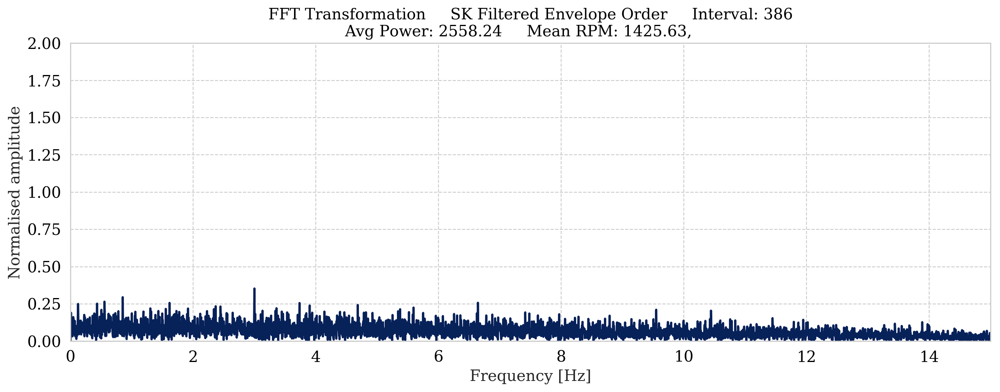

Kurtosis of 386 0.020
Center Frequency: 12000.000
Used Bandwidth in orders: 16.835


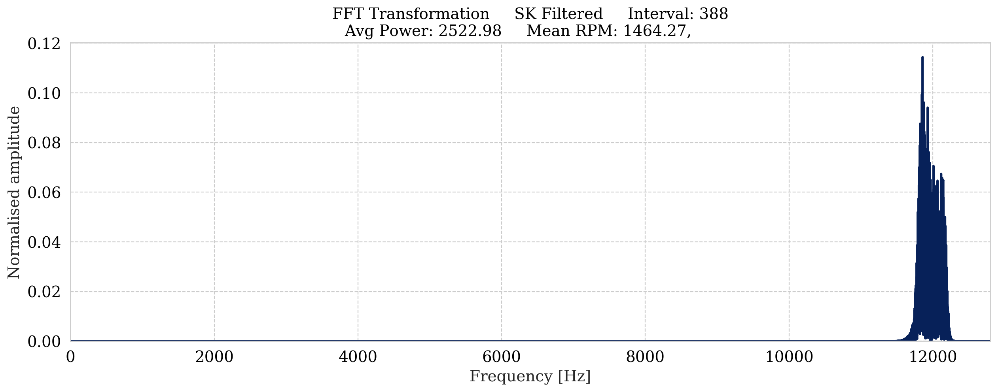

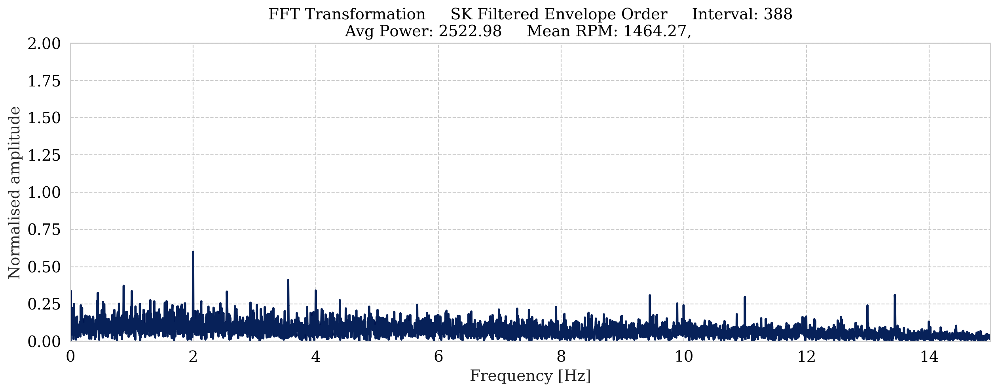

Kurtosis of 388 -0.009
Center Frequency: 12000.000
Used Bandwidth in orders: 16.390


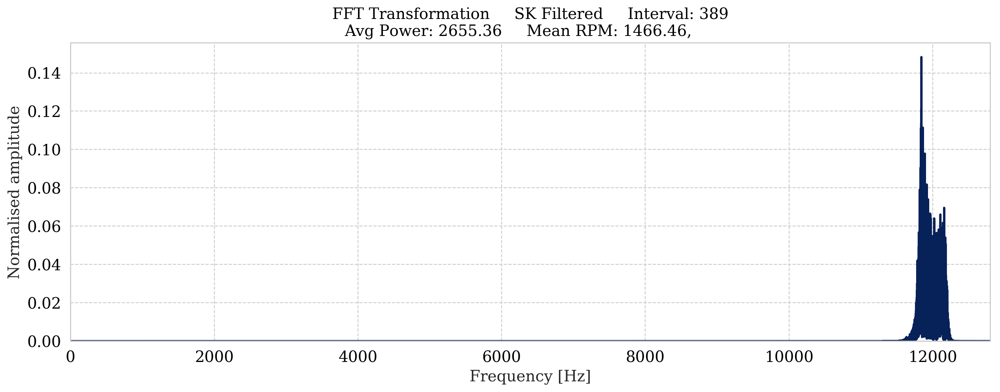

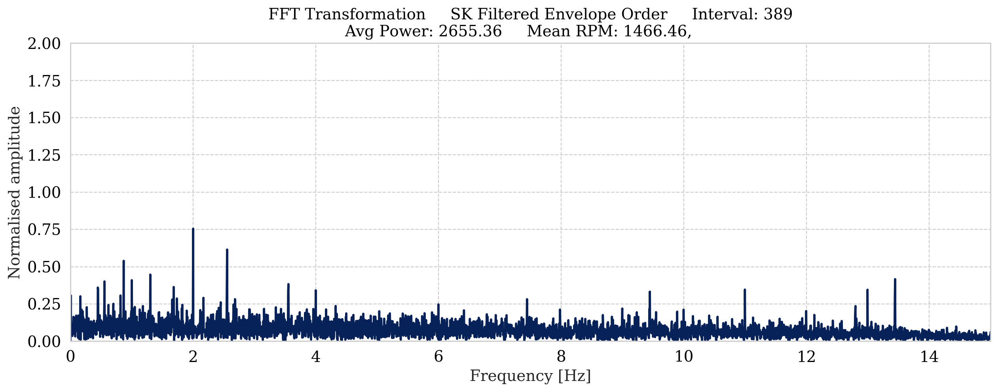

Kurtosis of 389 -0.066
Center Frequency: 12000.000
Used Bandwidth in orders: 16.366


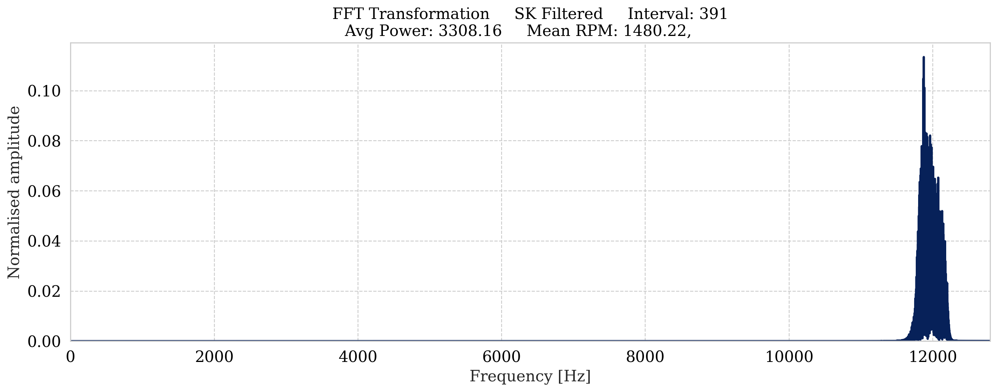

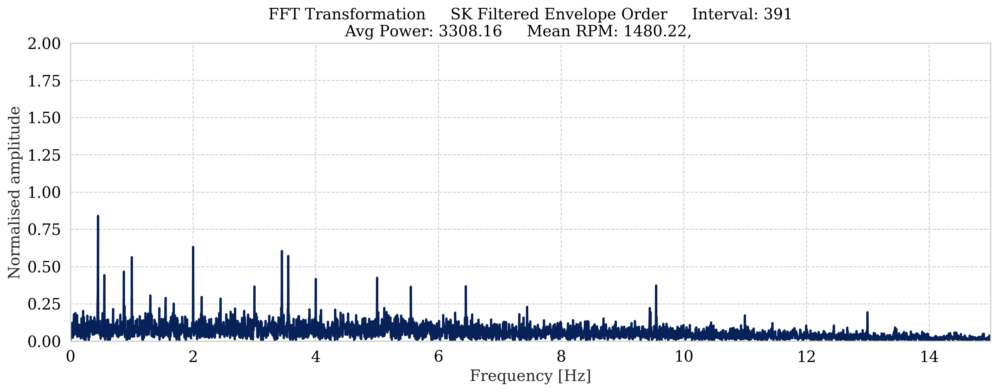

Kurtosis of 391 -0.169
Center Frequency: 12000.000
Used Bandwidth in orders: 16.214


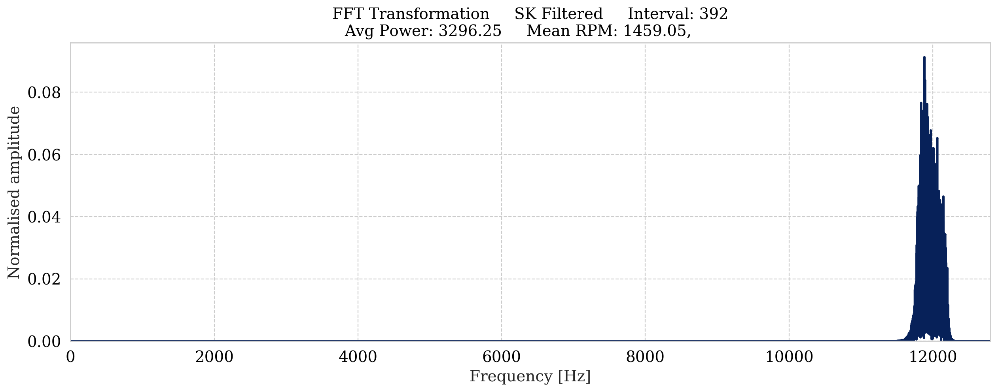

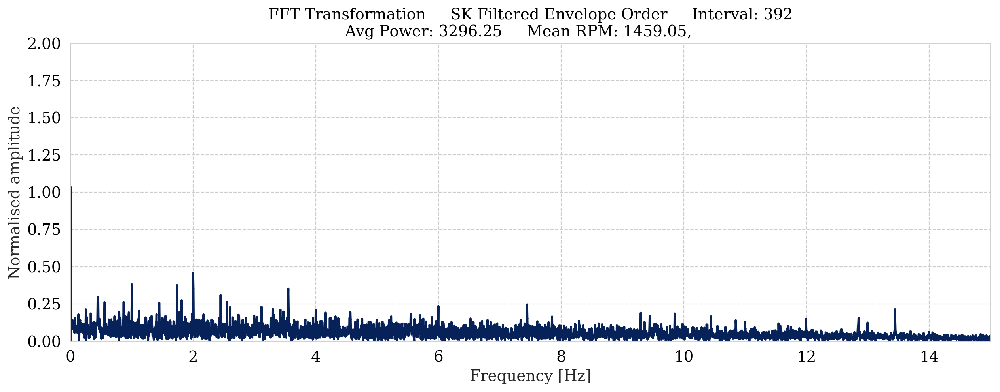

Kurtosis of 392 0.203
Center Frequency: 12000.000
Used Bandwidth in orders: 16.449


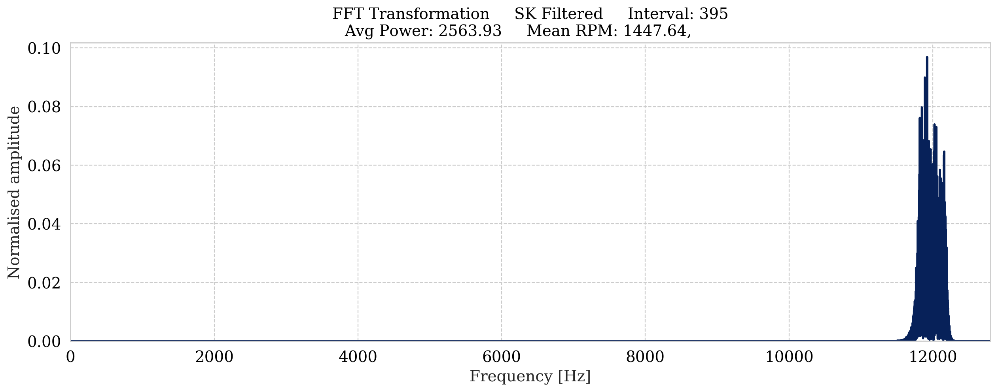

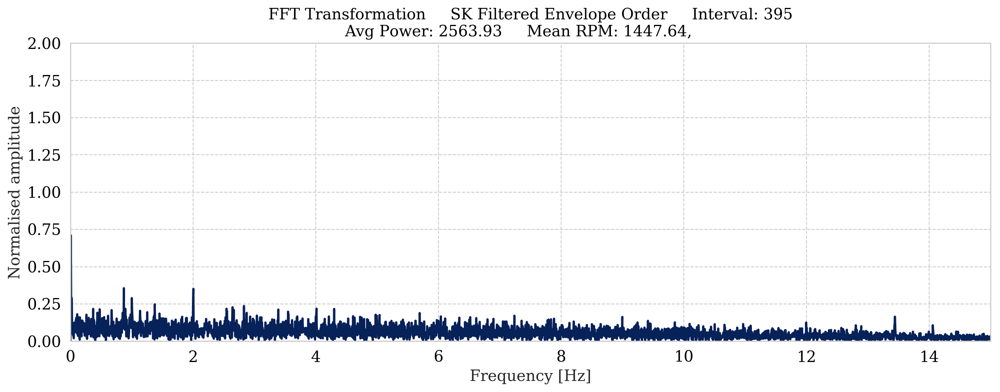

Kurtosis of 395 0.096
Center Frequency: 12000.000
Used Bandwidth in orders: 16.579


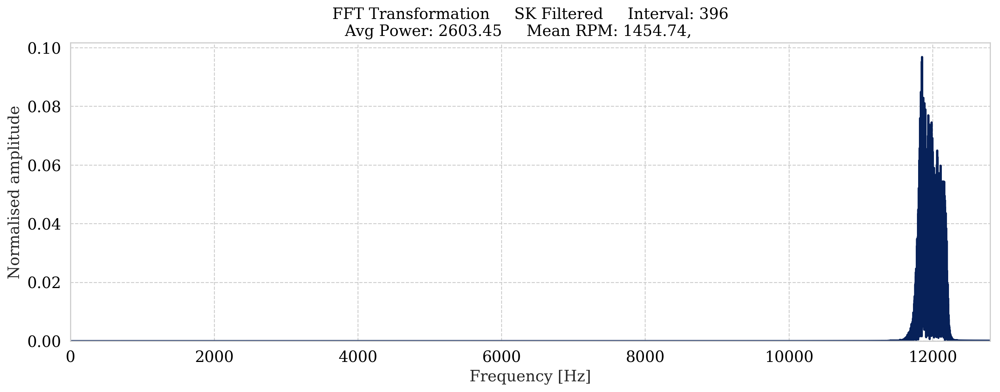

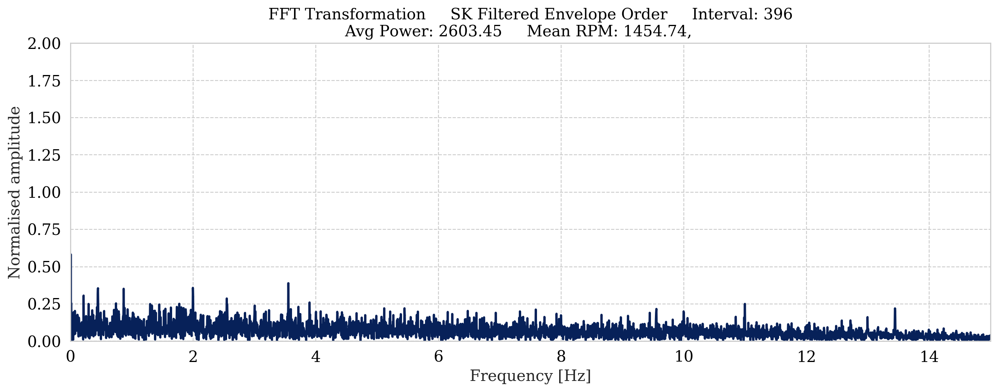

Kurtosis of 396 -0.006
Center Frequency: 12000.000
Used Bandwidth in orders: 16.498


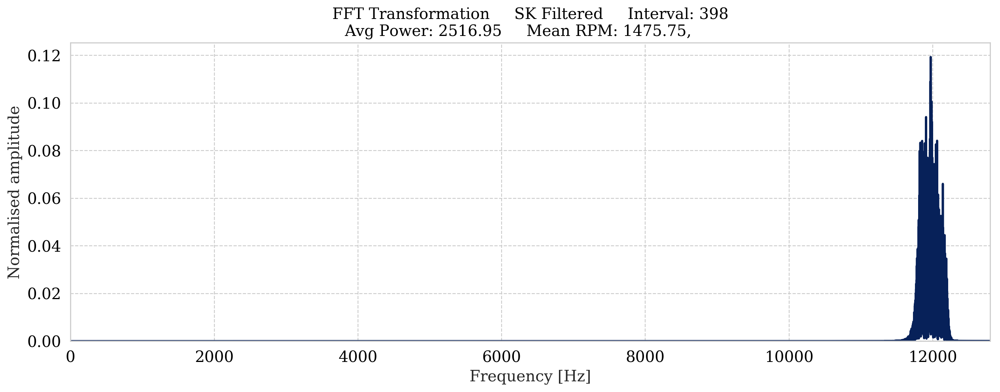

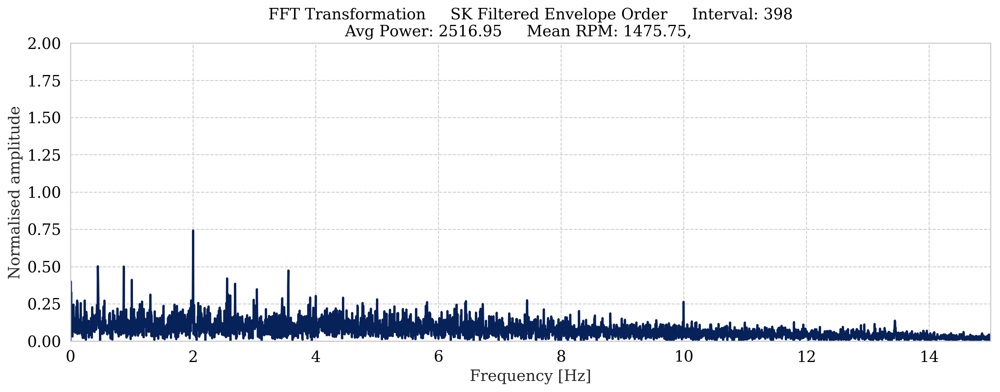

Kurtosis of 398 0.111
Center Frequency: 12000.000
Used Bandwidth in orders: 16.263


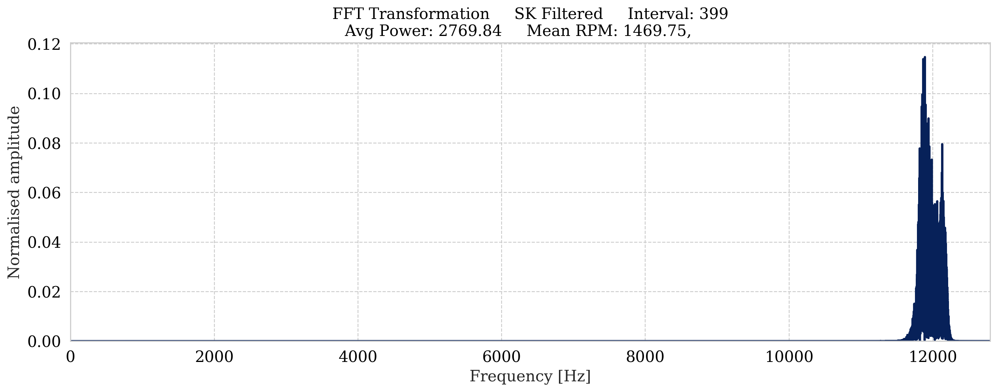

---------------------------------------


              INTERVAL 399
ENVELOPE ORDER COULD NOT BE CALCULATED!


---------------------------------------
Kurtosis of 399 0.012
Center Frequency: 12000.000
Used Bandwidth in orders: 16.329


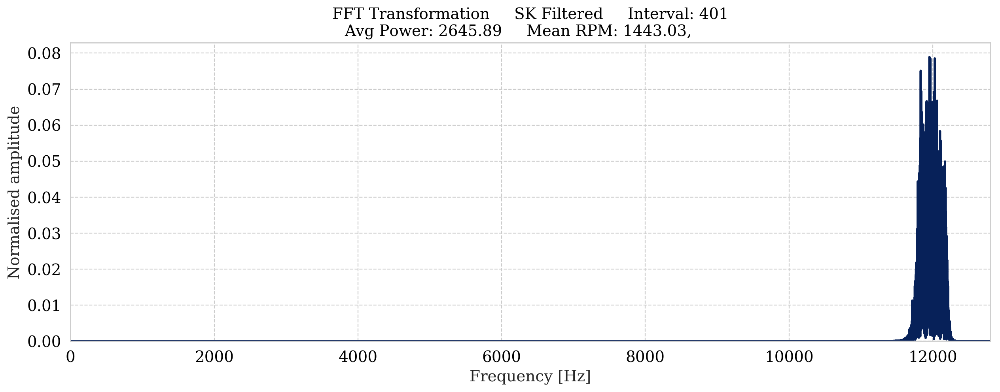

---------------------------------------


              INTERVAL 401
ENVELOPE ORDER COULD NOT BE CALCULATED!


---------------------------------------
Kurtosis of 401 0.001
Center Frequency: 12000.000
Used Bandwidth in orders: 16.632


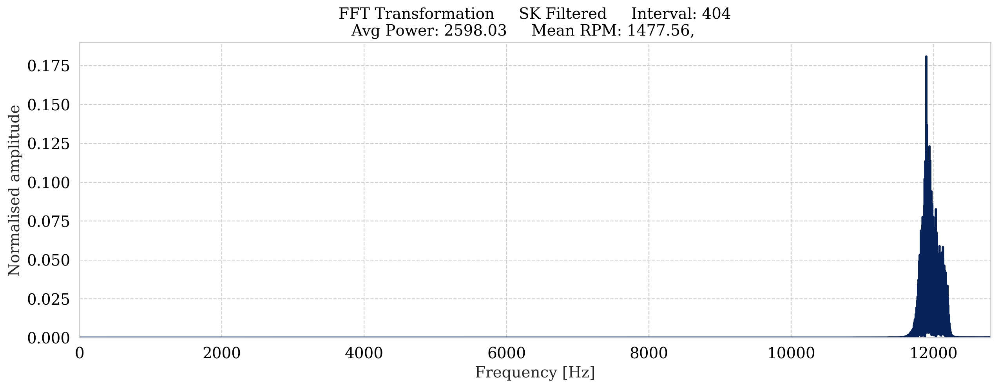

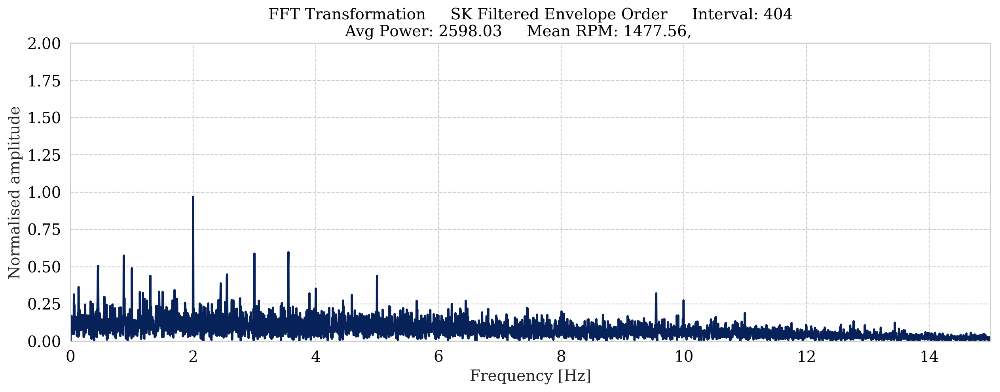

Kurtosis of 404 -0.067
Center Frequency: 12000.000
Used Bandwidth in orders: 16.243


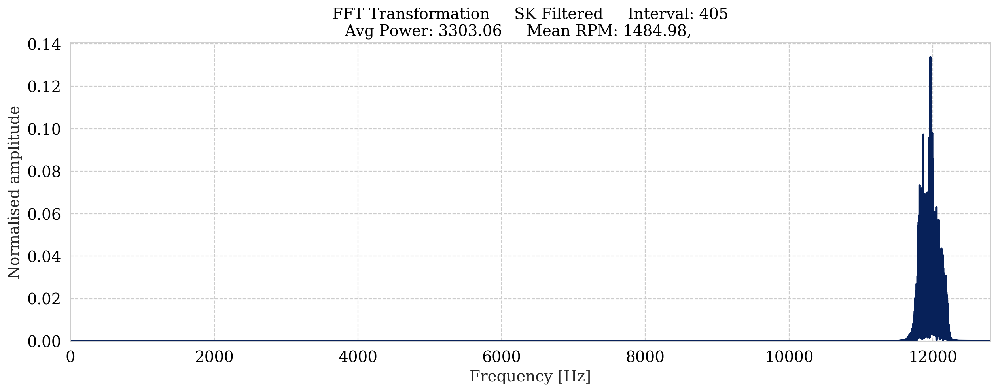

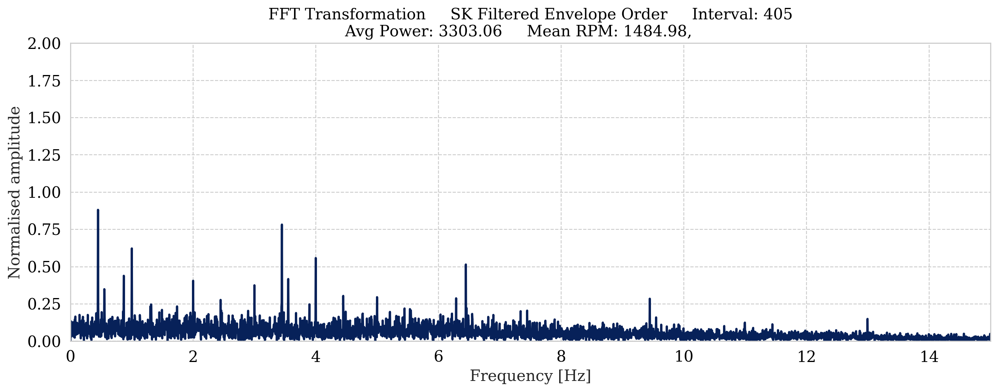

Kurtosis of 405 -0.153
Center Frequency: 12000.000
Used Bandwidth in orders: 16.162


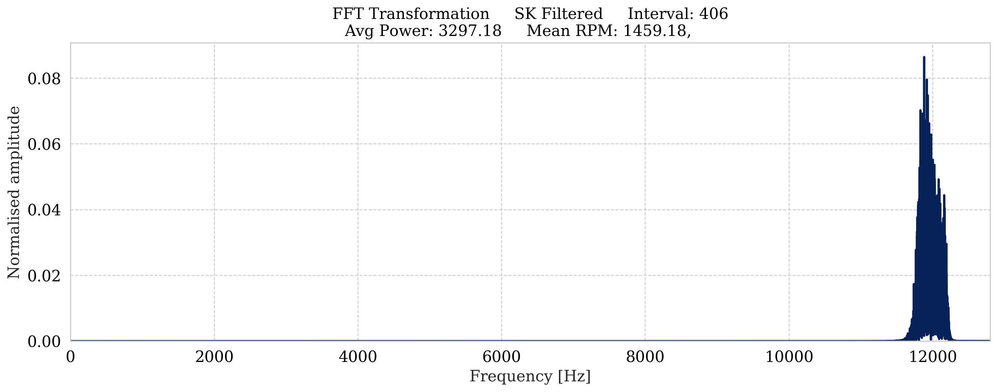

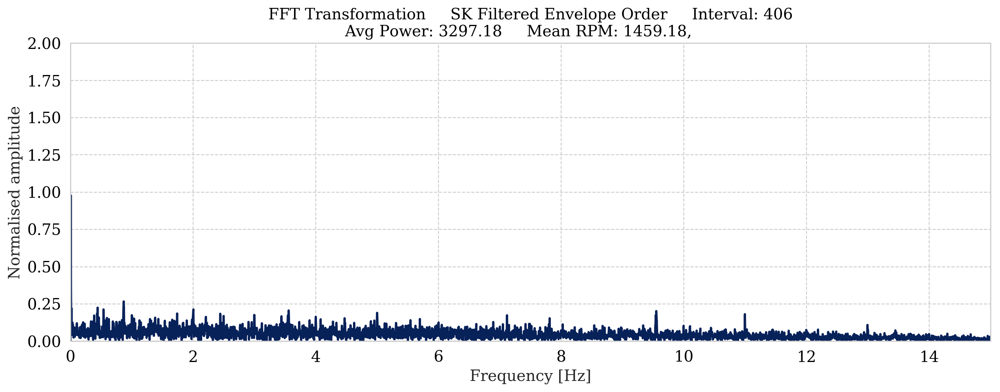

Kurtosis of 406 0.186
Center Frequency: 12000.000
Used Bandwidth in orders: 16.448


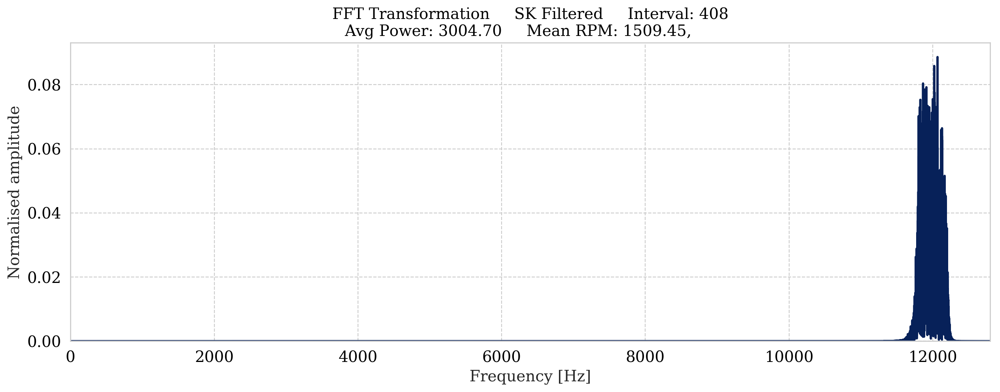

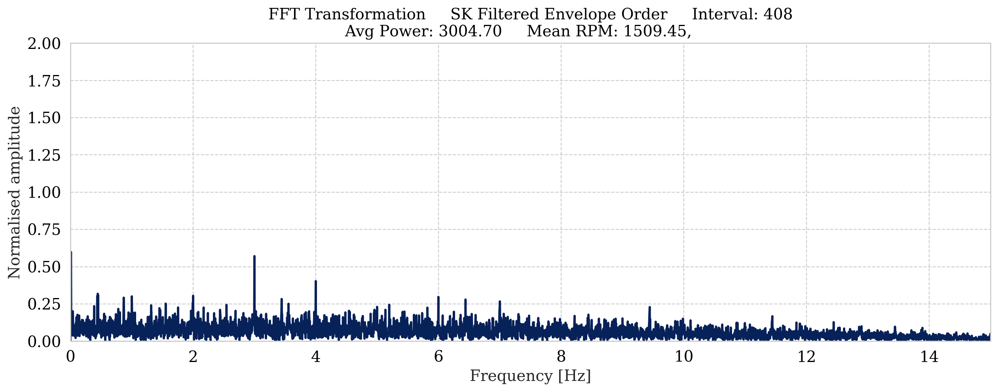

Kurtosis of 408 0.030
Center Frequency: 12000.000
Used Bandwidth in orders: 15.900


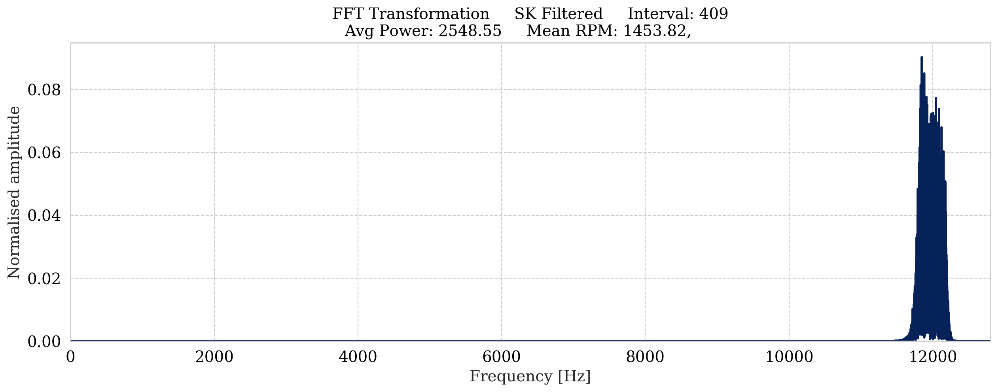

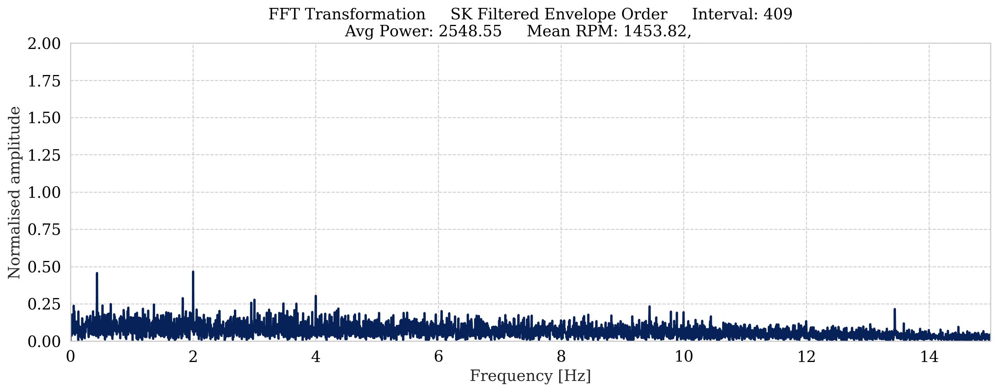

Kurtosis of 409 0.075
Center Frequency: 12000.000
Used Bandwidth in orders: 16.508


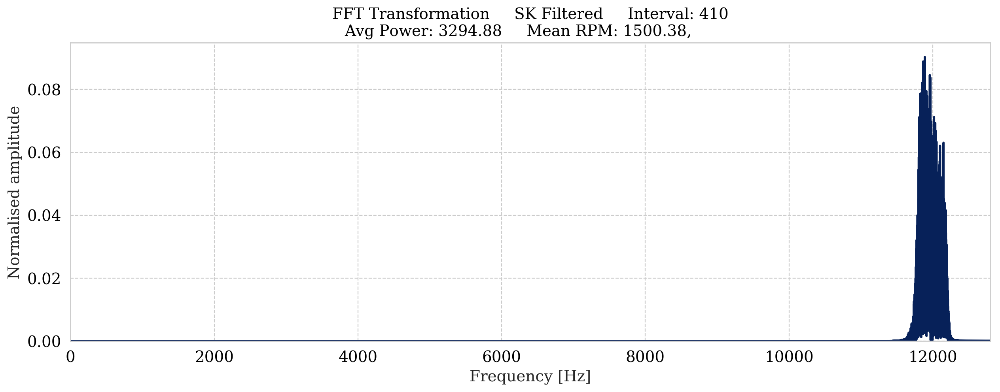

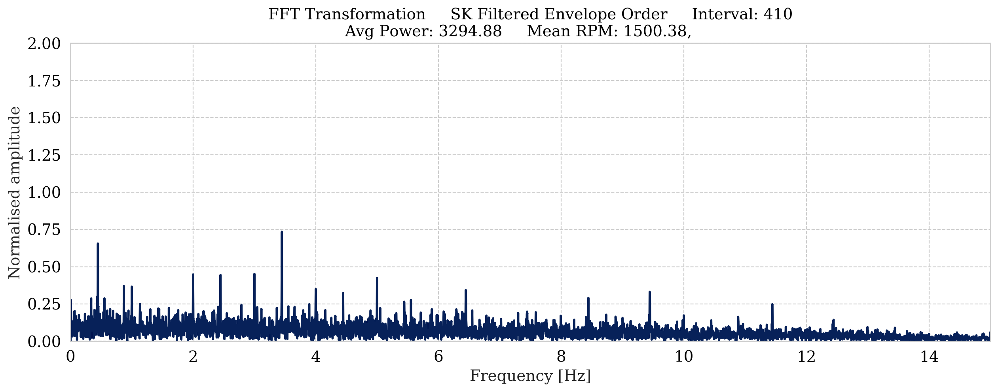

Kurtosis of 410 -0.010
Center Frequency: 12000.000
Used Bandwidth in orders: 15.996


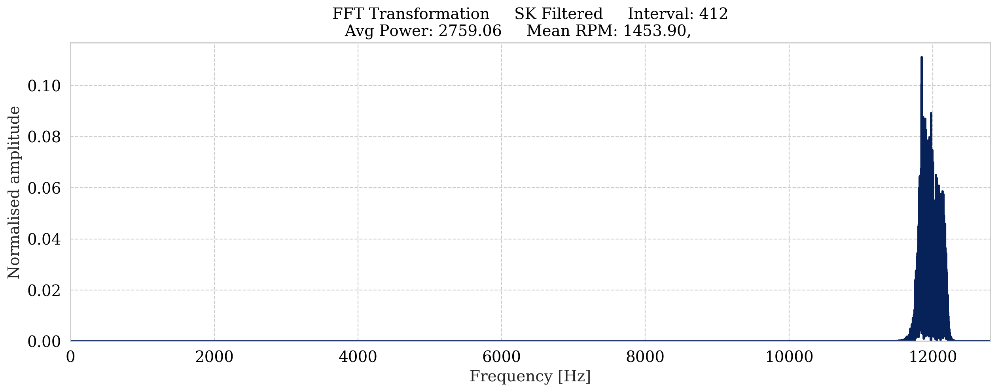

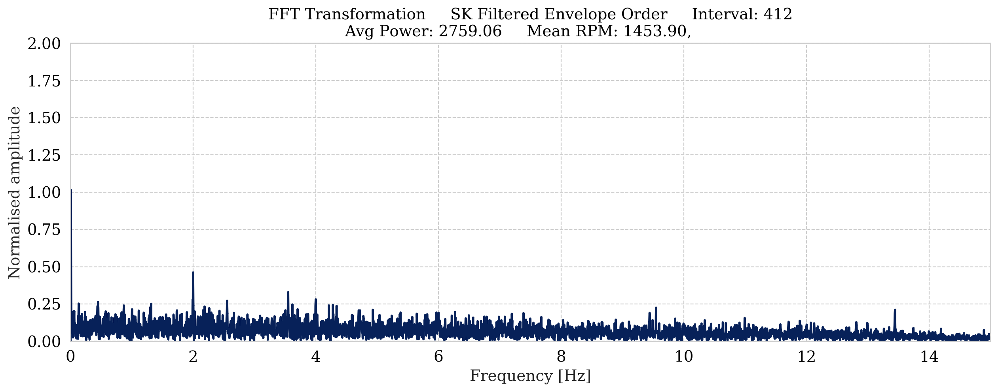

Kurtosis of 412 0.215
Center Frequency: 12000.000
Used Bandwidth in orders: 16.507


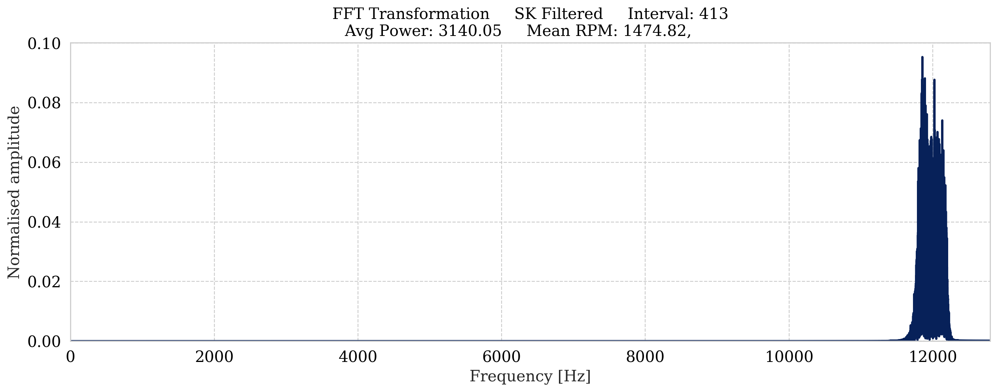

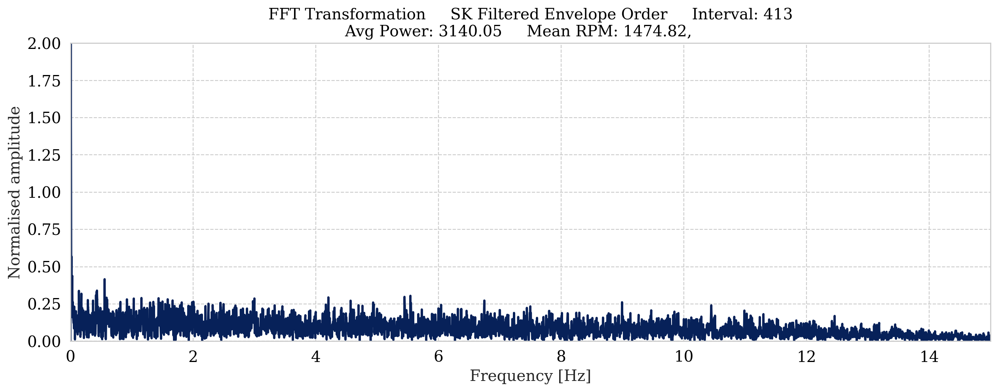

Kurtosis of 413 0.767
Center Frequency: 12000.000
Used Bandwidth in orders: 16.273


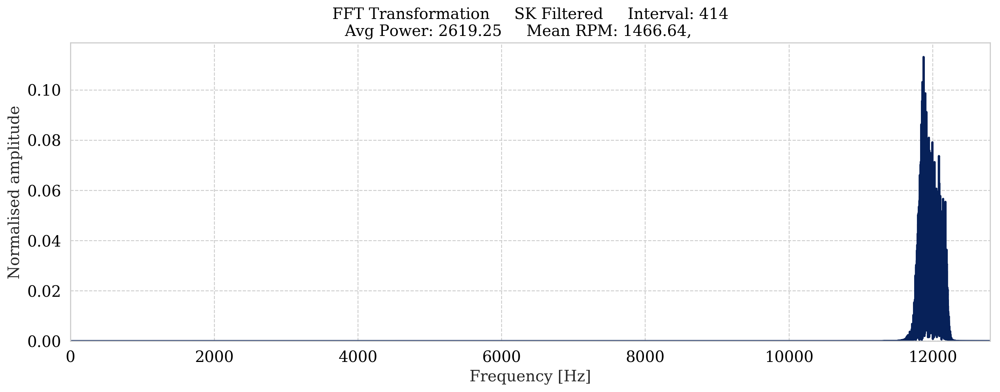

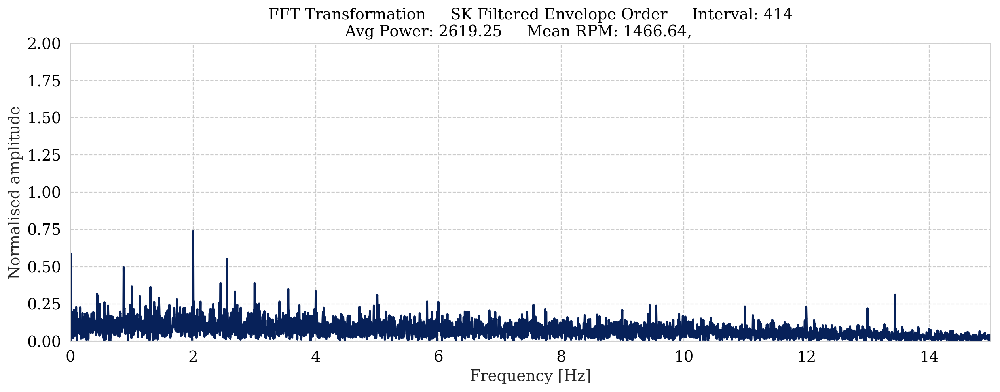

Kurtosis of 414 -0.014
Center Frequency: 12000.000
Used Bandwidth in orders: 16.364


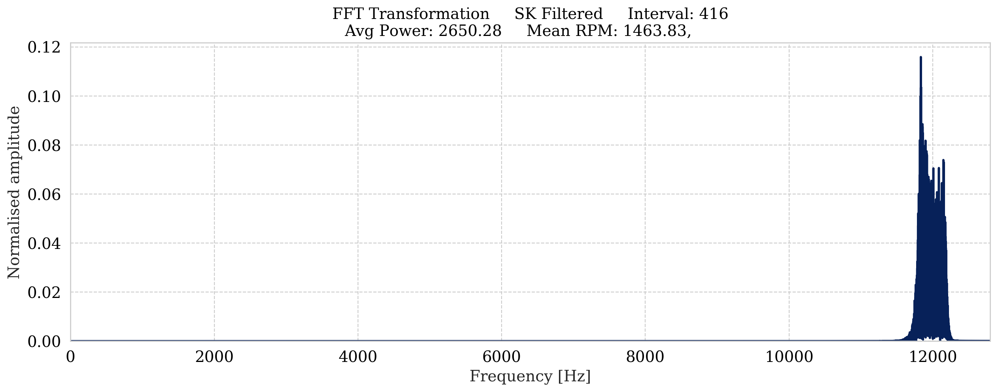

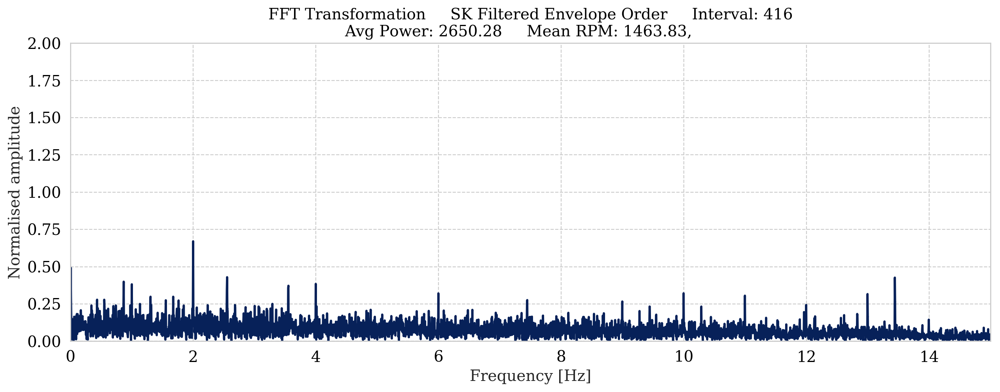

Kurtosis of 416 0.018
Center Frequency: 12000.000
Used Bandwidth in orders: 16.395


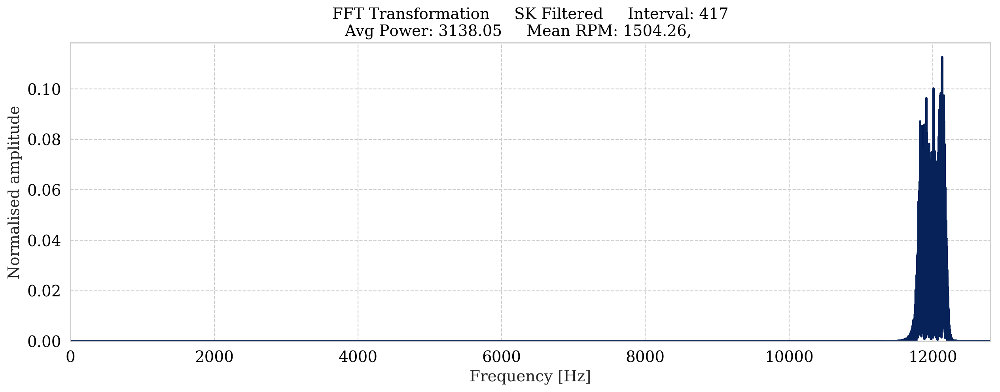

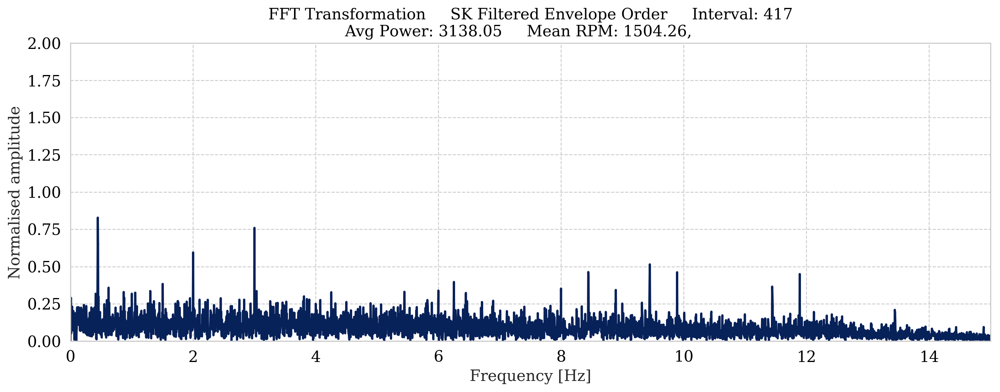

Kurtosis of 417 0.022
Center Frequency: 12000.000
Used Bandwidth in orders: 15.955


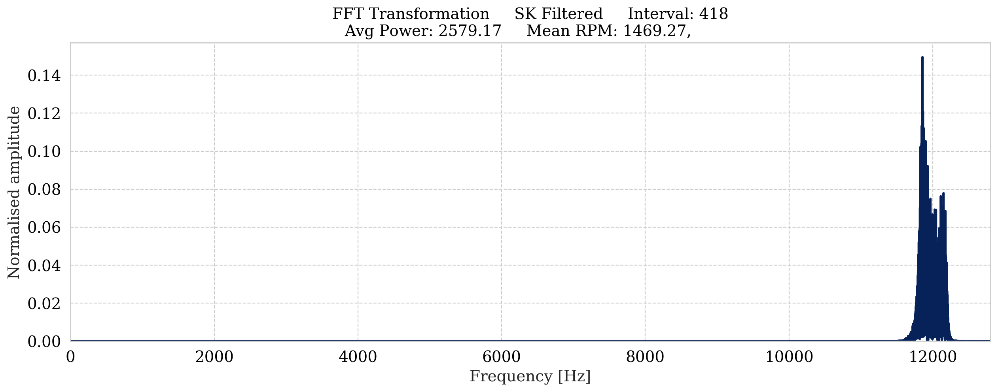

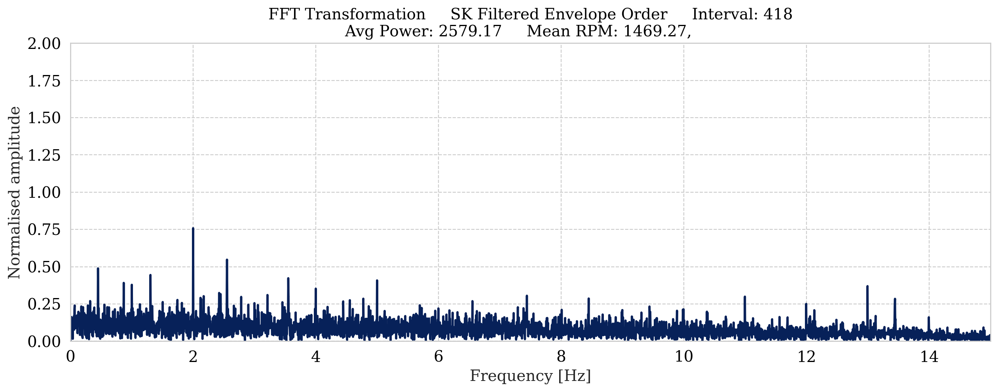

Kurtosis of 418 -0.001
Center Frequency: 12000.000
Used Bandwidth in orders: 16.335


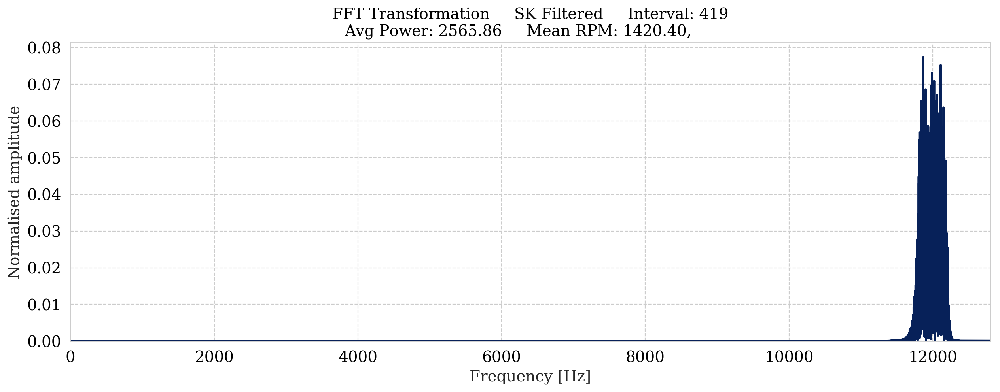

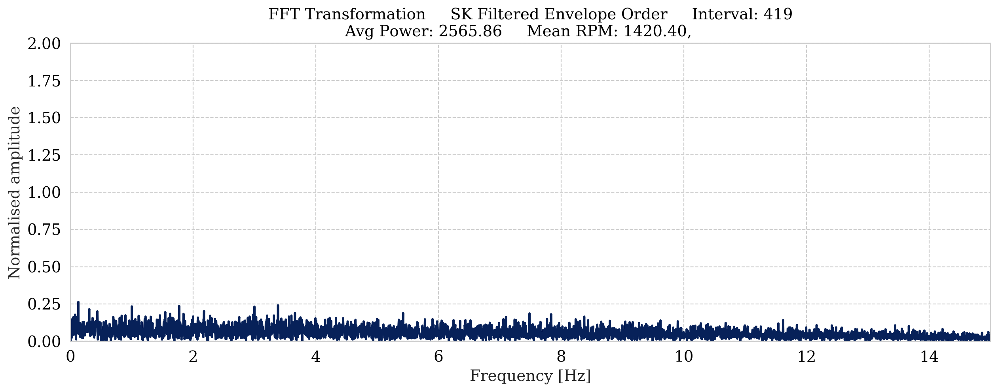

Kurtosis of 419 0.071
Center Frequency: 12000.000
Used Bandwidth in orders: 16.897


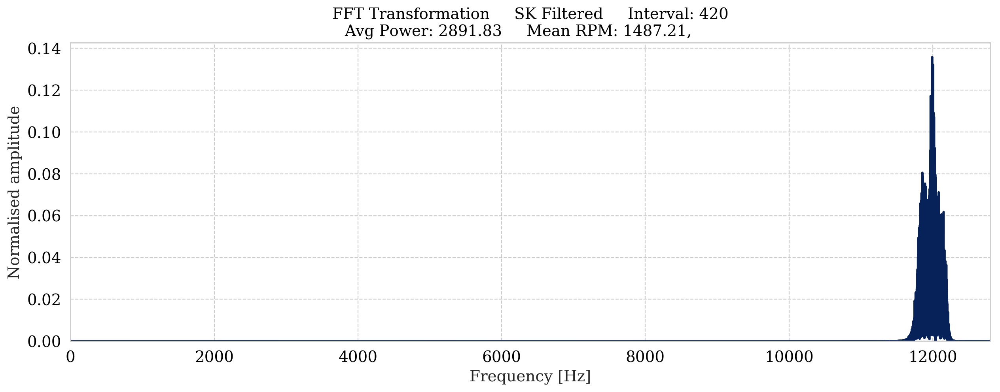

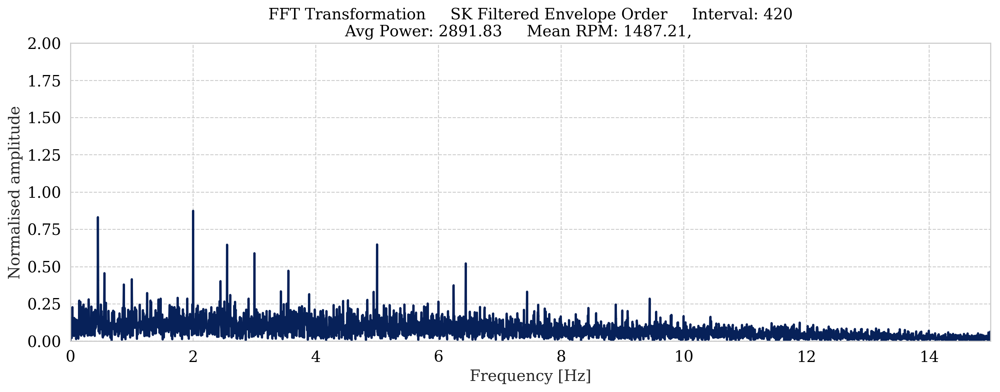

Kurtosis of 420 0.027
Center Frequency: 12000.000
Used Bandwidth in orders: 16.138


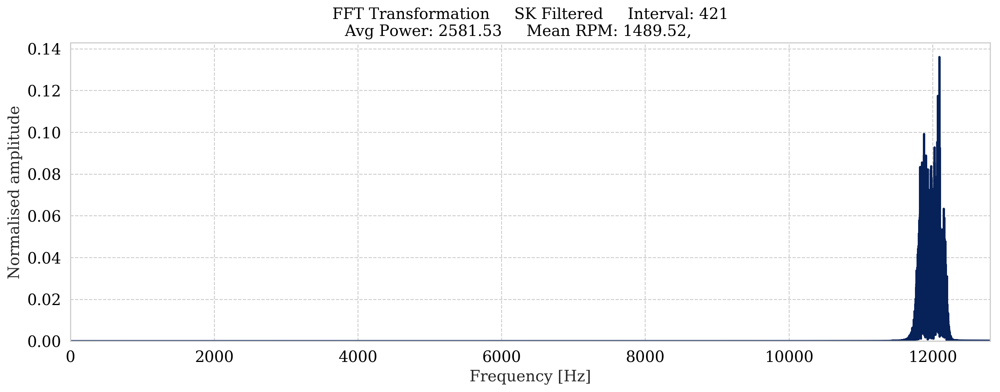

---------------------------------------


              INTERVAL 421
ENVELOPE ORDER COULD NOT BE CALCULATED!


---------------------------------------
Kurtosis of 421 -0.057
Center Frequency: 12000.000
Used Bandwidth in orders: 16.113


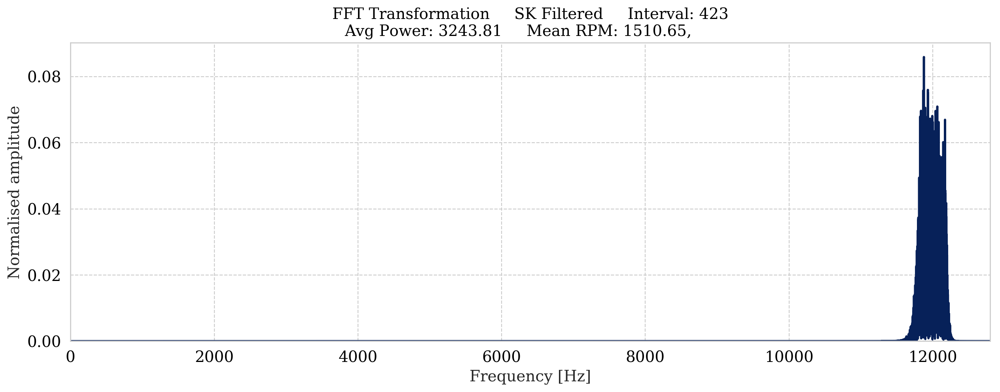

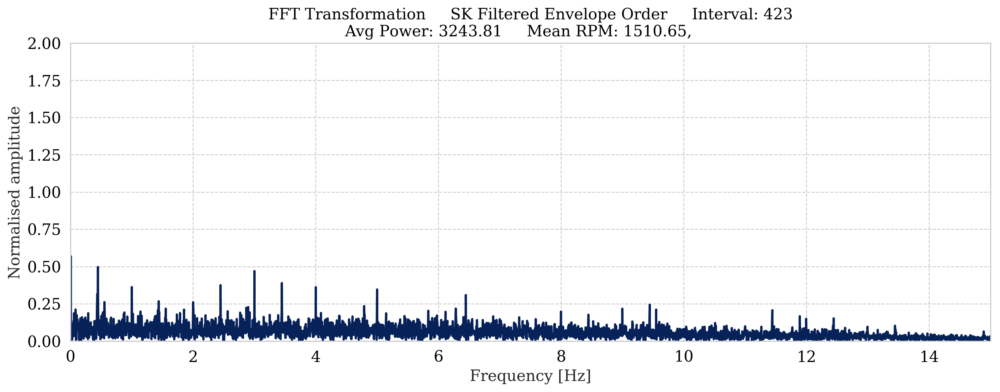

Kurtosis of 423 0.058
Center Frequency: 12000.000
Used Bandwidth in orders: 15.887


In [925]:
interesting_intervals = [31,91,95,147,191,224,231,232,266,284,312,347]
bandpassed_signal = bandpassed_12K
cf =12000

for i, signal in enumerate(bandpassed_signal):
#for i in interesting_intervals:
    if avg_power[i] < 2400:
        continue
    bw = float(concated['Bandwidths'][i])
    if i == 50:
        print('------------------------------------------------\n\n')
        print('               FIRST 50 FINISHED')
        print('\n\n------------------------------------------------')
    if i< 50 or i>370: #bw < 1000 and i<50:# or (i>50 and i<60) or (i > 190 and i < 200)):
        # Plot SK filtered signal
        #plotting_methods.plot_signal(times[i][1:], bandpassed_signal[i],name='SK Filtered', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        plotting_methods.plot_fft(times[i][1:], bandpassed_signal[i], name='SK Filtered', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        
        #Calcutale envelope
        highut_lp = 1000
        rectified = abs(bandpassed_signal[i])**2
        bandpass_filtered_rect_lp = filters.butter_lp_filter(rectified, highut_lp, fs, order=5)
        
        #Plot envelope signal
        one_order = avg_rpm[i]/60
        freq=[one_order]
        #plotting_methods.plot_fft(times[i][1:], bandpass_filtered_rect_lp, x_max=100,frequency_lines=freq,name='SK Filtered Envelope', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        
        #Calculate Envelope Order
        try:
            x_round, resampled_envelope, x_time = resample_signals.do_cubic_resampling(times[i][1:], bandpass_filtered_rect_lp, peak_array[i], number_of_resample_points=2000)
            fft, fft_time = plotting_methods.plot_fft(x_round, resampled_envelope, x_max=15, y_max=2,frequency_lines=[], name='SK Filtered Envelope Order', interval_num=i, avg_power=avg_power[i], avg_rpm=avg_rpm[i])
        except: #If resampling fails for some reason
            print('---------------------------------------\n\n')
            print(f'              INTERVAL {i}')
            print('ENVELOPE ORDER COULD NOT BE CALCULATED!\n\n')
            print('---------------------------------------')
        
        # Print key values
        print(f'Kurtosis of {i} {kurtosis(bandpassed_signal[i]):.3f}')
        print(f'Center Frequency: {cf:.3f}')
        print(f'Used Bandwidth in orders: {400*60/avg_rpm[i]:.3f}')
